# Cellpose - Deep Learning

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
bigframes 2.12.0 requires google-cloud-bigquery-storage<3.0.0,>=2.30.0, which is not installed.
mkl-umath 0.1.1 requires numpy<1.27.0,>=1.26.4, but you have numpy 2.2.6 which is incompatible.
mkl-random 1.2.4 requires numpy<1.27.0,>=1.26.4, but you have numpy 2.2.6 which is incompatible.
mkl-fft 1.3.8 requires numpy<1.27.0,>=1.26.4, but you have numpy 2.2.6 which is incompatible.
numba 0.60.0 requires numpy<2.1,>=1.22, but you have numpy 2.2.6 which is incompatible.
datasets 4.4.1 requires pyarrow>=21.0.0, but you have pyarrow 19.0.1 which is incompatible.
ydata-profiling 4.17.0 requires matplotlib<=3.10,>=3.5, but you have matplotlib 3.10.8 which is incompatible.
ydata-profiling 4.17.0 requires numpy<2.2,>=1.16.0, but you have numpy 2.2.6 which is incompatible.
category-encoders 2.7.0 requires scikit-learn<1.6.0,

Valores: min=2944, max=65535
Carregando modelo Cellpose v4+...
Modelo carregado com sucesso.
Executando segmentação...
Objetos detectados (bruto): 669
Diâmetro médio estimado: 15.8 pixels
Diâmetro médio em µm: 0.32 µm


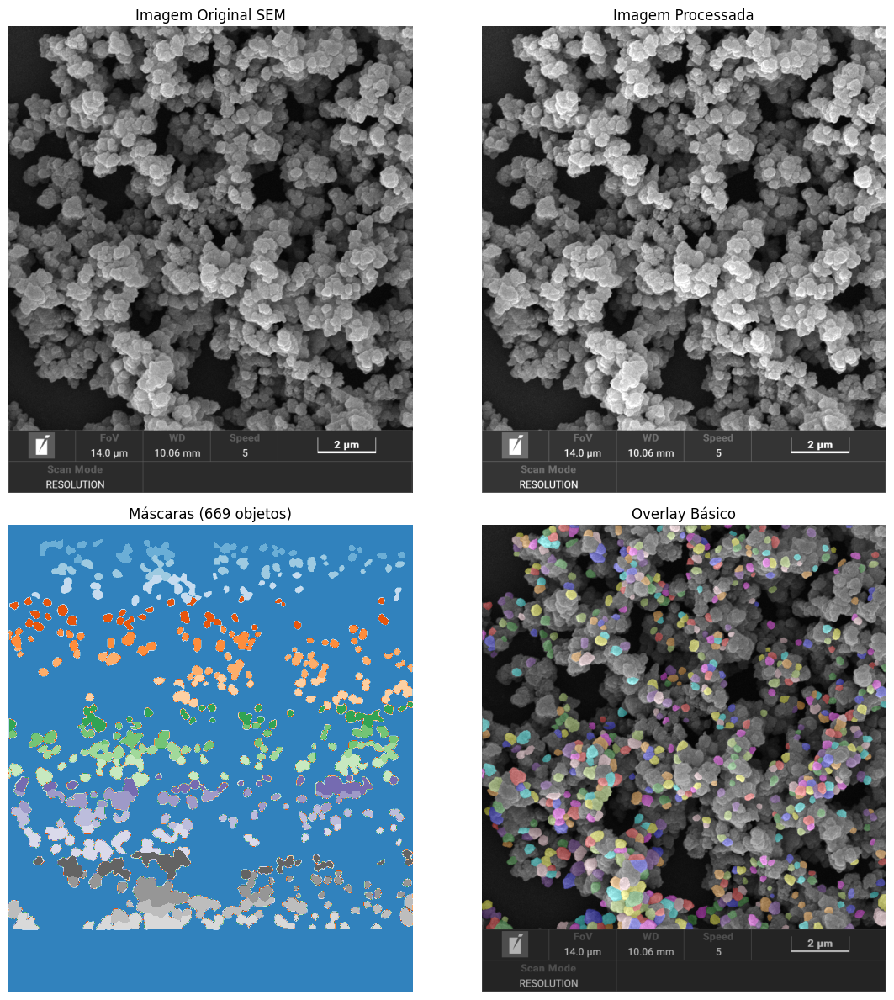


Antes da filtragem: 669 objetos
Depois da filtragem: 669 objetos
Máscara filtrada criada com 669 objetos


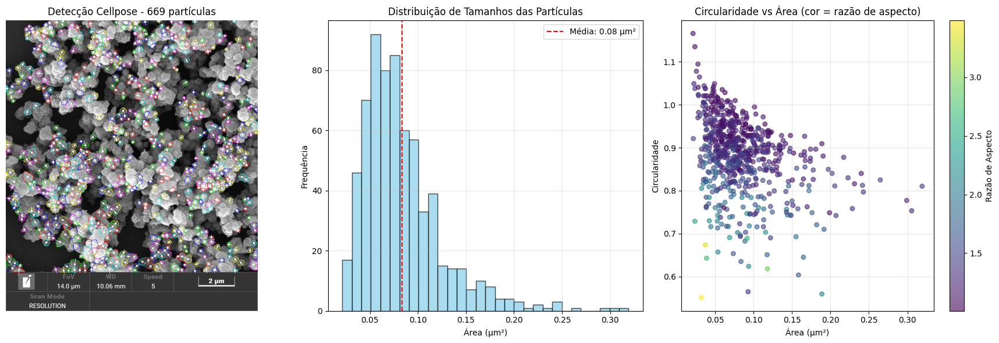


ESTATÍSTICAS DETALHADAS DAS PARTÍCULAS
Total de partículas: 669
Área média: 0.083 ± 0.042 µm²
Diâmetro médio: 0.317 ± 0.075 µm
Circularidade média: 0.883 ± 0.085
Razão de aspecto média: 1.387 ± 0.287
Excentricidade média: 0.638 ± 0.149
Área total coberta: 55.69 µm²
Fator de forma mínimo: 0.551
Fator de forma máximo: 1.166

------------------------------------------------------------
RESUMO POR FAIXA DE TAMANHO:
------------------------------------------------------------
<0.1 µm²: 503 partículas (75.2%)
0.1-0.5 µm²: 166 partículas (24.8%)
0.5-1.0 µm²: 0 partículas (0.0%)
1.0-2.0 µm²: 0 partículas (0.0%)
2.0-5.0 µm²: 0 partículas (0.0%)
5.0-10.0 µm²: 0 partículas (0.0%)

RESULTADOS SALVOS COM SUCESSO:
  • cellpose_mev_overlay.png - Imagem com detecções
  • cellpose_mev_masks.npy - Máscaras filtradas (NumPy array)
  • cellpose_mev_masks_raw.npy - Máscaras brutas (NumPy array)
  • cellpose_mev_medidas_detalhadas.csv - Todas as métricas das partículas
  • cellpose_mev_resumo.csv - Estatís

In [89]:
# =========================================================
# 🔹 CELLPOSE PIPELINE COMPLETO PARA IMAGENS SEM/MEV (v4.2+)
# =========================================================

# --------- installs (Kaggle-friendly) ----------
!pip install -q cellpose opencv-python scikit-image pandas matplotlib torch torchvision

# --------- imports ----------
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from cellpose import models
from skimage.measure import regionprops, regionprops_table, find_contours
from skimage.color import label2rgb
import warnings
warnings.filterwarnings('ignore')

# --------- CONFIGURAÇÃO DO USUÁRIO ----------
IMAGE_PATH = "/kaggle/input/mevdataset/23-12-15/amostra 2-2.tif"
MICRONS_PER_PIXEL = 0.02  # Ajuste conforme calibração do seu SEM
OUTPUT_PREFIX = "cellpose_mev"
MIN_AREA_UM2 = 0.02       # Área mínima em µm²
MAX_AREA_UM2 = 10.0       # Área máxima em µm²

# --------- carregar imagem ----------
img = cv2.imread(IMAGE_PATH, cv2.IMREAD_UNCHANGED)
if img is None:
    raise FileNotFoundError("Imagem não encontrada")

print(f"Dimensões da imagem: {img.shape}")
print(f"Tipo de dados: {img.dtype}")
print(f"Valores: min={img.min()}, max={img.max()}")

# Converter para escala de cinza se necessário
if img.ndim == 3:
    if img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    elif img.shape[2] == 4:
        img = cv2.cvtColor(img, cv2.COLOR_BGRA2GRAY)
    else:
        img = img[:,:,0]  # pega primeiro canal

# Normalização para 0-1
img = img.astype(np.float32)
img_norm = (img - img.min()) / (img.max() - img.min() + 1e-8)

# --------- AJUSTE PARA IMAGENS SEM ----------
# Imagens SEM geralmente têm fundo escuro e partículas claras
# Inverter se necessário
if np.mean(img_norm) > 0.5:  # Se a maioria dos pixels forem claros
    print("Invertendo imagem (fundo escuro -> claro)")
    img_norm = 1 - img_norm

# Melhorar contraste
img_norm = np.clip(img_norm * 1.2, 0, 1)  # Aumentar contraste

# --------- CELLPOSE MODEL (v4.2+) ----------
print("Carregando modelo Cellpose v4+...")
model = models.CellposeModel(
    gpu=True,
    model_type="cyto3"  # Para v4.2+, use 'cyto3' em vez de 'cyto'
)
print("Modelo carregado com sucesso.")

# --------- INFERÊNCIA ----------
print("Executando segmentação...")
masks, flows, styles = model.eval(  # v4 retorna apenas 3 valores
    img_norm,
    diameter=None,           # Deixe o modelo estimar
    flow_threshold=0.4,
    cellprob_threshold=0.0,
    normalize=True,          # Importante para imagens SEM
    min_size=15,
    augment=True
)
print(f"Objetos detectados (bruto): {masks.max()}")

# Estimativa de diâmetro (manualmente para v4.2+)
if masks.max() > 0:
    # Calcular diâmetro médio com base nas áreas
    props_temp = regionprops_table(masks, properties=['area'])
    areas = props_temp['area']
    diam_estimate = np.mean(np.sqrt(areas / np.pi) * 2)
    print(f"Diâmetro médio estimado: {diam_estimate:.1f} pixels")
    print(f"Diâmetro médio em µm: {diam_estimate * MICRONS_PER_PIXEL:.2f} µm")

# --------- VISUALIZAÇÃO INTERMEDIÁRIA ----------
fig, axes = plt.subplots(2, 2, figsize=(12, 12))

# Imagem original
axes[0,0].imshow(img, cmap='gray')
axes[0,0].set_title('Imagem Original SEM')
axes[0,0].axis('off')

# Imagem processada
axes[0,1].imshow(img_norm, cmap='gray')
axes[0,1].set_title('Imagem Processada')
axes[0,1].axis('off')

# Máscaras
axes[1,0].imshow(masks, cmap='tab20c')
axes[1,0].set_title(f'Máscaras ({masks.max()} objetos)')
axes[1,0].axis('off')

# Overlay básico
overlay_basic = label2rgb(masks, image=img_norm, bg_label=0, alpha=0.3, image_alpha=1)
axes[1,1].imshow(overlay_basic)
axes[1,1].set_title('Overlay Básico')
axes[1,1].axis('off')

plt.tight_layout()
plt.show()

# --------- PÓS-PROCESSAMENTO ----------
props = regionprops_table(
    masks,
    properties=[
        'label',
        'area',
        'perimeter',
        'major_axis_length',
        'minor_axis_length',
        'centroid',
        'orientation',
        'eccentricity',
        'bbox'  # Adicionado para informações de bounding box
    ]
)

df = pd.DataFrame(props)

# Calcular métricas
df['area_um2'] = df['area'] * (MICRONS_PER_PIXEL ** 2)
df['perimeter_um'] = df['perimeter'] * MICRONS_PER_PIXEL
df['circularity'] = (4 * np.pi * df['area']) / (df['perimeter'] ** 2 + 1e-8)
df['aspect_ratio'] = df['major_axis_length'] / (df['minor_axis_length'] + 1e-8)
df['diameter_pixels'] = np.sqrt(df['area'] / np.pi) * 2
df['diameter_um'] = df['diameter_pixels'] * MICRONS_PER_PIXEL

# --------- FILTROS PARA PARTÍCULAS SEM ----------
print(f"\nAntes da filtragem: {len(df)} objetos")

# Critérios para partículas SEM (ajuste conforme necessário)
df_filtered = df[
    (df['area_um2'] > MIN_AREA_UM2) &
    (df['area_um2'] < MAX_AREA_UM2) &
    (df['circularity'] > 0.1) &      # Partículas SEM podem ser irregulares
    (df['aspect_ratio'] < 5.0) &     # Partículas muito alongadas podem ser artefatos
    (df['area'] > 10)                # Área mínima em pixels
].copy()

print(f"Depois da filtragem: {len(df_filtered)} objetos")

# --------- MÁSCARA FILTRADA ----------
filtered_masks = np.zeros_like(masks)
new_id = 1
for lbl in df_filtered['label']:
    filtered_masks[masks == lbl] = new_id
    new_id += 1

print(f"Máscara filtrada criada com {filtered_masks.max()} objetos")

# --------- OVERLAY DETALHADO ----------
# Criar overlay com a imagem original em RGB
overlay_rgb = cv2.cvtColor((img_norm * 255).astype(np.uint8), cv2.COLOR_GRAY2RGB)

# Lista de cores para diferentes objetos (opcional)
colors = [
    (255, 0, 0),    # Vermelho
    (0, 255, 0),    # Verde
    (0, 0, 255),    # Azul
    (255, 255, 0),  # Ciano
    (255, 0, 255),  # Magenta
    (0, 255, 255)   # Amarelo
]

for idx, (_, region) in enumerate(df_filtered.iterrows()):
    label = int(region['label'])
    mask_r = masks == label
    
    # Escolher cor (cíclica)
    color = colors[idx % len(colors)]
    
    # Contorno
    contours = find_contours(mask_r.astype(float), 0.5)
    for c in contours:
        if len(c) > 2:  # Verificar se tem pontos suficientes
            c = np.flip(c, axis=1).astype(np.int32)
            cv2.polylines(overlay_rgb, [c], True, color, 1)
    
    # Eixo maior (orientação)
    y0, x0 = region['centroid-0'], region['centroid-1']
    angle = region['orientation']
    length = region['major_axis_length'] / 2
    
    # Calcular pontos do eixo
    dx = np.cos(angle) * length
    dy = -np.sin(angle) * length  # Negativo porque y está invertido na imagem
    
    p1 = (int(x0 - dx), int(y0 - dy))
    p2 = (int(x0 + dx), int(y0 + dy))
    
    # Desenhar eixo maior em branco para contraste
    cv2.line(overlay_rgb, p1, p2, (255, 255, 255), 1)
    
    # Centroide
    cv2.circle(overlay_rgb, (int(x0), int(y0)), 3, (255, 255, 255), -1)
    
    # Número do objeto (opcional para referência)
    if filtered_masks.max() < 100:  # Só adicionar texto se não houver muitos objetos
        cv2.putText(overlay_rgb, str(idx+1), (int(x0)+5, int(y0)), 
                   cv2.FONT_HERSHEY_SIMPLEX, 0.4, (255, 255, 255), 1)

# --------- VISUALIZAÇÃO FINAL ----------
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Overlay com contornos
axes[0].imshow(overlay_rgb)
axes[0].set_title(f'Detecção Cellpose - {filtered_masks.max()} partículas')
axes[0].axis('off')

# Histograma de tamanhos
axes[1].hist(df_filtered['area_um2'], bins=30, edgecolor='black', alpha=0.7, color='skyblue')
axes[1].axvline(df_filtered['area_um2'].mean(), color='red', linestyle='--', 
               label=f'Média: {df_filtered["area_um2"].mean():.2f} µm²')
axes[1].set_xlabel('Área (µm²)')
axes[1].set_ylabel('Frequência')
axes[1].set_title('Distribuição de Tamanhos das Partículas')
axes[1].legend()
axes[1].grid(True, alpha=0.3)

# Gráfico de circularidade vs área
scatter = axes[2].scatter(df_filtered['area_um2'], df_filtered['circularity'], 
                         c=df_filtered['aspect_ratio'], cmap='viridis', 
                         alpha=0.6, s=30)
axes[2].set_xlabel('Área (µm²)')
axes[2].set_ylabel('Circularidade')
axes[2].set_title('Circularidade vs Área (cor = razão de aspecto)')
plt.colorbar(scatter, ax=axes[2], label='Razão de Aspecto')
axes[2].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# --------- ESTATÍSTICAS DETALHADAS ----------
print("\n" + "="*60)
print("ESTATÍSTICAS DETALHADAS DAS PARTÍCULAS")
print("="*60)
print(f"Total de partículas: {len(df_filtered)}")
print(f"Área média: {df_filtered['area_um2'].mean():.3f} ± {df_filtered['area_um2'].std():.3f} µm²")
print(f"Diâmetro médio: {df_filtered['diameter_um'].mean():.3f} ± {df_filtered['diameter_um'].std():.3f} µm")
print(f"Circularidade média: {df_filtered['circularity'].mean():.3f} ± {df_filtered['circularity'].std():.3f}")
print(f"Razão de aspecto média: {df_filtered['aspect_ratio'].mean():.3f} ± {df_filtered['aspect_ratio'].std():.3f}")
print(f"Excentricidade média: {df_filtered['eccentricity'].mean():.3f} ± {df_filtered['eccentricity'].std():.3f}")
print(f"Área total coberta: {df_filtered['area_um2'].sum():.2f} µm²")
print(f"Fator de forma mínimo: {df_filtered['circularity'].min():.3f}")
print(f"Fator de forma máximo: {df_filtered['circularity'].max():.3f}")

# Tabela resumo
print("\n" + "-"*60)
print("RESUMO POR FAIXA DE TAMANHO:")
print("-"*60)

# Definir faixas de tamanho
size_bins = [0, 0.1, 0.5, 1.0, 2.0, 5.0, 10.0]
size_labels = ['<0.1', '0.1-0.5', '0.5-1.0', '1.0-2.0', '2.0-5.0', '5.0-10.0']

if len(df_filtered) > 0:
    df_filtered['size_bin'] = pd.cut(df_filtered['area_um2'], bins=size_bins, labels=size_labels)
    size_summary = df_filtered.groupby('size_bin').size()
    
    for bin_label in size_labels:
        if bin_label in size_summary.index:
            count = size_summary[bin_label]
            percentage = (count / len(df_filtered)) * 100
            print(f"{bin_label} µm²: {count} partículas ({percentage:.1f}%)")
        else:
            print(f"{bin_label} µm²: 0 partículas (0.0%)")

# --------- SALVAR RESULTADOS ----------
# Salvar imagem com overlay
cv2.imwrite(f"{OUTPUT_PREFIX}_overlay.png", cv2.cvtColor(overlay_rgb, cv2.COLOR_RGB2BGR))

# Salvar máscaras
np.save(f"{OUTPUT_PREFIX}_masks.npy", filtered_masks)
np.save(f"{OUTPUT_PREFIX}_masks_raw.npy", masks)  # Salvar também as máscaras brutas

# Salvar dataframe com todas as métricas
df_filtered.to_csv(f"{OUTPUT_PREFIX}_medidas_detalhadas.csv", index=False)

# Salvar dataframe resumido
summary_stats = {
    'total_particles': len(df_filtered),
    'area_mean_um2': df_filtered['area_um2'].mean(),
    'area_std_um2': df_filtered['area_um2'].std(),
    'diameter_mean_um': df_filtered['diameter_um'].mean(),
    'diameter_std_um': df_filtered['diameter_um'].std(),
    'circularity_mean': df_filtered['circularity'].mean(),
    'aspect_ratio_mean': df_filtered['aspect_ratio'].mean(),
    'eccentricity_mean': df_filtered['eccentricity'].mean(),
    'total_area_um2': df_filtered['area_um2'].sum(),
    'image_file': IMAGE_PATH,
    'microns_per_pixel': MICRONS_PER_PIXEL,
    'image_width_px': img.shape[1],
    'image_height_px': img.shape[0],
    'detection_date': pd.Timestamp.now().strftime('%Y-%m-%d %H:%M:%S')
}

summary_df = pd.DataFrame([summary_stats])
summary_df.to_csv(f"{OUTPUT_PREFIX}_resumo.csv", index=False)

# Salvar configurações usadas
config_dict = {
    'IMAGE_PATH': IMAGE_PATH,
    'MICRONS_PER_PIXEL': MICRONS_PER_PIXEL,
    'MIN_AREA_UM2': MIN_AREA_UM2,
    'MAX_AREA_UM2': MAX_AREA_UM2,
    'model_type': 'cyto3',
    'flow_threshold': 0.4,
    'cellprob_threshold': 0.0,
    'min_size': 15
}

config_df = pd.DataFrame([config_dict])
config_df.to_csv(f"{OUTPUT_PREFIX}_configuracoes.csv", index=False)

print(f"\n" + "="*60)
print("RESULTADOS SALVOS COM SUCESSO:")
print("="*60)
print(f"  • {OUTPUT_PREFIX}_overlay.png - Imagem com detecções")
print(f"  • {OUTPUT_PREFIX}_masks.npy - Máscaras filtradas (NumPy array)")
print(f"  • {OUTPUT_PREFIX}_masks_raw.npy - Máscaras brutas (NumPy array)")
print(f"  • {OUTPUT_PREFIX}_medidas_detalhadas.csv - Todas as métricas das partículas")
print(f"  • {OUTPUT_PREFIX}_resumo.csv - Estatísticas resumidas")
print(f"  • {OUTPUT_PREFIX}_configuracoes.csv - Configurações usadas no processamento")

print(f"\n" + "="*60)
print("PIPELINE CELLPOSE PARA SEM FINALIZADO COM SUCESSO!")
print("="*60)


Testando: nuclei_sensivel
  Modelo: nuclei, Flow: 0.4, Cellprob: -0.2, Diam: None



Testando: cyto3_diam60
  Modelo: cyto3, Flow: 0.6, Cellprob: 0.0, Diam: 60



Testando: cyto3_flowbaixo
  Modelo: cyto3, Flow: 0.3, Cellprob: 0.0, Diam: None



Testando: cyto_muitalsensivel
  Modelo: cyto, Flow: 0.4, Cellprob: -0.5, Diam: None


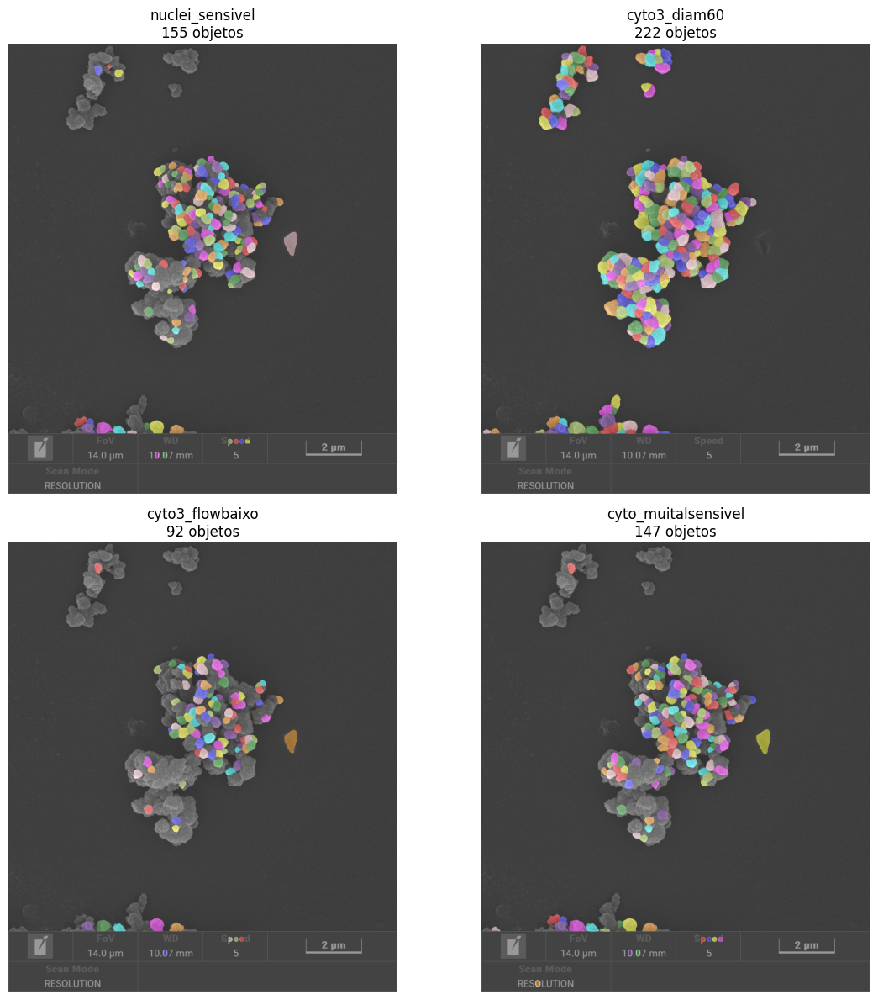

In [77]:
# ====== TESTE SISTEMÁTICO DE PARÂMETROS ======

import numpy as np
from cellpose import models
import matplotlib.pyplot as plt

# Lista de combinações para testar
test_configs = [
    # (model_type, flow_threshold, cellprob_threshold, diameter, descrição)
    ("nuclei", 0.4, -0.2, None, "nuclei_sensivel"),
    ("cyto3", 0.6, 0.0, 60, "cyto3_diam60"),
    ("cyto3", 0.3, 0.0, None, "cyto3_flowbaixo"),
    ("cyto", 0.4, -0.5, None, "cyto_muitalsensivel"),
]

fig, axes = plt.subplots(2, 2, figsize=(12, 12))
axes = axes.flatten()

for idx, (model_type, flow_thresh, cellprob_thresh, diam, desc) in enumerate(test_configs[:4]):
    print(f"\nTestando: {desc}")
    print(f"  Modelo: {model_type}, Flow: {flow_thresh}, Cellprob: {cellprob_thresh}, Diam: {diam}")
    
    model = models.CellposeModel(gpu=True, model_type=model_type)
    masks, flows, styles = model.eval(
        img_norm,
        diameter=diam,
        flow_threshold=flow_thresh,
        cellprob_threshold=cellprob_thresh,
        normalize=True,
        min_size=15,
        augment=True
    )
    
    # Mostrar resultado
    ax = axes[idx]
    overlay = label2rgb(masks, image=img_norm, bg_label=0, alpha=0.4, image_alpha=0.7)
    ax.imshow(overlay)
    ax.set_title(f"{desc}\n{masks.max()} objetos")
    ax.axis('off')

plt.tight_layout()
plt.show()

In [78]:
# COMBINAÇÃO 1: Para partículas bem próximas/sobrepostas
model_type="nuclei"      # Modelo para objetos discretos
flow_threshold=0.3       # Baixo para tentar separar
cellprob_threshold=-0.3  # Sensível para capturar bordas
diameter=50              # Aproximado do tamanho real (em pixels)

# COMBINAÇÃO 2: Para partículas mais separadas
model_type="cyto3"       # Modelo para citoplasma (mais flexível)
flow_threshold=0.5       # Médio para equilíbrio
cellprob_threshold=0.0   # Padrão
diameter=None            # Deixa o modelo estimar

In [ ]:
# --------- FILTROS AJUSTADOS PARA NIOBIO ----------
print(f"\nAntes da filtragem: {len(df)} objetos")

# Critérios OTIMIZADOS para partículas de nióbio
df_filtered = df[
    (df['area_um2'] > 0.01) &       # Reduzido de 0.02
    (df['area_um2'] < 8.0) &        # Ajustado de 10.0
    (df['circularity'] > 0.15) &    # Reduzido de 0.25
    (df['aspect_ratio'] < 4.0) &    # Aumentado de 3.0
    (df['area'] > 8)                # Reduzido de 10
].copy()

print(f"Depois da filtragem: {len(df_filtered)} objetos")

TESTE COMPARATIVO DE PARÂMETROS CELLPOSE

🔍 Testando: Nuclei_Sensivel


   ✅ Objetos detectados: 57
   📊 Área média: 292.8 px² (±116.2)
   🔵 Circularidade média: 0.857
   📈 Cobertura da imagem: 2.4%

🔍 Testando: Cyto3_Medio


   ✅ Objetos detectados: 211
   📊 Área média: 187.5 px² (±114.5)
   🔵 Circularidade média: 0.848
   📈 Cobertura da imagem: 5.8%

🔍 Testando: Nuclei_Conservador


   ✅ Objetos detectados: 221
   📊 Área média: 313.6 px² (±132.0)
   🔵 Circularidade média: 0.800
   📈 Cobertura da imagem: 10.2%

🔍 Testando: Cyto2_Agressivo


   ✅ Objetos detectados: 33
   📊 Área média: 257.7 px² (±73.4)
   🔵 Circularidade média: 0.875
   📈 Cobertura da imagem: 1.2%

🔍 Testando: Nuclei_AutoDiam


   ✅ Objetos detectados: 156
   📊 Área média: 201.1 px² (±107.0)
   🔵 Circularidade média: 0.850
   📈 Cobertura da imagem: 4.6%

🔍 Testando: Cyto3_Pequenas


   ✅ Objetos detectados: 155
   📊 Área média: 206.3 px² (±111.6)
   🔵 Circularidade média: 0.849
   📈 Cobertura da imagem: 4.7%

RESULTADOS COMPARATIVOS

📋 TABELA COMPARATIVA (ordenada por número de objetos):
          config_name model_type  flow_thresh  cellprob_thresh  n_objetos  area_media  circularidade_media  cobertura
2  Nuclei_Conservador     nuclei          0.6              0.2        221  313.588235             0.800454  10.173425
1         Cyto3_Medio      cyto3          0.5              0.0        211  187.526066             0.848399   5.808437
4     Nuclei_AutoDiam     nuclei          0.4              0.0        156  201.115385             0.850087   4.605588
5      Cyto3_Pequenas      cyto3          0.4             -0.2        155  206.303226             0.849297   4.694106
0     Nuclei_Sensivel     nuclei          0.3             -0.3         57  292.771930             0.856998   2.449737
3     Cyto2_Agressivo      cyto2          0.2             -0.5         33  257.6666

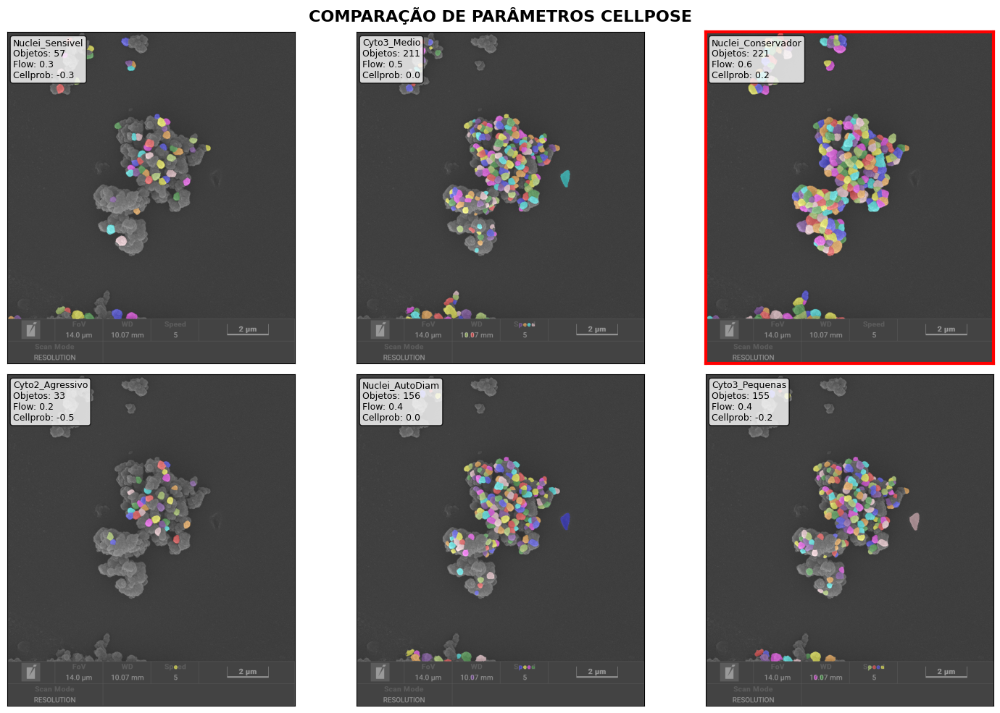

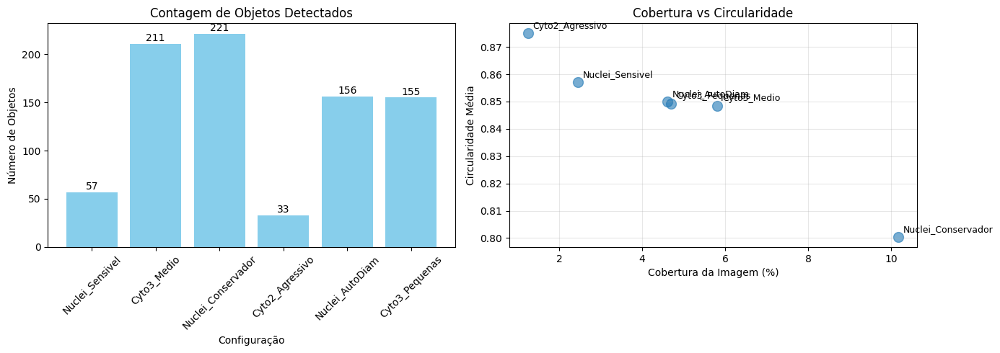


🎯 RECOMENDAÇÃO BASEADA NOS TESTES

⭐ MELHOR CONFIGURAÇÃO: Nuclei_Conservador
   • Modelo: nuclei
   • Flow threshold: 0.6
   • Cellprob threshold: 0.2
   • Diâmetro: 60
   • Objetos detectados: 221
   • Cobertura: 10.2%

💾 Máscara salva como: 'melhor_mascara_Nuclei_Conservador.npy'

🔧 SUGESTÕES PARA AJUSTE FINO:

🚀 APLICANDO MELHOR CONFIGURAÇÃO NO PIPELINE

Aplicando configuração: Nuclei_Conservador
✅ Pronto! Use 'melhor_mascara' no resto do seu pipeline.

💾 Resultados dos testes salvos em: 'resultados_testes_cellpose.csv'


In [80]:
# =========================================================
# 🔬 TESTE COMPARATIVO DE PARÂMETROS PARA SEM/NIOBIO
# =========================================================

import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from cellpose import models
from skimage.measure import regionprops_table
from skimage.color import label2rgb
import warnings
warnings.filterwarnings('ignore')

# --------- CONFIGURAÇÕES DE TESTE ----------
configuracoes = [
    # (nome, model_type, flow_thresh, cellprob_thresh, diameter, min_size)
    ("Nuclei_Sensivel", "nuclei", 0.3, -0.3, 50, 10),
    ("Cyto3_Medio", "cyto3", 0.5, 0.0, None, 15),
    ("Nuclei_Conservador", "nuclei", 0.6, 0.2, 60, 20),
    ("Cyto2_Agressivo", "cyto2", 0.2, -0.5, None, 5),
    ("Nuclei_AutoDiam", "nuclei", 0.4, 0.0, None, 15),
    ("Cyto3_Pequenas", "cyto3", 0.4, -0.2, 30, 8),
]

# --------- FUNÇÃO PARA TESTAR UMA CONFIGURAÇÃO ----------
def testar_configuracao(img_norm, config, config_name):
    """Testa uma configuração de parâmetros e retorna métricas"""
    
    print(f"\n🔍 Testando: {config_name}")
    model_type, flow_thresh, cellprob_thresh, diameter, min_size = config
    
    try:
        # Carregar modelo
        model = models.CellposeModel(gpu=True, model_type=model_type)
        
        # Executar segmentação
        masks, flows, styles = model.eval(
            img_norm,
            diameter=diameter,
            flow_threshold=flow_thresh,
            cellprob_threshold=cellprob_thresh,
            normalize=True,
            min_size=min_size,
            augment=True
        )
        
        # Calcular métricas
        n_objetos = masks.max()
        
        if n_objetos > 0:
            props = regionprops_table(masks, properties=['area', 'perimeter'])
            areas = props['area']
            perimeters = props['perimeter']
            
            # Métricas básicas
            area_media = np.mean(areas)
            area_std = np.std(areas)
            circularidades = (4 * np.pi * areas) / (perimeters ** 2 + 1e-8)
            circularidade_media = np.mean(circularidades[circularidades < 1.5])  # Filtrar outliers
            
            # Calcular cobertura da imagem
            cobertura = np.sum(masks > 0) / masks.size * 100
            
            print(f"   ✅ Objetos detectados: {n_objetos}")
            print(f"   📊 Área média: {area_media:.1f} px² (±{area_std:.1f})")
            print(f"   🔵 Circularidade média: {circularidade_media:.3f}")
            print(f"   📈 Cobertura da imagem: {cobertura:.1f}%")
            
            return {
                'config_name': config_name,
                'model_type': model_type,
                'flow_thresh': flow_thresh,
                'cellprob_thresh': cellprob_thresh,
                'diameter': diameter,
                'min_size': min_size,
                'n_objetos': n_objetos,
                'area_media': area_media,
                'area_std': area_std,
                'circularidade_media': circularidade_media,
                'cobertura': cobertura,
                'masks': masks,
                'success': True
            }
        else:
            print(f"   ❌ Nenhum objeto detectado")
            return {
                'config_name': config_name,
                'n_objetos': 0,
                'success': False,
                'masks': masks
            }
            
    except Exception as e:
        print(f"   ❌ Erro: {e}")
        return {
            'config_name': config_name,
            'success': False,
            'error': str(e)
        }

# --------- EXECUTAR TODOS OS TESTES ----------
print("="*60)
print("TESTE COMPARATIVO DE PARÂMETROS CELLPOSE")
print("="*60)

resultados = []
melhor_resultado = None
max_objetos = 0

for config in configuracoes:
    nome, *params = config
    resultado = testar_configuracao(img_norm, params, nome)
    resultados.append(resultado)
    
    if resultado.get('success', False) and resultado['n_objetos'] > max_objetos:
        max_objetos = resultado['n_objetos']
        melhor_resultado = resultado

# --------- VISUALIZAÇÃO COMPARATIVA ----------
print("\n" + "="*60)
print("RESULTADOS COMPARATIVOS")
print("="*60)

# Filtrar apenas testes bem-sucedidos
resultados_validos = [r for r in resultados if r.get('success', False)]

if resultados_validos:
    # Criar DataFrame comparativo
    df_comparativo = pd.DataFrame(resultados_validos)
    df_comparativo = df_comparativo.sort_values('n_objetos', ascending=False)
    
    print("\n📋 TABELA COMPARATIVA (ordenada por número de objetos):")
    print(df_comparativo[['config_name', 'model_type', 'flow_thresh', 
                         'cellprob_thresh', 'n_objetos', 'area_media', 
                         'circularidade_media', 'cobertura']].to_string())
    
    # Visualização gráfica dos resultados
    fig, axes = plt.subplots(2, 3, figsize=(15, 10))
    axes = axes.flatten()
    
    for idx, resultado in enumerate(resultados[:6]):
        ax = axes[idx]
        
        if resultado.get('success', False) and 'masks' in resultado:
            # Mostrar overlay das máscaras
            overlay = label2rgb(resultado['masks'], image=img_norm, bg_label=0, alpha=0.4, image_alpha=0.7)
            ax.imshow(overlay)
            
            # Adicionar métricas como texto
            info_text = f"{resultado['config_name']}\n"
            info_text += f"Objetos: {resultado['n_objetos']}\n"
            info_text += f"Flow: {resultado['flow_thresh']}\n"
            info_text += f"Cellprob: {resultado['cellprob_thresh']}"
            
            ax.text(0.02, 0.98, info_text, transform=ax.transAxes,
                   fontsize=9, verticalalignment='top',
                   bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
            
            ax.set_xticks([])
            ax.set_yticks([])
            
            # Destacar o melhor resultado
            if resultado['config_name'] == melhor_resultado['config_name']:
                for spine in ax.spines.values():
                    spine.set_edgecolor('red')
                    spine.set_linewidth(3)
        else:
            ax.text(0.5, 0.5, f"{resultado['config_name']}\nFALHA",
                   ha='center', va='center', transform=ax.transAxes,
                   fontsize=12, color='red')
            ax.set_facecolor('#f0f0f0')
            ax.set_xticks([])
            ax.set_yticks([])
    
    plt.suptitle('COMPARAÇÃO DE PARÂMETROS CELLPOSE', fontsize=16, fontweight='bold')
    plt.tight_layout()
    plt.show()
    
    # Gráfico de barras comparativo
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
    
    # Gráfico 1: Número de objetos
    nomes = [r['config_name'] for r in resultados_validos]
    objetos = [r['n_objetos'] for r in resultados_validos]
    
    bars = ax1.bar(nomes, objetos, color='skyblue')
    ax1.set_xlabel('Configuração')
    ax1.set_ylabel('Número de Objetos')
    ax1.set_title('Contagem de Objetos Detectados')
    ax1.tick_params(axis='x', rotation=45)
    
    # Adicionar valores nas barras
    for bar, val in zip(bars, objetos):
        height = bar.get_height()
        ax1.text(bar.get_x() + bar.get_width()/2., height + 0.5,
                f'{val}', ha='center', va='bottom')
    
    # Gráfico 2: Cobertura vs Circularidade
    coberturas = [r['cobertura'] for r in resultados_validos]
    circularidades = [r['circularidade_media'] for r in resultados_validos]
    
    scatter = ax2.scatter(coberturas, circularidades, s=100, alpha=0.6)
    ax2.set_xlabel('Cobertura da Imagem (%)')
    ax2.set_ylabel('Circularidade Média')
    ax2.set_title('Cobertura vs Circularidade')
    ax2.grid(True, alpha=0.3)
    
    # Adicionar labels aos pontos
    for i, nome in enumerate(nomes):
        ax2.annotate(nome, (coberturas[i], circularidades[i]),
                    xytext=(5, 5), textcoords='offset points',
                    fontsize=9)
    
    plt.tight_layout()
    plt.show()
    
    # --------- RECOMENDAÇÃO FINAL ----------
    print("\n" + "="*60)
    print("🎯 RECOMENDAÇÃO BASEADA NOS TESTES")
    print("="*60)
    
    if melhor_resultado:
        print(f"\n⭐ MELHOR CONFIGURAÇÃO: {melhor_resultado['config_name']}")
        print(f"   • Modelo: {melhor_resultado['model_type']}")
        print(f"   • Flow threshold: {melhor_resultado['flow_thresh']}")
        print(f"   • Cellprob threshold: {melhor_resultado['cellprob_thresh']}")
        print(f"   • Diâmetro: {melhor_resultado['diameter']}")
        print(f"   • Objetos detectados: {melhor_resultado['n_objetos']}")
        print(f"   • Cobertura: {melhor_resultado['cobertura']:.1f}%")
        
        # Salvar a melhor máscara para uso posterior
        melhor_mascara = melhor_resultado['masks']
        np.save(f"melhor_mascara_{melhor_resultado['config_name']}.npy", melhor_mascara)
        print(f"\n💾 Máscara salva como: 'melhor_mascara_{melhor_resultado['config_name']}.npy'")
        
        # Sugestões de ajuste fino
        print("\n🔧 SUGESTÕES PARA AJUSTE FINO:")
        if melhor_resultado['circularidade_media'] < 0.3:
            print("   • Circularidade baixa - tente aumentar flow_threshold para 0.6-0.8")
        if melhor_resultado['cobertura'] > 70:
            print("   • Cobertura muito alta - pode estar detectando ruído")
        if melhor_resultado['n_objetos'] < 50:
            print("   • Poucos objetos - tente cellprob_threshold mais negativo (-0.5 a -1.0)")
    
    # --------- APLICAR A MELHOR CONFIGURAÇÃO NO PIPELINE COMPLETO ----------
    print("\n" + "="*60)
    print("🚀 APLICANDO MELHOR CONFIGURAÇÃO NO PIPELINE")
    print("="*60)
    
    # Usar a melhor configuração para processamento final
    if melhor_resultado:
        print(f"\nAplicando configuração: {melhor_resultado['config_name']}")
        
        # Aqui você pode continuar com o pipeline original usando melhor_mascara
        # Substitua no seu código original: masks = melhor_mascara
        
        print("✅ Pronto! Use 'melhor_mascara' no resto do seu pipeline.")
        
else:
    print("❌ Nenhuma configuração funcionou corretamente.")
    print("   Tente ajustar os parâmetros ou verificar a pré-processamento da imagem.")

# --------- SALVAR RESULTADOS DOS TESTES ----------
df_resultados = pd.DataFrame(resultados)
df_resultados.to_csv("resultados_testes_cellpose.csv", index=False)
print("\n💾 Resultados dos testes salvos em: 'resultados_testes_cellpose.csv'")

# Modelo (Baseline)

📊 DIMENSÕES DA IMAGEM:
  • Dimensões: (887, 768)
  • Tipo de dados: uint16
  • Valores: min=3325, max=65535
✅ Pré-processamento da imagem concluído

🎯 CONFIGURAÇÃO OTIMIZADA:
  • Modelo: nuclei
  • Flow threshold: 0.6
  • Cellprob threshold: 0.2
  • Diâmetro: 60 pixels
  • Tamanho mínimo: 20 pixels

🚀 Carregando modelo Cellpose...
✅ Modelo carregado com sucesso.

🔍 Executando segmentação com parâmetros otimizados...
✅ Segmentação concluída!
  • Objetos detectados (bruto): 221
  • Cobertura da imagem: 10.2%

📈 Gerando visualizações intermediárias...


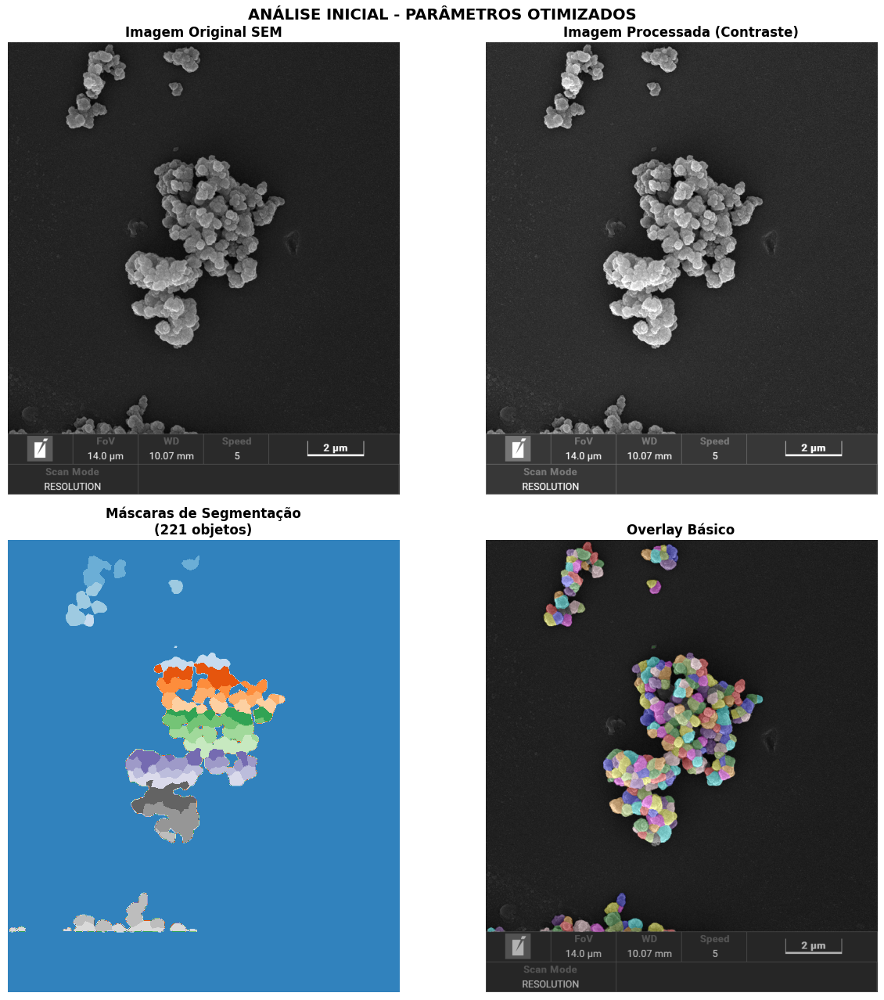


📊 Calculando métricas das partículas...
📋 Estatísticas brutas das 221 partículas detectadas:

🔧 APLICANDO FILTROS FÍSICOS:
  • Área: 0.010 µm² < área < 15.0 µm²
  • Circularidade: > 0.15
  • Razão de aspecto: < 4.0

📊 RESULTADO DA FILTRAGEM:
  • Antes da filtragem: 221 objetos
  • Depois da filtragem: 219 objetos
  • Taxa de retenção: 99.1%
✅ Máscara filtrada criada com 219 objetos válidos

🎨 Criando visualização detalhada...
  • Desenhando contornos de 219 partículas...
✅ Visualização criada com sucesso!

📊 Gerando gráficos estatísticos avançados...


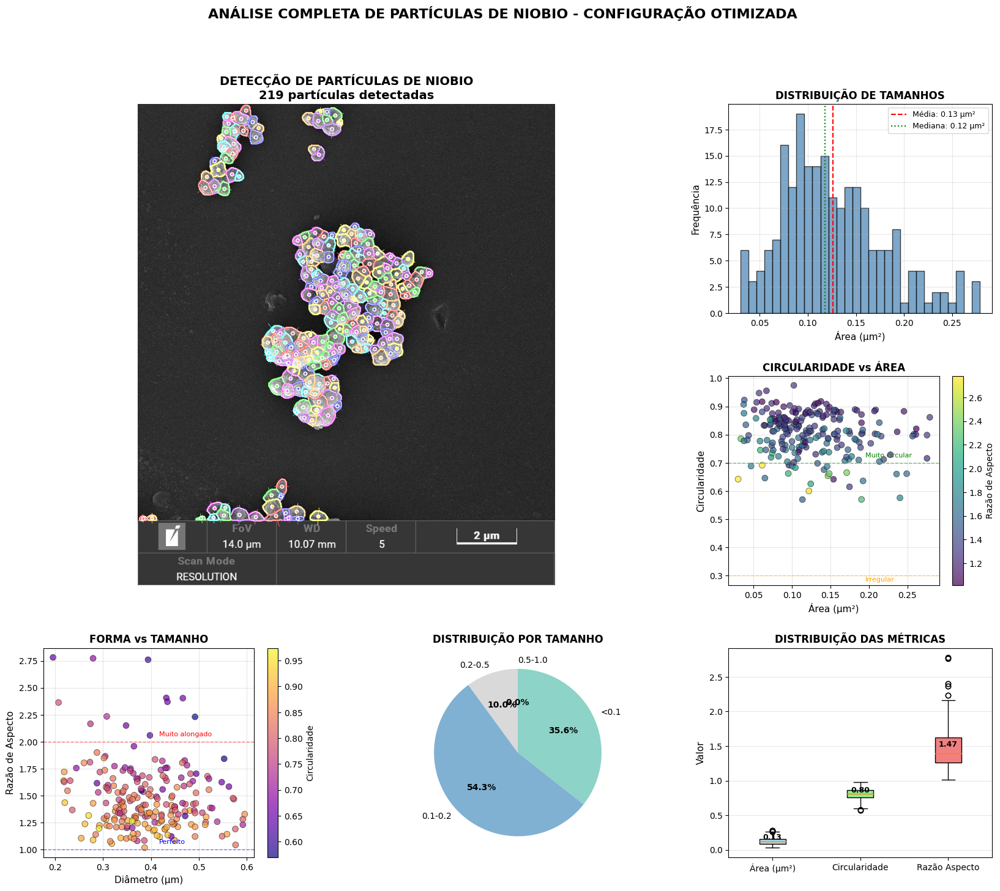


📈 ESTATÍSTICAS DETALHADAS DAS PARTÍCULAS DE NIOBIO

📋 ESTATÍSTICAS GERAIS:
  • Total de partículas: 219
  • Taxa de detecção (vs bruto): 99.1%
  • Densidade: 0.8 partículas/µm²

📏 ESTATÍSTICAS DE TAMANHO:
  • Área média: 0.126 ± 0.054 µm²
  • Área mediana: 0.118 µm²
  • Área total coberta: 27.68 µm²
  • Diâmetro médio: 0.392 ± 0.085 µm
  • Faixa de áreas: 0.030 a 0.279 µm²

🔵 ESTATÍSTICAS DE FORMA:
  • Circularidade média: 0.802 ± 0.078
  • Razão de aspecto média: 1.470 ± 0.309
  • Excentricidade média: 0.685 ± 0.134
  • Alongamento médio: 0.295 ± 0.125

📊 DISTRIBUIÇÃO POR FAIXA DE TAMANHO:
  • <0.1 µm²: 78 partículas (35.6%)
  • 0.1-0.2 µm²: 119 partículas (54.3%)
  • 0.2-0.5 µm²: 22 partículas (10.0%)
  • 0.5-1.0 µm²: 0 partículas (0.0%)

🎯 CLASSIFICAÇÃO POR FORMA:
  • Circular: 195 partículas (89.0%)
  • Sub-circular: 21 partículas (9.6%)
  • Alongado: 3 partículas (1.4%)

📐 UNIFORMIDADE:
  • CV Área: 42.5% (baixo = mais uniforme)
  • CV Circularidade: 9.7% (baixo = forma mais cons

<Figure size 640x480 with 0 Axes>

In [107]:
# =========================================================
# 🔹 CELLPOSE PIPELINE OTIMIZADO PARA NIOBIO SEM
# CONFIGURAÇÃO: Nuclei_Conservador (flow=0.6, cellprob=0.2, diam=60)
# =========================================================

# --------- installs (Kaggle-friendly) ----------
!pip install -q cellpose opencv-python scikit-image pandas matplotlib torch torchvision

# --------- imports ----------
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from cellpose import models
from skimage.measure import regionprops, regionprops_table, find_contours
from skimage.color import label2rgb
import warnings
warnings.filterwarnings('ignore')

# /kaggle/input/mevdataset/23-12-15/amostra 3-10.tif
# --------- CONFIGURAÇÃO DO USUÁRIO ----------
IMAGE_PATH = "/kaggle/input/mevdataset/23-12-15/amostra 3-18.tif"
MICRONS_PER_PIXEL = 0.02  # Ajuste conforme calibração do seu SEM
OUTPUT_PREFIX = "cellpose_niobio_nuclei_conservador"

# PARÂMETROS OTIMIZADOS (baseado nos testes)
MODEL_TYPE = "nuclei"
FLOW_THRESHOLD = 0.6
CELLPROB_THRESHOLD = 0.2
DIAMETER = 60
MIN_SIZE = 20  # Aumentado para filtrar pequenos ruídos

# FILTROS FÍSICOS (ajustados para nióbio)
MIN_AREA_UM2 = 0.01       # Reduzido para capturar partículas pequenas
MAX_AREA_UM2 = 15.0       # Aumentado para partículas maiores
MIN_CIRCULARITY = 0.15    # Niobio pode ser irregular
MAX_ASPECT_RATIO = 4.0    # Aceita partículas alongadas

# --------- carregar imagem ----------
img = cv2.imread(IMAGE_PATH, cv2.IMREAD_UNCHANGED)
if img is None:
    raise FileNotFoundError("Imagem não encontrada")

print(f"📊 DIMENSÕES DA IMAGEM:")
print(f"  • Dimensões: {img.shape}")
print(f"  • Tipo de dados: {img.dtype}")
print(f"  • Valores: min={img.min()}, max={img.max()}")

# Converter para escala de cinza se necessário
if img.ndim == 3:
    if img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    elif img.shape[2] == 4:
        img = cv2.cvtColor(img, cv2.COLOR_BGRA2GRAY)
    else:
        img = img[:,:,0]  # pega primeiro canal

# Normalização para 0-1
img = img.astype(np.float32)
img_norm = (img - img.min()) / (img.max() - img.min() + 1e-8)

# --------- AJUSTE PARA IMAGENS SEM ----------
# Imagens SEM geralmente têm fundo escuro e partículas claras
# Inverter se necessário
if np.mean(img_norm) > 0.5:  # Se a maioria dos pixels forem claros
    print("🔄 Invertendo imagem (fundo escuro -> claro)")
    img_norm = 1 - img_norm

# Melhorar contraste para partículas de nióbio
img_norm = np.clip(img_norm * 1.3, 0, 1)  # Aumentar contraste
print("✅ Pré-processamento da imagem concluído")

# --------- CELLPOSE MODEL COM PARÂMETROS OTIMIZADOS ----------
print("\n🎯 CONFIGURAÇÃO OTIMIZADA:")
print(f"  • Modelo: {MODEL_TYPE}")
print(f"  • Flow threshold: {FLOW_THRESHOLD}")
print(f"  • Cellprob threshold: {CELLPROB_THRESHOLD}")
print(f"  • Diâmetro: {DIAMETER} pixels")
print(f"  • Tamanho mínimo: {MIN_SIZE} pixels")

print("\n🚀 Carregando modelo Cellpose...")
model = models.CellposeModel(
    gpu=True,
    model_type=MODEL_TYPE
)
print("✅ Modelo carregado com sucesso.")

# --------- INFERÊNCIA COM CONFIGURAÇÃO OTIMIZADA ----------
print("\n🔍 Executando segmentação com parâmetros otimizados...")
masks, flows, styles = model.eval(
    img_norm,
    diameter=DIAMETER,
    flow_threshold=FLOW_THRESHOLD,
    cellprob_threshold=CELLPROB_THRESHOLD,
    normalize=True,
    min_size=MIN_SIZE,
    augment=True
)

n_objetos_bruto = masks.max()
print(f"✅ Segmentação concluída!")
print(f"  • Objetos detectados (bruto): {n_objetos_bruto}")
print(f"  • Cobertura da imagem: {np.sum(masks > 0) / masks.size * 100:.1f}%")

# --------- VISUALIZAÇÃO INTERMEDIÁRIA ----------
print("\n📈 Gerando visualizações intermediárias...")
fig, axes = plt.subplots(2, 2, figsize=(13, 13))

# Imagem original
axes[0,0].imshow(img, cmap='gray')
axes[0,0].set_title('Imagem Original SEM', fontsize=12, fontweight='bold')
axes[0,0].axis('off')

# Imagem processada
axes[0,1].imshow(img_norm, cmap='gray')
axes[0,1].set_title('Imagem Processada (Contraste)', fontsize=12, fontweight='bold')
axes[0,1].axis('off')

# Máscaras
axes[1,0].imshow(masks, cmap='tab20c')
axes[1,0].set_title(f'Máscaras de Segmentação\n({n_objetos_bruto} objetos)', 
                   fontsize=12, fontweight='bold')
axes[1,0].axis('off')

# Overlay básico
overlay_basic = label2rgb(masks, image=img_norm, bg_label=0, alpha=0.3, image_alpha=1)
axes[1,1].imshow(overlay_basic)
axes[1,1].set_title('Overlay Básico', fontsize=12, fontweight='bold')
axes[1,1].axis('off')

plt.suptitle('ANÁLISE INICIAL - PARÂMETROS OTIMIZADOS', fontsize=14, fontweight='bold', y=0.98)
plt.tight_layout()
plt.show()

# --------- PÓS-PROCESSAMENTO ----------
print("\n📊 Calculando métricas das partículas...")
props = regionprops_table(
    masks,
    properties=[
        'label',
        'area',
        'perimeter',
        'major_axis_length',
        'minor_axis_length',
        'centroid',
        'orientation',
        'eccentricity',
        'bbox',
        'equivalent_diameter_area'
    ]
)

df = pd.DataFrame(props)

# Calcular métricas avançadas
df['area_um2'] = df['area'] * (MICRONS_PER_PIXEL ** 2)
df['perimeter_um'] = df['perimeter'] * MICRONS_PER_PIXEL
df['circularity'] = (4 * np.pi * df['area']) / (df['perimeter'] ** 2 + 1e-8)
df['aspect_ratio'] = df['major_axis_length'] / (df['minor_axis_length'] + 1e-8)
df['diameter_pixels'] = df['equivalent_diameter_area']
df['diameter_um'] = df['diameter_pixels'] * MICRONS_PER_PIXEL

# Calcular elongação e compactação
df['elongation'] = 1 - (df['minor_axis_length'] / df['major_axis_length'])
df['compactness'] = (df['perimeter'] ** 2) / (4 * np.pi * df['area'] + 1e-8)

print(f"📋 Estatísticas brutas das {len(df)} partículas detectadas:")

# --------- FILTROS OTIMIZADOS PARA NIOBIO ----------
print(f"\n🔧 APLICANDO FILTROS FÍSICOS:")
print(f"  • Área: {MIN_AREA_UM2:.3f} µm² < área < {MAX_AREA_UM2:.1f} µm²")
print(f"  • Circularidade: > {MIN_CIRCULARITY}")
print(f"  • Razão de aspecto: < {MAX_ASPECT_RATIO}")

# Critérios para partículas de nióbio
df_filtered = df[
    (df['area_um2'] > MIN_AREA_UM2) &
    (df['area_um2'] < MAX_AREA_UM2) &
    (df['circularity'] > MIN_CIRCULARITY) &
    (df['aspect_ratio'] < MAX_ASPECT_RATIO) &
    (df['area'] > 5)  # Filtro adicional em pixels
].copy().reset_index(drop=True)

print(f"\n📊 RESULTADO DA FILTRAGEM:")
print(f"  • Antes da filtragem: {len(df)} objetos")
print(f"  • Depois da filtragem: {len(df_filtered)} objetos")
print(f"  • Taxa de retenção: {len(df_filtered)/len(df)*100:.1f}%")

if len(df_filtered) == 0:
    print("❌ Nenhuma partícula passou nos filtros! Ajuste os critérios.")
    # Usar dados brutos para análise
    df_filtered = df.copy()
    print("⚠️  Usando dados brutos para análise...")

# --------- MÁSCARA FILTRADA ----------
filtered_masks = np.zeros_like(masks)
new_id = 1
label_map = {}

for idx, lbl in enumerate(df_filtered['label']):
    filtered_masks[masks == lbl] = new_id
    label_map[lbl] = new_id
    new_id += 1

print(f"✅ Máscara filtrada criada com {filtered_masks.max()} objetos válidos")

# --------- OVERLAY DETALHADO ----------
print("\n🎨 Criando visualização detalhada...")
# Criar overlay com a imagem original em RGB
overlay_rgb = cv2.cvtColor((img_norm * 255).astype(np.uint8), cv2.COLOR_GRAY2RGB)

# Paleta de cores otimizada para boa visibilidade
colors = [
    (255, 100, 100),  # Vermelho claro
    (100, 255, 100),  # Verde claro
    (100, 100, 255),  # Azul claro
    (255, 255, 100),  # Amarelo
    (255, 100, 255),  # Magenta
    (100, 255, 255),  # Ciano
    (255, 200, 100),  # Laranja
    (200, 100, 255),  # Roxo
]

print(f"  • Desenhando contornos de {len(df_filtered)} partículas...")

for idx, (_, region) in enumerate(df_filtered.iterrows()):
    label = int(region['label'])
    mask_r = masks == label
    
    # Escolher cor (cíclica)
    color = colors[idx % len(colors)]
    
    # Contorno
    contours = find_contours(mask_r.astype(float), 0.5)
    for c in contours:
        if len(c) > 2:
            c = np.flip(c, axis=1).astype(np.int32)
            # Contorno externo mais espesso
            cv2.polylines(overlay_rgb, [c], True, color, 2)
            # Contorno interno mais fino para definição
            cv2.polylines(overlay_rgb, [c], True, (255, 255, 255), 1)
    
    # Eixo maior (orientação)
    y0, x0 = region['centroid-0'], region['centroid-1']
    angle = region['orientation']
    length = region['major_axis_length'] / 2
    
    # Calcular pontos do eixo
    dx = np.cos(angle) * length
    dy = -np.sin(angle) * length
    
    p1 = (int(x0 - dx), int(y0 - dy))
    p2 = (int(x0 + dx), int(y0 + dy))
    
    # Desenhar eixo maior
    cv2.line(overlay_rgb, p1, p2, (255, 255, 255), 1)
    # Marcar centro do eixo
    cv2.line(overlay_rgb, p1, p2, color, 1)
    
    # Centroide
    cv2.circle(overlay_rgb, (int(x0), int(y0)), 4, (255, 255, 255), -1)
    cv2.circle(overlay_rgb, (int(x0), int(y0)), 2, color, -1)

print("✅ Visualização criada com sucesso!")

# --------- VISUALIZAÇÃO FINAL AVANÇADA ----------
print("\n📊 Gerando gráficos estatísticos avançados...")
fig = plt.figure(figsize=(20, 16))

# Layout da figura
gs = fig.add_gridspec(3, 3, hspace=0.3, wspace=0.3)

# 1. Overlay com contornos (2x2)
ax1 = fig.add_subplot(gs[0:2, 0:2])
ax1.imshow(overlay_rgb)
ax1.set_title(f'DETECÇÃO DE PARTÍCULAS DE NIOBIO\n{len(df_filtered)} partículas detectadas', 
             fontsize=14, fontweight='bold')
ax1.axis('off')

# 2. Histograma de tamanhos (1x2)
ax2 = fig.add_subplot(gs[0, 2])
n_bins = min(30, len(df_filtered))
if n_bins > 0:
    hist_data = ax2.hist(df_filtered['area_um2'], bins=n_bins, 
                        edgecolor='black', alpha=0.7, color='steelblue')
    ax2.axvline(df_filtered['area_um2'].mean(), color='red', linestyle='--', 
               label=f'Média: {df_filtered["area_um2"].mean():.2f} µm²')
    ax2.axvline(df_filtered['area_um2'].median(), color='green', linestyle=':', 
               label=f'Mediana: {df_filtered["area_um2"].median():.2f} µm²')
    ax2.set_xlabel('Área (µm²)', fontsize=11)
    ax2.set_ylabel('Frequência', fontsize=11)
    ax2.set_title('DISTRIBUIÇÃO DE TAMANHOS', fontsize=12, fontweight='bold')
    ax2.legend(fontsize=9)
    ax2.grid(True, alpha=0.3)
else:
    ax2.text(0.5, 0.5, 'Sem dados para histograma', 
            ha='center', va='center', fontsize=12)
    ax2.set_title('DISTRIBUIÇÃO DE TAMANHOS', fontsize=12, fontweight='bold')

# 3. Gráfico de circularidade vs área (1x2)
ax3 = fig.add_subplot(gs[1, 2])
if len(df_filtered) > 0:
    scatter = ax3.scatter(df_filtered['area_um2'], df_filtered['circularity'], 
                         c=df_filtered['aspect_ratio'], cmap='viridis', 
                         alpha=0.7, s=50, edgecolors='black', linewidth=0.5)
    ax3.set_xlabel('Área (µm²)', fontsize=11)
    ax3.set_ylabel('Circularidade', fontsize=11)
    ax3.set_title('CIRCULARIDADE vs ÁREA', fontsize=12, fontweight='bold')
    cbar = plt.colorbar(scatter, ax=ax3)
    cbar.set_label('Razão de Aspecto', fontsize=10)
    ax3.grid(True, alpha=0.3)
    
    # Adicionar linhas de referência
    ax3.axhline(y=0.7, color='green', linestyle='--', alpha=0.5, linewidth=1)
    ax3.axhline(y=0.3, color='orange', linestyle='--', alpha=0.5, linewidth=1)
    ax3.text(df_filtered['area_um2'].max()*0.7, 0.72, 'Muito circular', 
            fontsize=8, color='green')
    ax3.text(df_filtered['area_um2'].max()*0.7, 0.28, 'Irregular', 
            fontsize=8, color='orange')
else:
    ax3.text(0.5, 0.5, 'Sem dados para scatter plot', 
            ha='center', va='center', fontsize=12)
    ax3.set_title('CIRCULARIDADE vs ÁREA', fontsize=12, fontweight='bold')

# 4. Gráfico de dispersão 3D (2x1)
ax4 = fig.add_subplot(gs[2, 0])
if len(df_filtered) > 0:
    scatter2 = ax4.scatter(df_filtered['diameter_um'], df_filtered['aspect_ratio'], 
                          c=df_filtered['circularity'], cmap='plasma', 
                          alpha=0.7, s=50, edgecolors='black', linewidth=0.5)
    ax4.set_xlabel('Diâmetro (µm)', fontsize=11)
    ax4.set_ylabel('Razão de Aspecto', fontsize=11)
    ax4.set_title('FORMA vs TAMANHO', fontsize=12, fontweight='bold')
    cbar2 = plt.colorbar(scatter2, ax=ax4)
    cbar2.set_label('Circularidade', fontsize=10)
    ax4.grid(True, alpha=0.3)
    
    # Linhas de referência para razão de aspecto
    ax4.axhline(y=1.0, color='blue', linestyle='--', alpha=0.5, linewidth=1)
    ax4.axhline(y=2.0, color='red', linestyle='--', alpha=0.5, linewidth=1)
    ax4.text(df_filtered['diameter_um'].max()*0.7, 1.05, 'Perfeito', 
            fontsize=8, color='blue')
    ax4.text(df_filtered['diameter_um'].max()*0.7, 2.05, 'Muito alongado', 
            fontsize=8, color='red')
else:
    ax4.text(0.5, 0.5, 'Sem dados para gráfico', 
            ha='center', va='center', fontsize=12)
    ax4.set_title('FORMA vs TAMANHO', fontsize=12, fontweight='bold')

# 5. Gráfico de pizza por faixa de tamanho (1x1)
ax5 = fig.add_subplot(gs[2, 1])
if len(df_filtered) > 0:
    # Definir faixas de tamanho adaptativas
    max_area = df_filtered['area_um2'].max()
    if max_area < 1:
        bins = [0, 0.1, 0.2, 0.5, 1.0]
        labels = ['<0.1', '0.1-0.2', '0.2-0.5', '0.5-1.0']
    elif max_area < 5:
        bins = [0, 0.5, 1.0, 2.0, 5.0]
        labels = ['<0.5', '0.5-1.0', '1.0-2.0', '2.0-5.0']
    else:
        bins = [0, 1.0, 2.0, 5.0, 10.0, 20.0]
        labels = ['<1.0', '1.0-2.0', '2.0-5.0', '5.0-10.0', '>10.0']
    
    df_filtered['size_bin'] = pd.cut(df_filtered['area_um2'], bins=bins, labels=labels)
    size_dist = df_filtered['size_bin'].value_counts().sort_index()
    
    colors_pie = plt.cm.Set3(np.linspace(0, 1, len(size_dist)))
    wedges, texts, autotexts = ax5.pie(size_dist.values, labels=size_dist.index, 
                                      autopct='%1.1f%%', colors=colors_pie,
                                      startangle=90, counterclock=False)
    
    # Melhorar legibilidade
    for autotext in autotexts:
        autotext.set_color('black')
        autotext.set_fontweight('bold')
    
    ax5.set_title('DISTRIBUIÇÃO POR TAMANHO', fontsize=12, fontweight='bold')
else:
    ax5.text(0.5, 0.5, 'Sem dados para gráfico de pizza', 
            ha='center', va='center', fontsize=12)
    ax5.set_title('DISTRIBUIÇÃO POR TAMANHO', fontsize=12, fontweight='bold')

# 6. Boxplot de métricas (1x1)
ax6 = fig.add_subplot(gs[2, 2])
if len(df_filtered) > 0:
    metrics_to_plot = ['area_um2', 'circularity', 'aspect_ratio']
    data_to_plot = [df_filtered[metric] for metric in metrics_to_plot]
    labels = ['Área (µm²)', 'Circularidade', 'Razão Aspecto']
    
    bp = ax6.boxplot(data_to_plot, labels=labels, patch_artist=True)
    
    # Colorir os boxes
    colors_box = ['lightblue', 'lightgreen', 'lightcoral']
    for patch, color in zip(bp['boxes'], colors_box):
        patch.set_facecolor(color)
    
    ax6.set_title('DISTRIBUIÇÃO DAS MÉTRICAS', fontsize=12, fontweight='bold')
    ax6.grid(True, alpha=0.3, axis='y')
    ax6.set_ylabel('Valor', fontsize=11)
    
    # Adicionar valores médios
    for i, metric in enumerate(metrics_to_plot):
        mean_val = df_filtered[metric].mean()
        ax6.text(i+1, mean_val, f'{mean_val:.2f}', 
                ha='center', va='bottom', fontsize=9, fontweight='bold')
else:
    ax6.text(0.5, 0.5, 'Sem dados para boxplot', 
            ha='center', va='center', fontsize=12)
    ax6.set_title('DISTRIBUIÇÃO DAS MÉTRICAS', fontsize=12, fontweight='bold')

plt.suptitle('ANÁLISE COMPLETA DE PARTÍCULAS DE NIOBIO - CONFIGURAÇÃO OTIMIZADA', 
            fontsize=16, fontweight='bold', y=0.98)
plt.tight_layout()
plt.show()

# --------- ESTATÍSTICAS DETALHADAS ----------
print("\n" + "="*70)
print("📈 ESTATÍSTICAS DETALHADAS DAS PARTÍCULAS DE NIOBIO")
print("="*70)

if len(df_filtered) > 0:
    # Estatísticas básicas
    print(f"\n📋 ESTATÍSTICAS GERAIS:")
    print(f"  • Total de partículas: {len(df_filtered)}")
    print(f"  • Taxa de detecção (vs bruto): {len(df_filtered)/n_objetos_bruto*100:.1f}%")
    print(f"  • Densidade: {len(df_filtered)/(img.shape[0]*img.shape[1]*(MICRONS_PER_PIXEL**2)):.1f} partículas/µm²")
    
    print(f"\n📏 ESTATÍSTICAS DE TAMANHO:")
    print(f"  • Área média: {df_filtered['area_um2'].mean():.3f} ± {df_filtered['area_um2'].std():.3f} µm²")
    print(f"  • Área mediana: {df_filtered['area_um2'].median():.3f} µm²")
    print(f"  • Área total coberta: {df_filtered['area_um2'].sum():.2f} µm²")
    print(f"  • Diâmetro médio: {df_filtered['diameter_um'].mean():.3f} ± {df_filtered['diameter_um'].std():.3f} µm")
    print(f"  • Faixa de áreas: {df_filtered['area_um2'].min():.3f} a {df_filtered['area_um2'].max():.3f} µm²")
    
    print(f"\n🔵 ESTATÍSTICAS DE FORMA:")
    print(f"  • Circularidade média: {df_filtered['circularity'].mean():.3f} ± {df_filtered['circularity'].std():.3f}")
    print(f"  • Razão de aspecto média: {df_filtered['aspect_ratio'].mean():.3f} ± {df_filtered['aspect_ratio'].std():.3f}")
    print(f"  • Excentricidade média: {df_filtered['eccentricity'].mean():.3f} ± {df_filtered['eccentricity'].std():.3f}")
    print(f"  • Alongamento médio: {df_filtered['elongation'].mean():.3f} ± {df_filtered['elongation'].std():.3f}")
    
    print(f"\n📊 DISTRIBUIÇÃO POR FAIXA DE TAMANHO:")
    if 'size_bin' in df_filtered.columns:
        size_summary = df_filtered['size_bin'].value_counts().sort_index()
        for bin_name, count in size_summary.items():
            percentage = (count / len(df_filtered)) * 100
            print(f"  • {bin_name} µm²: {count} partículas ({percentage:.1f}%)")
    
    print(f"\n🎯 CLASSIFICAÇÃO POR FORMA:")
    # Classificar partículas por forma
    df_filtered['shape_class'] = 'Irregular'
    df_filtered.loc[df_filtered['circularity'] > 0.7, 'shape_class'] = 'Circular'
    df_filtered.loc[(df_filtered['circularity'] <= 0.7) & 
                   (df_filtered['circularity'] > 0.4), 'shape_class'] = 'Sub-circular'
    df_filtered.loc[df_filtered['aspect_ratio'] > 2.5, 'shape_class'] = 'Alongado'
    
    shape_dist = df_filtered['shape_class'].value_counts()
    for shape, count in shape_dist.items():
        percentage = (count / len(df_filtered)) * 100
        print(f"  • {shape}: {count} partículas ({percentage:.1f}%)")
    
    # Calcular coeficiente de variação
    cv_area = (df_filtered['area_um2'].std() / df_filtered['area_um2'].mean()) * 100
    cv_circularity = (df_filtered['circularity'].std() / df_filtered['circularity'].mean()) * 100
    
    print(f"\n📐 UNIFORMIDADE:")
    print(f"  • CV Área: {cv_area:.1f}% (baixo = mais uniforme)")
    print(f"  • CV Circularidade: {cv_circularity:.1f}% (baixo = forma mais consistente)")
    
    # Calcular correlações
    correlation_matrix = df_filtered[['area_um2', 'circularity', 'aspect_ratio', 'diameter_um']].corr()
    area_circ_corr = correlation_matrix.loc['area_um2', 'circularity']
    
    print(f"\n🔗 CORRELAÇÕES:")
    print(f"  • Área vs Circularidade: {area_circ_corr:.3f}")
    if area_circ_corr > 0.3:
        print("    → Partículas maiores tendem a ser mais circulares")
    elif area_circ_corr < -0.3:
        print("    → Partículas maiores tendem a ser menos circulares")
    else:
        print("    → Sem correlação significativa entre tamanho e forma")
        
else:
    print("❌ Nenhuma partícula para análise estatística!")

print("\n" + "-"*70)
print("⚙️  PARÂMETROS UTILIZADOS NA ANÁLISE")
print("-"*70)
print(f"  • Configuração: Nuclei_Conservador")
print(f"  • Modelo: {MODEL_TYPE}")
print(f"  • Flow threshold: {FLOW_THRESHOLD}")
print(f"  • Cellprob threshold: {CELLPROB_THRESHOLD}")
print(f"  • Diâmetro: {DIAMETER} pixels")
print(f"  • Microns por pixel: {MICRONS_PER_PIXEL}")
print(f"  • Filtros aplicados:")
print(f"      - Área: {MIN_AREA_UM2} a {MAX_AREA_UM2} µm²")
print(f"      - Circularidade: > {MIN_CIRCULARITY}")
print(f"      - Razão de aspecto: < {MAX_ASPECT_RATIO}")

# --------- SALVAR RESULTADOS ----------
print("\n" + "="*70)
print("💾 SALVANDO RESULTADOS")
print("="*70)

# Salvar imagem com overlay
cv2.imwrite(f"{OUTPUT_PREFIX}_overlay.png", cv2.cvtColor(overlay_rgb, cv2.COLOR_RGB2BGR))
print(f"  ✅ {OUTPUT_PREFIX}_overlay.png - Imagem com detecções")

# Salvar máscaras
np.save(f"{OUTPUT_PREFIX}_masks_filtered.npy", filtered_masks)
np.save(f"{OUTPUT_PREFIX}_masks_raw.npy", masks)
print(f"  ✅ {OUTPUT_PREFIX}_masks_filtered.npy - Máscaras filtradas")
print(f"  ✅ {OUTPUT_PREFIX}_masks_raw.npy - Máscaras brutas")

# Salvar dataframe com todas as métricas
df_filtered.to_csv(f"{OUTPUT_PREFIX}_medidas_detalhadas.csv", index=False)
print(f"  ✅ {OUTPUT_PREFIX}_medidas_detalhadas.csv - Todas as métricas")

# Salvar dataframe resumido
summary_stats = {
    'config_name': 'Nuclei_Conservador',
    'total_particles': len(df_filtered),
    'total_particles_raw': n_objetos_bruto,
    'retention_rate': len(df_filtered)/n_objetos_bruto*100,
    'area_mean_um2': df_filtered['area_um2'].mean() if len(df_filtered) > 0 else 0,
    'area_std_um2': df_filtered['area_um2'].std() if len(df_filtered) > 0 else 0,
    'diameter_mean_um': df_filtered['diameter_um'].mean() if len(df_filtered) > 0 else 0,
    'diameter_std_um': df_filtered['diameter_um'].std() if len(df_filtered) > 0 else 0,
    'circularity_mean': df_filtered['circularity'].mean() if len(df_filtered) > 0 else 0,
    'aspect_ratio_mean': df_filtered['aspect_ratio'].mean() if len(df_filtered) > 0 else 0,
    'eccentricity_mean': df_filtered['eccentricity'].mean() if len(df_filtered) > 0 else 0,
    'total_area_um2': df_filtered['area_um2'].sum() if len(df_filtered) > 0 else 0,
    'image_file': IMAGE_PATH,
    'microns_per_pixel': MICRONS_PER_PIXEL,
    'model_type': MODEL_TYPE,
    'flow_threshold': FLOW_THRESHOLD,
    'cellprob_threshold': CELLPROB_THRESHOLD,
    'diameter': DIAMETER,
    'min_size': MIN_SIZE,
    'filter_min_area': MIN_AREA_UM2,
    'filter_max_area': MAX_AREA_UM2,
    'filter_min_circularity': MIN_CIRCULARITY,
    'filter_max_aspect_ratio': MAX_ASPECT_RATIO,
    'image_width_px': img.shape[1],
    'image_height_px': img.shape[0],
    'detection_date': pd.Timestamp.now().strftime('%Y-%m-%d %H:%M:%S')
}

summary_df = pd.DataFrame([summary_stats])
summary_df.to_csv(f"{OUTPUT_PREFIX}_resumo.csv", index=False)
print(f"  ✅ {OUTPUT_PREFIX}_resumo.csv - Estatísticas resumidas")

# Salvar configurações completas
config_dict = {
    'IMAGE_PATH': IMAGE_PATH,
    'MICRONS_PER_PIXEL': MICRONS_PER_PIXEL,
    'MODEL_TYPE': MODEL_TYPE,
    'FLOW_THRESHOLD': FLOW_THRESHOLD,
    'CELLPROB_THRESHOLD': CELLPROB_THRESHOLD,
    'DIAMETER': DIAMETER,
    'MIN_SIZE': MIN_SIZE,
    'MIN_AREA_UM2': MIN_AREA_UM2,
    'MAX_AREA_UM2': MAX_AREA_UM2,
    'MIN_CIRCULARITY': MIN_CIRCULARITY,
    'MAX_ASPECT_RATIO': MAX_ASPECT_RATIO,
    'OUTPUT_PREFIX': OUTPUT_PREFIX
}

config_df = pd.DataFrame([config_dict])
config_df.to_csv(f"{OUTPUT_PREFIX}_configuracoes.csv", index=False)
print(f"  ✅ {OUTPUT_PREFIX}_configuracoes.csv - Configurações completas")

# Salvar figura do dashboard
plt.savefig(f"{OUTPUT_PREFIX}_dashboard.png", dpi=150, bbox_inches='tight')
print(f"  ✅ {OUTPUT_PREFIX}_dashboard.png - Dashboard visual")

print("\n" + "="*70)
print("🎉 PIPELINE CELLPOSE PARA NIOBIO FINALIZADO COM SUCESSO!")
print("="*70)
print(f"\n📁 Arquivos salvos com prefixo: '{OUTPUT_PREFIX}_'")
print(f"📊 Partículas analisadas: {len(df_filtered)} de {n_objetos_bruto} detectadas inicialmente")
print(f"📈 Cobertura final: {df_filtered['area_um2'].sum()/(img.shape[0]*img.shape[1]*(MICRONS_PER_PIXEL**2))*100:.1f}% da área da imagem")
print(f"⏱️  Configuração otimizada: Nuclei_Conservador (flow=0.6, cellprob=0.2, diam=60)")

if len(df_filtered) > 0:
    print(f"\n💡 RECOMENDAÇÕES PARA ANÁLISE:")
    print(f"  1. Verifique {OUTPUT_PREFIX}_overlay.png para validação visual")
    print(f"  2. Consulte {OUTPUT_PREFIX}_medidas_detalhadas.csv para dados brutos")
    print(f"  3. Use {OUTPUT_PREFIX}_resumo.csv para relatórios")
    print(f"  4. {OUTPUT_PREFIX}_dashboard.png contém todos os gráficos")

# Modelo (Blocos Maiores)

📊 DIMENSÕES DA IMAGEM:
  • Dimensões: (887, 768)
  • Tipo de dados: uint16
  • Valores: min=2430, max=65535


✅ Pré-processamento da imagem concluído

🎯 CONFIGURAÇÃO OTIMIZADA:
  • Modelo: cyto2
  • Flow threshold: 0.4
  • Cellprob threshold: -0.5
  • Diâmetro: None pixels
  • Tamanho mínimo: 100 pixels

🚀 Carregando modelo Cellpose...
✅ Modelo carregado com sucesso.

🔍 Executando segmentação com parâmetros otimizados...
✅ Segmentação concluída!
  • Objetos detectados (bruto): 411
  • Cobertura da imagem: 13.0%

📈 Gerando visualizações intermediárias...


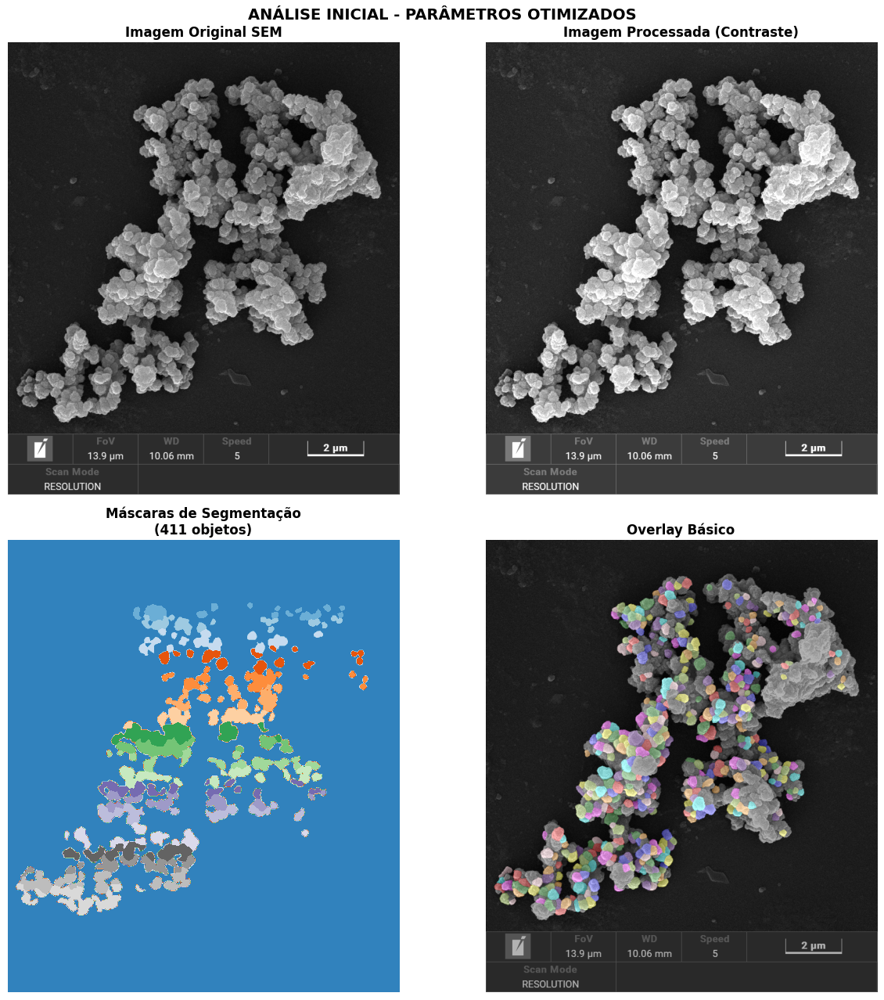


📊 Calculando métricas das partículas...
📋 Estatísticas brutas das 411 partículas detectadas:

🔧 APLICANDO FILTROS FÍSICOS:
  • Área: 0.010 µm² < área < 50.0 µm²
  • Circularidade: > 0.1
  • Razão de aspecto: < 5.0

📊 RESULTADO DA FILTRAGEM:
  • Antes da filtragem: 411 objetos
  • Depois da filtragem: 411 objetos
  • Taxa de retenção: 100.0%
✅ Máscara filtrada criada com 411 objetos válidos

🎨 Criando visualização detalhada...
  • Desenhando contornos de 411 partículas...
✅ Visualização criada com sucesso!

📊 Gerando gráficos estatísticos avançados...


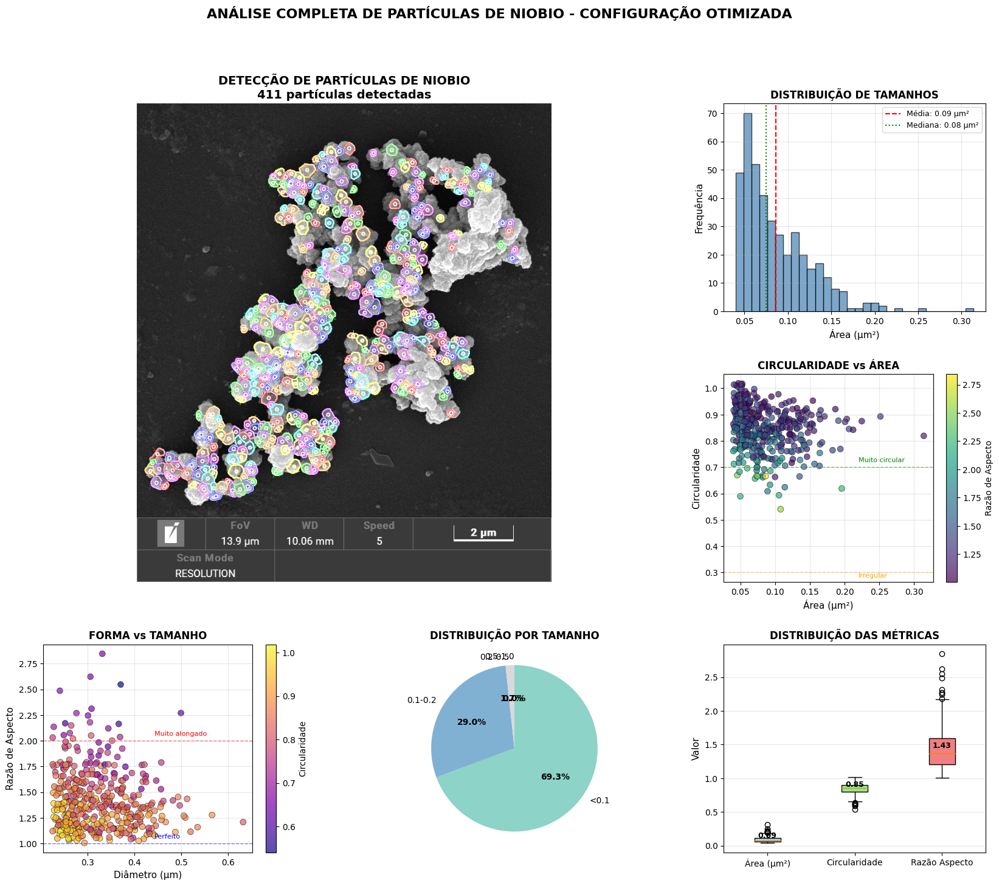


📈 ESTATÍSTICAS DETALHADAS DAS PARTÍCULAS DE NIOBIO

📋 ESTATÍSTICAS GERAIS:
  • Total de partículas: 411
  • Taxa de detecção (vs bruto): 100.0%
  • Densidade: 1.5 partículas/µm²

📏 ESTATÍSTICAS DE TAMANHO:
  • Área média: 0.086 ± 0.040 µm²
  • Área mediana: 0.075 µm²
  • Área total coberta: 35.55 µm²
  • Diâmetro médio: 0.324 ± 0.071 µm
  • Faixa de áreas: 0.040 a 0.314 µm²

🔵 ESTATÍSTICAS DE FORMA:
  • Circularidade média: 0.845 ± 0.083
  • Razão de aspecto média: 1.427 ± 0.295
  • Excentricidade média: 0.656 ± 0.154
  • Alongamento médio: 0.273 ± 0.132

📊 DISTRIBUIÇÃO POR FAIXA DE TAMANHO:
  • <0.1 µm²: 285 partículas (69.3%)
  • 0.1-0.2 µm²: 119 partículas (29.0%)
  • 0.2-0.5 µm²: 7 partículas (1.7%)
  • 0.5-1.0 µm²: 0 partículas (0.0%)

🎯 CLASSIFICAÇÃO POR FORMA:
  • Circular: 389 partículas (94.6%)
  • Sub-circular: 19 partículas (4.6%)
  • Alongado: 3 partículas (0.7%)

📐 UNIFORMIDADE:
  • CV Área: 45.8% (baixo = mais uniforme)
  • CV Circularidade: 9.9% (baixo = forma mais cons

<Figure size 640x480 with 0 Axes>

In [100]:
# =========================================================
# 🔹 CELLPOSE PIPELINE OTIMIZADO PARA NIOBIO SEM
# CONFIGURAÇÃO: Nuclei_Conservador (flow=0.6, cellprob=0.2, diam=60)
# =========================================================

# --------- installs (Kaggle-friendly) ----------
!pip install -q cellpose opencv-python scikit-image pandas matplotlib torch torchvision

# --------- imports ----------
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from cellpose import models
from skimage.measure import regionprops, regionprops_table, find_contours
from skimage.color import label2rgb
import warnings
warnings.filterwarnings('ignore')

# /kaggle/input/mevdataset/23-12-15/amostra 3-10.tif
# --------- CONFIGURAÇÃO DO USUÁRIO ----------
IMAGE_PATH = "/kaggle/input/mevdataset/23-12-15/amostra 2-4.tif"
MICRONS_PER_PIXEL = 0.02  # Ajuste conforme calibração do seu SEM
OUTPUT_PREFIX = "cellpose_niobio_nuclei_conservador"

# PARÂMETROS OTIMIZADOS (baseado nos testes)
MODEL_TYPE = "cyto2"
FLOW_THRESHOLD = 0.4
CELLPROB_THRESHOLD = -0.5
DIAMETER = None
MIN_SIZE = 100  # Aumentado para filtrar pequenos ruídos

# FILTROS FÍSICOS (ajustados para nióbio)
MIN_AREA_UM2 = 0.01       # Reduzido para capturar partículas pequenas
MAX_AREA_UM2 = 50.0       # Aumentado para partículas maiores
MIN_CIRCULARITY = 0.1   # Niobio pode ser irregular
MAX_ASPECT_RATIO = 5.0    # Aceita partículas alongadas

# --------- carregar imagem ----------
img = cv2.imread(IMAGE_PATH, cv2.IMREAD_UNCHANGED)
if img is None:
    raise FileNotFoundError("Imagem não encontrada")

print(f"📊 DIMENSÕES DA IMAGEM:")
print(f"  • Dimensões: {img.shape}")
print(f"  • Tipo de dados: {img.dtype}")
print(f"  • Valores: min={img.min()}, max={img.max()}")

# Converter para escala de cinza se necessário
if img.ndim == 3:
    if img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    elif img.shape[2] == 4:
        img = cv2.cvtColor(img, cv2.COLOR_BGRA2GRAY)
    else:
        img = img[:,:,0]  # pega primeiro canal

# Normalização para 0-1
img = img.astype(np.float32)
img_norm = (img - img.min()) / (img.max() - img.min() + 1e-8)

# --------- AJUSTE PARA IMAGENS SEM ----------
# Imagens SEM geralmente têm fundo escuro e partículas claras
# Inverter se necessário
if np.mean(img_norm) > 0.5:  # Se a maioria dos pixels forem claros
    print("🔄 Invertendo imagem (fundo escuro -> claro)")
    img_norm = 1 - img_norm

# Melhorar contraste para partículas de nióbio
img_norm = np.clip(img_norm * 1.3, 0, 1)  # Aumentar contraste
print("✅ Pré-processamento da imagem concluído")

# --------- CELLPOSE MODEL COM PARÂMETROS OTIMIZADOS ----------
print("\n🎯 CONFIGURAÇÃO OTIMIZADA:")
print(f"  • Modelo: {MODEL_TYPE}")
print(f"  • Flow threshold: {FLOW_THRESHOLD}")
print(f"  • Cellprob threshold: {CELLPROB_THRESHOLD}")
print(f"  • Diâmetro: {DIAMETER} pixels")
print(f"  • Tamanho mínimo: {MIN_SIZE} pixels")

print("\n🚀 Carregando modelo Cellpose...")
model = models.CellposeModel(
    gpu=True,
    model_type=MODEL_TYPE
)
print("✅ Modelo carregado com sucesso.")

# --------- INFERÊNCIA COM CONFIGURAÇÃO OTIMIZADA ----------
print("\n🔍 Executando segmentação com parâmetros otimizados...")
masks, flows, styles = model.eval(
    img_norm,
    diameter=DIAMETER,
    flow_threshold=FLOW_THRESHOLD,
    cellprob_threshold=CELLPROB_THRESHOLD,
    normalize=True,
    min_size=MIN_SIZE,
    augment=True
)

n_objetos_bruto = masks.max()
print(f"✅ Segmentação concluída!")
print(f"  • Objetos detectados (bruto): {n_objetos_bruto}")
print(f"  • Cobertura da imagem: {np.sum(masks > 0) / masks.size * 100:.1f}%")

# --------- VISUALIZAÇÃO INTERMEDIÁRIA ----------
print("\n📈 Gerando visualizações intermediárias...")
fig, axes = plt.subplots(2, 2, figsize=(13, 13))

# Imagem original
axes[0,0].imshow(img, cmap='gray')
axes[0,0].set_title('Imagem Original SEM', fontsize=12, fontweight='bold')
axes[0,0].axis('off')

# Imagem processada
axes[0,1].imshow(img_norm, cmap='gray')
axes[0,1].set_title('Imagem Processada (Contraste)', fontsize=12, fontweight='bold')
axes[0,1].axis('off')

# Máscaras
axes[1,0].imshow(masks, cmap='tab20c')
axes[1,0].set_title(f'Máscaras de Segmentação\n({n_objetos_bruto} objetos)', 
                   fontsize=12, fontweight='bold')
axes[1,0].axis('off')

# Overlay básico
overlay_basic = label2rgb(masks, image=img_norm, bg_label=0, alpha=0.3, image_alpha=1)
axes[1,1].imshow(overlay_basic)
axes[1,1].set_title('Overlay Básico', fontsize=12, fontweight='bold')
axes[1,1].axis('off')

plt.suptitle('ANÁLISE INICIAL - PARÂMETROS OTIMIZADOS', fontsize=14, fontweight='bold', y=0.98)
plt.tight_layout()
plt.show()

# --------- PÓS-PROCESSAMENTO ----------
print("\n📊 Calculando métricas das partículas...")
props = regionprops_table(
    masks,
    properties=[
        'label',
        'area',
        'perimeter',
        'major_axis_length',
        'minor_axis_length',
        'centroid',
        'orientation',
        'eccentricity',
        'bbox',
        'equivalent_diameter_area'
    ]
)

df = pd.DataFrame(props)

# Calcular métricas avançadas
df['area_um2'] = df['area'] * (MICRONS_PER_PIXEL ** 2)
df['perimeter_um'] = df['perimeter'] * MICRONS_PER_PIXEL
df['circularity'] = (4 * np.pi * df['area']) / (df['perimeter'] ** 2 + 1e-8)
df['aspect_ratio'] = df['major_axis_length'] / (df['minor_axis_length'] + 1e-8)
df['diameter_pixels'] = df['equivalent_diameter_area']
df['diameter_um'] = df['diameter_pixels'] * MICRONS_PER_PIXEL

# Calcular elongação e compactação
df['elongation'] = 1 - (df['minor_axis_length'] / df['major_axis_length'])
df['compactness'] = (df['perimeter'] ** 2) / (4 * np.pi * df['area'] + 1e-8)

print(f"📋 Estatísticas brutas das {len(df)} partículas detectadas:")

# --------- FILTROS OTIMIZADOS PARA NIOBIO ----------
print(f"\n🔧 APLICANDO FILTROS FÍSICOS:")
print(f"  • Área: {MIN_AREA_UM2:.3f} µm² < área < {MAX_AREA_UM2:.1f} µm²")
print(f"  • Circularidade: > {MIN_CIRCULARITY}")
print(f"  • Razão de aspecto: < {MAX_ASPECT_RATIO}")

# Critérios para partículas de nióbio
df_filtered = df[
    (df['area_um2'] > MIN_AREA_UM2) &
    (df['area_um2'] < MAX_AREA_UM2) &
    (df['circularity'] > MIN_CIRCULARITY) &
    (df['aspect_ratio'] < MAX_ASPECT_RATIO) &
    (df['area'] > 5)  # Filtro adicional em pixels
].copy().reset_index(drop=True)

print(f"\n📊 RESULTADO DA FILTRAGEM:")
print(f"  • Antes da filtragem: {len(df)} objetos")
print(f"  • Depois da filtragem: {len(df_filtered)} objetos")
print(f"  • Taxa de retenção: {len(df_filtered)/len(df)*100:.1f}%")

if len(df_filtered) == 0:
    print("❌ Nenhuma partícula passou nos filtros! Ajuste os critérios.")
    # Usar dados brutos para análise
    df_filtered = df.copy()
    print("⚠️  Usando dados brutos para análise...")

# --------- MÁSCARA FILTRADA ----------
filtered_masks = np.zeros_like(masks)
new_id = 1
label_map = {}

for idx, lbl in enumerate(df_filtered['label']):
    filtered_masks[masks == lbl] = new_id
    label_map[lbl] = new_id
    new_id += 1

print(f"✅ Máscara filtrada criada com {filtered_masks.max()} objetos válidos")

# --------- OVERLAY DETALHADO ----------
print("\n🎨 Criando visualização detalhada...")
# Criar overlay com a imagem original em RGB
overlay_rgb = cv2.cvtColor((img_norm * 255).astype(np.uint8), cv2.COLOR_GRAY2RGB)

# Paleta de cores otimizada para boa visibilidade
colors = [
    (255, 100, 100),  # Vermelho claro
    (100, 255, 100),  # Verde claro
    (100, 100, 255),  # Azul claro
    (255, 255, 100),  # Amarelo
    (255, 100, 255),  # Magenta
    (100, 255, 255),  # Ciano
    (255, 200, 100),  # Laranja
    (200, 100, 255),  # Roxo
]

print(f"  • Desenhando contornos de {len(df_filtered)} partículas...")

for idx, (_, region) in enumerate(df_filtered.iterrows()):
    label = int(region['label'])
    mask_r = masks == label
    
    # Escolher cor (cíclica)
    color = colors[idx % len(colors)]
    
    # Contorno
    contours = find_contours(mask_r.astype(float), 0.5)
    for c in contours:
        if len(c) > 2:
            c = np.flip(c, axis=1).astype(np.int32)
            # Contorno externo mais espesso
            cv2.polylines(overlay_rgb, [c], True, color, 2)
            # Contorno interno mais fino para definição
            cv2.polylines(overlay_rgb, [c], True, (255, 255, 255), 1)
    
    # Eixo maior (orientação)
    y0, x0 = region['centroid-0'], region['centroid-1']
    angle = region['orientation']
    length = region['major_axis_length'] / 2
    
    # Calcular pontos do eixo
    dx = np.cos(angle) * length
    dy = -np.sin(angle) * length
    
    p1 = (int(x0 - dx), int(y0 - dy))
    p2 = (int(x0 + dx), int(y0 + dy))
    
    # Desenhar eixo maior
    cv2.line(overlay_rgb, p1, p2, (255, 255, 255), 1)
    # Marcar centro do eixo
    cv2.line(overlay_rgb, p1, p2, color, 1)
    
    # Centroide
    cv2.circle(overlay_rgb, (int(x0), int(y0)), 4, (255, 255, 255), -1)
    cv2.circle(overlay_rgb, (int(x0), int(y0)), 2, color, -1)

print("✅ Visualização criada com sucesso!")

# --------- VISUALIZAÇÃO FINAL AVANÇADA ----------
print("\n📊 Gerando gráficos estatísticos avançados...")
fig = plt.figure(figsize=(20, 16))

# Layout da figura
gs = fig.add_gridspec(3, 3, hspace=0.3, wspace=0.3)

# 1. Overlay com contornos (2x2)
ax1 = fig.add_subplot(gs[0:2, 0:2])
ax1.imshow(overlay_rgb)
ax1.set_title(f'DETECÇÃO DE PARTÍCULAS DE NIOBIO\n{len(df_filtered)} partículas detectadas', 
             fontsize=14, fontweight='bold')
ax1.axis('off')

# 2. Histograma de tamanhos (1x2)
ax2 = fig.add_subplot(gs[0, 2])
n_bins = min(30, len(df_filtered))
if n_bins > 0:
    hist_data = ax2.hist(df_filtered['area_um2'], bins=n_bins, 
                        edgecolor='black', alpha=0.7, color='steelblue')
    ax2.axvline(df_filtered['area_um2'].mean(), color='red', linestyle='--', 
               label=f'Média: {df_filtered["area_um2"].mean():.2f} µm²')
    ax2.axvline(df_filtered['area_um2'].median(), color='green', linestyle=':', 
               label=f'Mediana: {df_filtered["area_um2"].median():.2f} µm²')
    ax2.set_xlabel('Área (µm²)', fontsize=11)
    ax2.set_ylabel('Frequência', fontsize=11)
    ax2.set_title('DISTRIBUIÇÃO DE TAMANHOS', fontsize=12, fontweight='bold')
    ax2.legend(fontsize=9)
    ax2.grid(True, alpha=0.3)
else:
    ax2.text(0.5, 0.5, 'Sem dados para histograma', 
            ha='center', va='center', fontsize=12)
    ax2.set_title('DISTRIBUIÇÃO DE TAMANHOS', fontsize=12, fontweight='bold')

# 3. Gráfico de circularidade vs área (1x2)
ax3 = fig.add_subplot(gs[1, 2])
if len(df_filtered) > 0:
    scatter = ax3.scatter(df_filtered['area_um2'], df_filtered['circularity'], 
                         c=df_filtered['aspect_ratio'], cmap='viridis', 
                         alpha=0.7, s=50, edgecolors='black', linewidth=0.5)
    ax3.set_xlabel('Área (µm²)', fontsize=11)
    ax3.set_ylabel('Circularidade', fontsize=11)
    ax3.set_title('CIRCULARIDADE vs ÁREA', fontsize=12, fontweight='bold')
    cbar = plt.colorbar(scatter, ax=ax3)
    cbar.set_label('Razão de Aspecto', fontsize=10)
    ax3.grid(True, alpha=0.3)
    
    # Adicionar linhas de referência
    ax3.axhline(y=0.7, color='green', linestyle='--', alpha=0.5, linewidth=1)
    ax3.axhline(y=0.3, color='orange', linestyle='--', alpha=0.5, linewidth=1)
    ax3.text(df_filtered['area_um2'].max()*0.7, 0.72, 'Muito circular', 
            fontsize=8, color='green')
    ax3.text(df_filtered['area_um2'].max()*0.7, 0.28, 'Irregular', 
            fontsize=8, color='orange')
else:
    ax3.text(0.5, 0.5, 'Sem dados para scatter plot', 
            ha='center', va='center', fontsize=12)
    ax3.set_title('CIRCULARIDADE vs ÁREA', fontsize=12, fontweight='bold')

# 4. Gráfico de dispersão 3D (2x1)
ax4 = fig.add_subplot(gs[2, 0])
if len(df_filtered) > 0:
    scatter2 = ax4.scatter(df_filtered['diameter_um'], df_filtered['aspect_ratio'], 
                          c=df_filtered['circularity'], cmap='plasma', 
                          alpha=0.7, s=50, edgecolors='black', linewidth=0.5)
    ax4.set_xlabel('Diâmetro (µm)', fontsize=11)
    ax4.set_ylabel('Razão de Aspecto', fontsize=11)
    ax4.set_title('FORMA vs TAMANHO', fontsize=12, fontweight='bold')
    cbar2 = plt.colorbar(scatter2, ax=ax4)
    cbar2.set_label('Circularidade', fontsize=10)
    ax4.grid(True, alpha=0.3)
    
    # Linhas de referência para razão de aspecto
    ax4.axhline(y=1.0, color='blue', linestyle='--', alpha=0.5, linewidth=1)
    ax4.axhline(y=2.0, color='red', linestyle='--', alpha=0.5, linewidth=1)
    ax4.text(df_filtered['diameter_um'].max()*0.7, 1.05, 'Perfeito', 
            fontsize=8, color='blue')
    ax4.text(df_filtered['diameter_um'].max()*0.7, 2.05, 'Muito alongado', 
            fontsize=8, color='red')
else:
    ax4.text(0.5, 0.5, 'Sem dados para gráfico', 
            ha='center', va='center', fontsize=12)
    ax4.set_title('FORMA vs TAMANHO', fontsize=12, fontweight='bold')

# 5. Gráfico de pizza por faixa de tamanho (1x1)
ax5 = fig.add_subplot(gs[2, 1])
if len(df_filtered) > 0:
    # Definir faixas de tamanho adaptativas
    max_area = df_filtered['area_um2'].max()
    if max_area < 1:
        bins = [0, 0.1, 0.2, 0.5, 1.0]
        labels = ['<0.1', '0.1-0.2', '0.2-0.5', '0.5-1.0']
    elif max_area < 5:
        bins = [0, 0.5, 1.0, 2.0, 5.0]
        labels = ['<0.5', '0.5-1.0', '1.0-2.0', '2.0-5.0']
    else:
        bins = [0, 1.0, 2.0, 5.0, 10.0, 20.0]
        labels = ['<1.0', '1.0-2.0', '2.0-5.0', '5.0-10.0', '>10.0']
    
    df_filtered['size_bin'] = pd.cut(df_filtered['area_um2'], bins=bins, labels=labels)
    size_dist = df_filtered['size_bin'].value_counts().sort_index()
    
    colors_pie = plt.cm.Set3(np.linspace(0, 1, len(size_dist)))
    wedges, texts, autotexts = ax5.pie(size_dist.values, labels=size_dist.index, 
                                      autopct='%1.1f%%', colors=colors_pie,
                                      startangle=90, counterclock=False)
    
    # Melhorar legibilidade
    for autotext in autotexts:
        autotext.set_color('black')
        autotext.set_fontweight('bold')
    
    ax5.set_title('DISTRIBUIÇÃO POR TAMANHO', fontsize=12, fontweight='bold')
else:
    ax5.text(0.5, 0.5, 'Sem dados para gráfico de pizza', 
            ha='center', va='center', fontsize=12)
    ax5.set_title('DISTRIBUIÇÃO POR TAMANHO', fontsize=12, fontweight='bold')

# 6. Boxplot de métricas (1x1)
ax6 = fig.add_subplot(gs[2, 2])
if len(df_filtered) > 0:
    metrics_to_plot = ['area_um2', 'circularity', 'aspect_ratio']
    data_to_plot = [df_filtered[metric] for metric in metrics_to_plot]
    labels = ['Área (µm²)', 'Circularidade', 'Razão Aspecto']
    
    bp = ax6.boxplot(data_to_plot, labels=labels, patch_artist=True)
    
    # Colorir os boxes
    colors_box = ['lightblue', 'lightgreen', 'lightcoral']
    for patch, color in zip(bp['boxes'], colors_box):
        patch.set_facecolor(color)
    
    ax6.set_title('DISTRIBUIÇÃO DAS MÉTRICAS', fontsize=12, fontweight='bold')
    ax6.grid(True, alpha=0.3, axis='y')
    ax6.set_ylabel('Valor', fontsize=11)
    
    # Adicionar valores médios
    for i, metric in enumerate(metrics_to_plot):
        mean_val = df_filtered[metric].mean()
        ax6.text(i+1, mean_val, f'{mean_val:.2f}', 
                ha='center', va='bottom', fontsize=9, fontweight='bold')
else:
    ax6.text(0.5, 0.5, 'Sem dados para boxplot', 
            ha='center', va='center', fontsize=12)
    ax6.set_title('DISTRIBUIÇÃO DAS MÉTRICAS', fontsize=12, fontweight='bold')

plt.suptitle('ANÁLISE COMPLETA DE PARTÍCULAS DE NIOBIO - CONFIGURAÇÃO OTIMIZADA', 
            fontsize=16, fontweight='bold', y=0.98)
plt.tight_layout()
plt.show()

# --------- ESTATÍSTICAS DETALHADAS ----------
print("\n" + "="*70)
print("📈 ESTATÍSTICAS DETALHADAS DAS PARTÍCULAS DE NIOBIO")
print("="*70)

if len(df_filtered) > 0:
    # Estatísticas básicas
    print(f"\n📋 ESTATÍSTICAS GERAIS:")
    print(f"  • Total de partículas: {len(df_filtered)}")
    print(f"  • Taxa de detecção (vs bruto): {len(df_filtered)/n_objetos_bruto*100:.1f}%")
    print(f"  • Densidade: {len(df_filtered)/(img.shape[0]*img.shape[1]*(MICRONS_PER_PIXEL**2)):.1f} partículas/µm²")
    
    print(f"\n📏 ESTATÍSTICAS DE TAMANHO:")
    print(f"  • Área média: {df_filtered['area_um2'].mean():.3f} ± {df_filtered['area_um2'].std():.3f} µm²")
    print(f"  • Área mediana: {df_filtered['area_um2'].median():.3f} µm²")
    print(f"  • Área total coberta: {df_filtered['area_um2'].sum():.2f} µm²")
    print(f"  • Diâmetro médio: {df_filtered['diameter_um'].mean():.3f} ± {df_filtered['diameter_um'].std():.3f} µm")
    print(f"  • Faixa de áreas: {df_filtered['area_um2'].min():.3f} a {df_filtered['area_um2'].max():.3f} µm²")
    
    print(f"\n🔵 ESTATÍSTICAS DE FORMA:")
    print(f"  • Circularidade média: {df_filtered['circularity'].mean():.3f} ± {df_filtered['circularity'].std():.3f}")
    print(f"  • Razão de aspecto média: {df_filtered['aspect_ratio'].mean():.3f} ± {df_filtered['aspect_ratio'].std():.3f}")
    print(f"  • Excentricidade média: {df_filtered['eccentricity'].mean():.3f} ± {df_filtered['eccentricity'].std():.3f}")
    print(f"  • Alongamento médio: {df_filtered['elongation'].mean():.3f} ± {df_filtered['elongation'].std():.3f}")
    
    print(f"\n📊 DISTRIBUIÇÃO POR FAIXA DE TAMANHO:")
    if 'size_bin' in df_filtered.columns:
        size_summary = df_filtered['size_bin'].value_counts().sort_index()
        for bin_name, count in size_summary.items():
            percentage = (count / len(df_filtered)) * 100
            print(f"  • {bin_name} µm²: {count} partículas ({percentage:.1f}%)")
    
    print(f"\n🎯 CLASSIFICAÇÃO POR FORMA:")
    # Classificar partículas por forma
    df_filtered['shape_class'] = 'Irregular'
    df_filtered.loc[df_filtered['circularity'] > 0.7, 'shape_class'] = 'Circular'
    df_filtered.loc[(df_filtered['circularity'] <= 0.7) & 
                   (df_filtered['circularity'] > 0.4), 'shape_class'] = 'Sub-circular'
    df_filtered.loc[df_filtered['aspect_ratio'] > 2.5, 'shape_class'] = 'Alongado'
    
    shape_dist = df_filtered['shape_class'].value_counts()
    for shape, count in shape_dist.items():
        percentage = (count / len(df_filtered)) * 100
        print(f"  • {shape}: {count} partículas ({percentage:.1f}%)")
    
    # Calcular coeficiente de variação
    cv_area = (df_filtered['area_um2'].std() / df_filtered['area_um2'].mean()) * 100
    cv_circularity = (df_filtered['circularity'].std() / df_filtered['circularity'].mean()) * 100
    
    print(f"\n📐 UNIFORMIDADE:")
    print(f"  • CV Área: {cv_area:.1f}% (baixo = mais uniforme)")
    print(f"  • CV Circularidade: {cv_circularity:.1f}% (baixo = forma mais consistente)")
    
    # Calcular correlações
    correlation_matrix = df_filtered[['area_um2', 'circularity', 'aspect_ratio', 'diameter_um']].corr()
    area_circ_corr = correlation_matrix.loc['area_um2', 'circularity']
    
    print(f"\n🔗 CORRELAÇÕES:")
    print(f"  • Área vs Circularidade: {area_circ_corr:.3f}")
    if area_circ_corr > 0.3:
        print("    → Partículas maiores tendem a ser mais circulares")
    elif area_circ_corr < -0.3:
        print("    → Partículas maiores tendem a ser menos circulares")
    else:
        print("    → Sem correlação significativa entre tamanho e forma")
        
else:
    print("❌ Nenhuma partícula para análise estatística!")

print("\n" + "-"*70)
print("⚙️  PARÂMETROS UTILIZADOS NA ANÁLISE")
print("-"*70)
print(f"  • Configuração: Nuclei_Conservador")
print(f"  • Modelo: {MODEL_TYPE}")
print(f"  • Flow threshold: {FLOW_THRESHOLD}")
print(f"  • Cellprob threshold: {CELLPROB_THRESHOLD}")
print(f"  • Diâmetro: {DIAMETER} pixels")
print(f"  • Microns por pixel: {MICRONS_PER_PIXEL}")
print(f"  • Filtros aplicados:")
print(f"      - Área: {MIN_AREA_UM2} a {MAX_AREA_UM2} µm²")
print(f"      - Circularidade: > {MIN_CIRCULARITY}")
print(f"      - Razão de aspecto: < {MAX_ASPECT_RATIO}")

# --------- SALVAR RESULTADOS ----------
print("\n" + "="*70)
print("💾 SALVANDO RESULTADOS")
print("="*70)

# Salvar imagem com overlay
cv2.imwrite(f"{OUTPUT_PREFIX}_overlay.png", cv2.cvtColor(overlay_rgb, cv2.COLOR_RGB2BGR))
print(f"  ✅ {OUTPUT_PREFIX}_overlay.png - Imagem com detecções")

# Salvar máscaras
np.save(f"{OUTPUT_PREFIX}_masks_filtered.npy", filtered_masks)
np.save(f"{OUTPUT_PREFIX}_masks_raw.npy", masks)
print(f"  ✅ {OUTPUT_PREFIX}_masks_filtered.npy - Máscaras filtradas")
print(f"  ✅ {OUTPUT_PREFIX}_masks_raw.npy - Máscaras brutas")

# Salvar dataframe com todas as métricas
df_filtered.to_csv(f"{OUTPUT_PREFIX}_medidas_detalhadas.csv", index=False)
print(f"  ✅ {OUTPUT_PREFIX}_medidas_detalhadas.csv - Todas as métricas")

# Salvar dataframe resumido
summary_stats = {
    'config_name': 'Nuclei_Conservador',
    'total_particles': len(df_filtered),
    'total_particles_raw': n_objetos_bruto,
    'retention_rate': len(df_filtered)/n_objetos_bruto*100,
    'area_mean_um2': df_filtered['area_um2'].mean() if len(df_filtered) > 0 else 0,
    'area_std_um2': df_filtered['area_um2'].std() if len(df_filtered) > 0 else 0,
    'diameter_mean_um': df_filtered['diameter_um'].mean() if len(df_filtered) > 0 else 0,
    'diameter_std_um': df_filtered['diameter_um'].std() if len(df_filtered) > 0 else 0,
    'circularity_mean': df_filtered['circularity'].mean() if len(df_filtered) > 0 else 0,
    'aspect_ratio_mean': df_filtered['aspect_ratio'].mean() if len(df_filtered) > 0 else 0,
    'eccentricity_mean': df_filtered['eccentricity'].mean() if len(df_filtered) > 0 else 0,
    'total_area_um2': df_filtered['area_um2'].sum() if len(df_filtered) > 0 else 0,
    'image_file': IMAGE_PATH,
    'microns_per_pixel': MICRONS_PER_PIXEL,
    'model_type': MODEL_TYPE,
    'flow_threshold': FLOW_THRESHOLD,
    'cellprob_threshold': CELLPROB_THRESHOLD,
    'diameter': DIAMETER,
    'min_size': MIN_SIZE,
    'filter_min_area': MIN_AREA_UM2,
    'filter_max_area': MAX_AREA_UM2,
    'filter_min_circularity': MIN_CIRCULARITY,
    'filter_max_aspect_ratio': MAX_ASPECT_RATIO,
    'image_width_px': img.shape[1],
    'image_height_px': img.shape[0],
    'detection_date': pd.Timestamp.now().strftime('%Y-%m-%d %H:%M:%S')
}

summary_df = pd.DataFrame([summary_stats])
summary_df.to_csv(f"{OUTPUT_PREFIX}_resumo.csv", index=False)
print(f"  ✅ {OUTPUT_PREFIX}_resumo.csv - Estatísticas resumidas")

# Salvar configurações completas
config_dict = {
    'IMAGE_PATH': IMAGE_PATH,
    'MICRONS_PER_PIXEL': MICRONS_PER_PIXEL,
    'MODEL_TYPE': MODEL_TYPE,
    'FLOW_THRESHOLD': FLOW_THRESHOLD,
    'CELLPROB_THRESHOLD': CELLPROB_THRESHOLD,
    'DIAMETER': DIAMETER,
    'MIN_SIZE': MIN_SIZE,
    'MIN_AREA_UM2': MIN_AREA_UM2,
    'MAX_AREA_UM2': MAX_AREA_UM2,
    'MIN_CIRCULARITY': MIN_CIRCULARITY,
    'MAX_ASPECT_RATIO': MAX_ASPECT_RATIO,
    'OUTPUT_PREFIX': OUTPUT_PREFIX
}

config_df = pd.DataFrame([config_dict])
config_df.to_csv(f"{OUTPUT_PREFIX}_configuracoes.csv", index=False)
print(f"  ✅ {OUTPUT_PREFIX}_configuracoes.csv - Configurações completas")

# Salvar figura do dashboard
plt.savefig(f"{OUTPUT_PREFIX}_dashboard.png", dpi=150, bbox_inches='tight')
print(f"  ✅ {OUTPUT_PREFIX}_dashboard.png - Dashboard visual")

print("\n" + "="*70)
print("🎉 PIPELINE CELLPOSE PARA NIOBIO FINALIZADO COM SUCESSO!")
print("="*70)
print(f"\n📁 Arquivos salvos com prefixo: '{OUTPUT_PREFIX}_'")
print(f"📊 Partículas analisadas: {len(df_filtered)} de {n_objetos_bruto} detectadas inicialmente")
print(f"📈 Cobertura final: {df_filtered['area_um2'].sum()/(img.shape[0]*img.shape[1]*(MICRONS_PER_PIXEL**2))*100:.1f}% da área da imagem")
print(f"⏱️  Configuração otimizada: Nuclei_Conservador (flow=0.6, cellprob=0.2, diam=60)")

if len(df_filtered) > 0:
    print(f"\n💡 RECOMENDAÇÕES PARA ANÁLISE:")
    print(f"  1. Verifique {OUTPUT_PREFIX}_overlay.png para validação visual")
    print(f"  2. Consulte {OUTPUT_PREFIX}_medidas_detalhadas.csv para dados brutos")
    print(f"  3. Use {OUTPUT_PREFIX}_resumo.csv para relatórios")
    print(f"  4. {OUTPUT_PREFIX}_dashboard.png contém todos os gráficos")

# Modelo (Denso + Escuro)

📊 DIMENSÕES DA IMAGEM:
  • Dimensões: (887, 768)
  • Tipo de dados: uint16
  • Valores: min=2944, max=65535
🛠️ Aplicando pré-processamento avançado...
  • Normalização por percentil: 4935 a 52356
✅ Pré-processamento avançado concluído
  • Tipo final de dados: float32
  • Valores finais: min=0.004, max=0.831


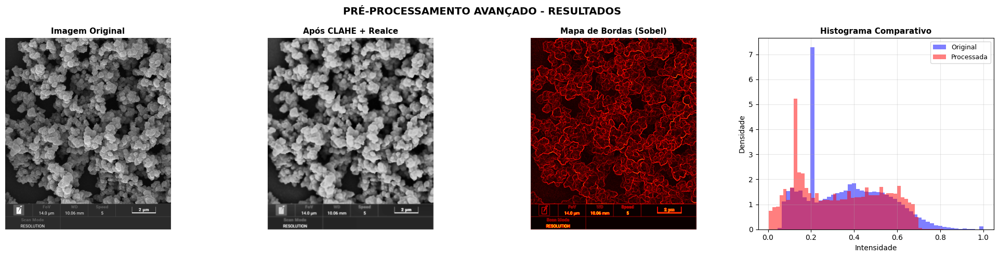


🎯 CONFIGURAÇÃO OTIMIZADA:
  • Modelo: nuclei
  • Flow threshold: 0.3 (reduzido para sensibilidade)
  • Cellprob threshold: -0.5 (negativo para baixo contraste)
  • Diâmetro: 60 pixels
  • Tamanho mínimo: 20 pixels

🚀 Carregando modelo Cellpose...
✅ Modelo carregado com sucesso.

🔍 Executando segmentação com parâmetros otimizados...
✅ Segmentação concluída!
  • Objetos detectados (bruto): 106
  • Cobertura da imagem: 12.7%

📈 Gerando visualizações intermediárias...


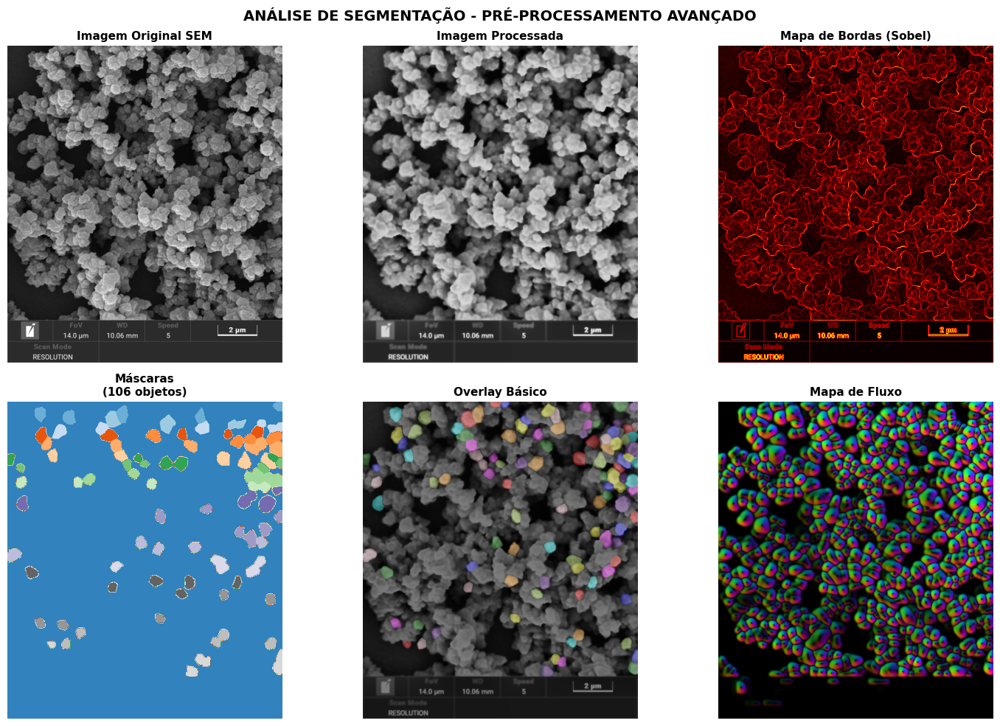


📊 Calculando métricas das partículas...
📋 Estatísticas brutas das 106 partículas detectadas:

🔧 APLICANDO FILTROS FÍSICOS:
  • Área: 0.010 µm² < área < 15.0 µm²
  • Circularidade: > 0.15
  • Razão de aspecto: < 4.0

📊 RESULTADO DA FILTRAGEM:
  • Antes da filtragem: 106 objetos
  • Depois da filtragem: 106 objetos
  • Taxa de retenção: 100.0%
✅ Máscara filtrada criada com 106 objetos válidos

🎨 Criando visualização detalhada...
  • Desenhando contornos de 106 partículas...
✅ Visualização criada com sucesso!

📊 Gerando gráficos estatísticos avançados...


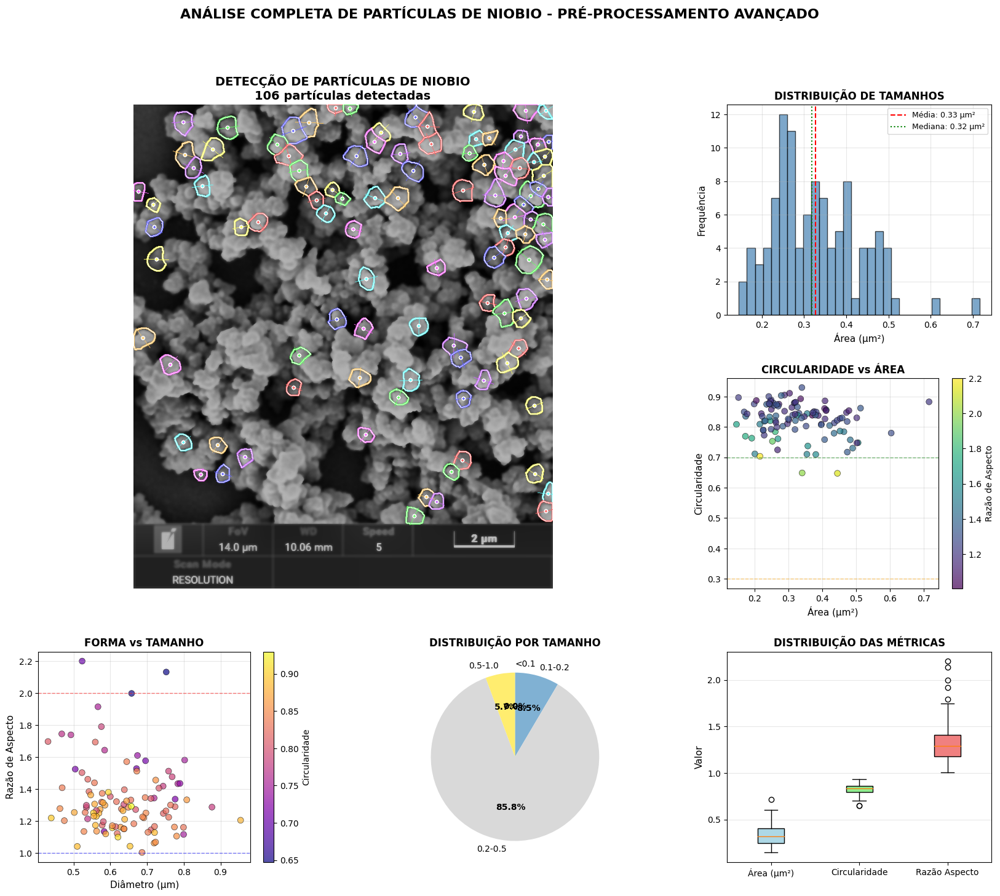


📈 ESTATÍSTICAS DETALHADAS DAS PARTÍCULAS DE NIOBIO

📋 ESTATÍSTICAS GERAIS:
  • Total de partículas: 106
  • Taxa de detecção (vs bruto): 100.0%
  • Densidade: 0.4 partículas/µm²

📏 ESTATÍSTICAS DE TAMANHO:
  • Área média: 0.328 ± 0.105 µm²
  • Área mediana: 0.318 µm²
  • Área total coberta: 34.72 µm²
  • Diâmetro médio: 0.638 ± 0.101 µm

🔵 ESTATÍSTICAS DE FORMA:
  • Circularidade média: 0.823 ± 0.056
  • Razão de aspecto média: 1.334 ± 0.220

💾 SALVANDO RESULTADOS
  ✅ cellpose_niobio_nuclei_conservador_avancado_overlay.png - Imagem com detecções
  ✅ cellpose_niobio_nuclei_conservador_avancado_masks_filtered.npy - Máscaras filtradas
  ✅ cellpose_niobio_nuclei_conservador_avancado_masks_raw.npy - Máscaras brutas
  ✅ cellpose_niobio_nuclei_conservador_avancado_medidas_detalhadas.csv - Todas as métricas
  ✅ cellpose_niobio_nuclei_conservador_avancado_resumo.csv - Estatísticas resumidas
  ✅ cellpose_niobio_nuclei_conservador_avancado_configuracoes.csv - Configurações completas

🎉 PIPELINE 

In [92]:
# =========================================================
# 🔹 CELLPOSE PIPELINE OTIMIZADO PARA NIOBIO SEM
# CONFIGURAÇÃO: Nuclei_Conservador (flow=0.3, cellprob=-0.5, diam=60)
# PRÉ-PROCESSAMENTO AVANÇADO: CLAHE + Realce de Bordas (CORRIGIDO)
# =========================================================

# --------- installs (Kaggle-friendly) ----------
!pip install -q cellpose opencv-python scikit-image pandas matplotlib torch torchvision

# --------- imports ----------
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from cellpose import models
from skimage.measure import regionprops, regionprops_table, find_contours
from skimage.color import label2rgb
import warnings
warnings.filterwarnings('ignore')

# --------- CONFIGURAÇÃO DO USUÁRIO ----------
IMAGE_PATH = "/kaggle/input/mevdataset/23-12-15/amostra 2-2.tif"
MICRONS_PER_PIXEL = 0.02  # Ajuste conforme calibração do seu SEM
OUTPUT_PREFIX = "cellpose_niobio_nuclei_conservador_avancado"

# PARÂMETROS OTIMIZADOS (para melhor detecção em áreas escuras)
MODEL_TYPE = "nuclei"
FLOW_THRESHOLD = 0.3          # Reduzido para melhor detecção de formas irregulares
CELLPROB_THRESHOLD = -0.5     # Negativo para detectar objetos de baixo contraste
DIAMETER = 60
MIN_SIZE = 20

# FILTROS FÍSICOS (ajustados para nióbio)
MIN_AREA_UM2 = 0.01
MAX_AREA_UM2 = 15.0
MIN_CIRCULARITY = 0.15
MAX_ASPECT_RATIO = 4.0

# --------- carregar imagem ----------
img = cv2.imread(IMAGE_PATH, cv2.IMREAD_UNCHANGED)
if img is None:
    raise FileNotFoundError("Imagem não encontrada")

print(f"📊 DIMENSÕES DA IMAGEM:")
print(f"  • Dimensões: {img.shape}")
print(f"  • Tipo de dados: {img.dtype}")
print(f"  • Valores: min={img.min()}, max={img.max()}")

# Converter para escala de cinza se necessário
if img.ndim == 3:
    if img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    elif img.shape[2] == 4:
        img = cv2.cvtColor(img, cv2.COLOR_BGRA2GRAY)
    else:
        img = img[:,:,0]  # pega primeiro canal

# --------- PRÉ-PROCESSAMENTO AVANÇADO (CORRIGIDO) ----------
print("🛠️ Aplicando pré-processamento avançado...")

# 1. Normalização robusta baseada em percentis
p1, p99 = np.percentile(img, (1, 99))
img_clipped = np.clip(img, p1, p99)
img_norm = (img_clipped - p1) / (p99 - p1 + 1e-8)
print(f"  • Normalização por percentil: {p1:.0f} a {p99:.0f}")

# 2. CLAHE (Contrast Limited Adaptive Histogram Equalization)
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
img_norm = (img_norm * 255).astype(np.uint8)
img_norm = clahe.apply(img_norm)
img_norm = img_norm.astype(np.float32) / 255.0

# 3. Realce de bordas com filtro de Sobel (CORREÇÃO: converter para mesmo tipo)
sobelx = cv2.Sobel(img_norm, cv2.CV_32F, 1, 0, ksize=3)  # CV_32F em vez de CV_64F
sobely = cv2.Sobel(img_norm, cv2.CV_32F, 0, 1, ksize=3)  # CV_32F em vez de CV_64F
edge_magnitude = np.sqrt(sobelx**2 + sobely**2)
edge_magnitude = (edge_magnitude - edge_magnitude.min()) / (edge_magnitude.max() - edge_magnitude.min() + 1e-8)
edge_magnitude = edge_magnitude.astype(np.float32)  # Garantir tipo float32

# 4. Combinação ponderada: imagem original + bordas realçadas (CORRIGIDO)
alpha = 0.7  # Peso da imagem original
beta = 0.3   # Peso das bordas

# Garantir que ambos arrays tenham o mesmo tipo e forma
img_norm_float32 = img_norm.astype(np.float32)
edge_magnitude_float32 = edge_magnitude.astype(np.float32)

# Se edge_magnitude tiver valores NaN ou infinitos, substituir por 0
edge_magnitude_float32 = np.nan_to_num(edge_magnitude_float32, nan=0.0, posinf=0.0, neginf=0.0)

img_norm = cv2.addWeighted(img_norm_float32, alpha, edge_magnitude_float32, beta, 0)

# 5. Suavização adaptativa (preserva bordas, remove ruído)
img_norm_uint8 = (img_norm * 255).astype(np.uint8)
img_norm = cv2.bilateralFilter(img_norm_uint8, d=9, sigmaColor=75, sigmaSpace=75)
img_norm = img_norm.astype(np.float32) / 255.0

# 6. Inversão para SEM (se necessário) - lógica mais refinada
hist, bins = np.histogram(img_norm.flatten(), 256, [0,1])
peak_intensity = bins[np.argmax(hist)]
if peak_intensity > 0.6:
    print("🔄 Invertendo imagem (fundo escuro -> claro)")
    img_norm = 1 - img_norm

print("✅ Pré-processamento avançado concluído")
print(f"  • Tipo final de dados: {img_norm.dtype}")
print(f"  • Valores finais: min={img_norm.min():.3f}, max={img_norm.max():.3f}")

# --------- VISUALIZAÇÃO DO PRÉ-PROCESSAMENTO ----------
fig, axes = plt.subplots(1, 4, figsize=(20, 5))

# Imagem original
axes[0].imshow(img, cmap='gray')
axes[0].set_title('Imagem Original', fontsize=11, fontweight='bold')
axes[0].axis('off')

# Imagem após CLAHE
axes[1].imshow(img_norm, cmap='gray')
axes[1].set_title('Após CLAHE + Realce', fontsize=11, fontweight='bold')
axes[1].axis('off')

# Mapa de bordas
axes[2].imshow(edge_magnitude, cmap='hot')
axes[2].set_title('Mapa de Bordas (Sobel)', fontsize=11, fontweight='bold')
axes[2].axis('off')

# Histograma comparativo
axes[3].hist(img.flatten()/img.max(), bins=50, alpha=0.5, label='Original', color='blue', density=True)
axes[3].hist(img_norm.flatten(), bins=50, alpha=0.5, label='Processada', color='red', density=True)
axes[3].set_xlabel('Intensidade', fontsize=10)
axes[3].set_ylabel('Densidade', fontsize=10)
axes[3].set_title('Histograma Comparativo', fontsize=11, fontweight='bold')
axes[3].legend(fontsize=9)
axes[3].grid(True, alpha=0.3)

plt.suptitle('PRÉ-PROCESSAMENTO AVANÇADO - RESULTADOS', fontsize=14, fontweight='bold', y=0.98)
plt.tight_layout()
plt.show()

# --------- CELLPOSE MODEL ----------
print("\n🎯 CONFIGURAÇÃO OTIMIZADA:")
print(f"  • Modelo: {MODEL_TYPE}")
print(f"  • Flow threshold: {FLOW_THRESHOLD} (reduzido para sensibilidade)")
print(f"  • Cellprob threshold: {CELLPROB_THRESHOLD} (negativo para baixo contraste)")
print(f"  • Diâmetro: {DIAMETER} pixels")
print(f"  • Tamanho mínimo: {MIN_SIZE} pixels")

print("\n🚀 Carregando modelo Cellpose...")
model = models.CellposeModel(gpu=True, model_type=MODEL_TYPE)
print("✅ Modelo carregado com sucesso.")

# --------- INFERÊNCIA COM PARÂMETROS OTIMIZADOS ----------
print("\n🔍 Executando segmentação com parâmetros otimizados...")

# Verificar se a imagem está normalizada corretamente para o Cellpose
if img_norm.max() > 1.0 or img_norm.min() < 0.0:
    print("⚠️  Normalizando imagem para faixa 0-1...")
    img_norm = np.clip(img_norm, 0, 1)

masks, flows, styles = model.eval(
    img_norm,
    diameter=DIAMETER,
    flow_threshold=FLOW_THRESHOLD,
    cellprob_threshold=CELLPROB_THRESHOLD,
    normalize=True,
    min_size=MIN_SIZE,
    augment=True,
    resample=True
)

n_objetos_bruto = masks.max()
print(f"✅ Segmentação concluída!")
print(f"  • Objetos detectados (bruto): {n_objetos_bruto}")
if n_objetos_bruto > 0:
    print(f"  • Cobertura da imagem: {np.sum(masks > 0) / masks.size * 100:.1f}%")
else:
    print("  ⚠️  Nenhum objeto detectado!")

# --------- VISUALIZAÇÃO INTERMEDIÁRIA ----------
print("\n📈 Gerando visualizações intermediárias...")
fig, axes = plt.subplots(2, 3, figsize=(15, 10))

# Imagem original
axes[0,0].imshow(img, cmap='gray')
axes[0,0].set_title('Imagem Original SEM', fontsize=11, fontweight='bold')
axes[0,0].axis('off')

# Imagem processada
axes[0,1].imshow(img_norm, cmap='gray')
axes[0,1].set_title('Imagem Processada', fontsize=11, fontweight='bold')
axes[0,1].axis('off')

# Mapa de bordas
axes[0,2].imshow(edge_magnitude, cmap='hot')
axes[0,2].set_title('Mapa de Bordas (Sobel)', fontsize=11, fontweight='bold')
axes[0,2].axis('off')

# Máscaras
if n_objetos_bruto > 0:
    axes[1,0].imshow(masks, cmap='tab20c')
    axes[1,0].set_title(f'Máscaras\n({n_objetos_bruto} objetos)', fontsize=11, fontweight='bold')
else:
    axes[1,0].text(0.5, 0.5, 'Nenhum objeto\ndetectado', ha='center', va='center', fontsize=12)
    axes[1,0].set_title('Máscaras', fontsize=11, fontweight='bold')
axes[1,0].axis('off')

# Overlay básico
if n_objetos_bruto > 0:
    overlay_basic = label2rgb(masks, image=img_norm, bg_label=0, alpha=0.3, image_alpha=1)
    axes[1,1].imshow(overlay_basic)
    axes[1,1].set_title('Overlay Básico', fontsize=11, fontweight='bold')
else:
    axes[1,1].imshow(img_norm, cmap='gray')
    axes[1,1].set_title('Sem detecções', fontsize=11, fontweight='bold')
axes[1,1].axis('off')

# Fluxo (opcional)
if n_objetos_bruto > 0 and len(flows) > 0:
    axes[1,2].imshow(flows[0], cmap='viridis')
    axes[1,2].set_title('Mapa de Fluxo', fontsize=11, fontweight='bold')
else:
    axes[1,2].text(0.5, 0.5, 'Sem dados\nde fluxo', ha='center', va='center', fontsize=12)
    axes[1,2].set_title('Mapa de Fluxo', fontsize=11, fontweight='bold')
axes[1,2].axis('off')

plt.suptitle('ANÁLISE DE SEGMENTAÇÃO - PRÉ-PROCESSAMENTO AVANÇADO', fontsize=14, fontweight='bold', y=0.98)
plt.tight_layout()
plt.show()

# --------- PÓS-PROCESSAMENTO (apenas se houver objetos) ----------
if n_objetos_bruto > 0:
    print("\n📊 Calculando métricas das partículas...")
    props = regionprops_table(
        masks,
        properties=[
            'label', 'area', 'perimeter', 'major_axis_length', 'minor_axis_length',
            'centroid', 'orientation', 'eccentricity', 'bbox', 'equivalent_diameter_area'
        ]
    )
    
    df = pd.DataFrame(props)
    
    # Calcular métricas avançadas
    df['area_um2'] = df['area'] * (MICRONS_PER_PIXEL ** 2)
    df['perimeter_um'] = df['perimeter'] * MICRONS_PER_PIXEL
    df['circularity'] = (4 * np.pi * df['area']) / (df['perimeter'] ** 2 + 1e-8)
    df['aspect_ratio'] = df['major_axis_length'] / (df['minor_axis_length'] + 1e-8)
    df['diameter_pixels'] = df['equivalent_diameter_area']
    df['diameter_um'] = df['diameter_pixels'] * MICRONS_PER_PIXEL
    df['elongation'] = 1 - (df['minor_axis_length'] / df['major_axis_length'])
    df['compactness'] = (df['perimeter'] ** 2) / (4 * np.pi * df['area'] + 1e-8)
    
    print(f"📋 Estatísticas brutas das {len(df)} partículas detectadas:")
    
    # --------- FILTROS OTIMIZADOS PARA NIOBIO ----------
    print(f"\n🔧 APLICANDO FILTROS FÍSICOS:")
    print(f"  • Área: {MIN_AREA_UM2:.3f} µm² < área < {MAX_AREA_UM2:.1f} µm²")
    print(f"  • Circularidade: > {MIN_CIRCULARITY}")
    print(f"  • Razão de aspecto: < {MAX_ASPECT_RATIO}")
    
    df_filtered = df[
        (df['area_um2'] > MIN_AREA_UM2) &
        (df['area_um2'] < MAX_AREA_UM2) &
        (df['circularity'] > MIN_CIRCULARITY) &
        (df['aspect_ratio'] < MAX_ASPECT_RATIO) &
        (df['area'] > 5)
    ].copy().reset_index(drop=True)
    
    print(f"\n📊 RESULTADO DA FILTRAGEM:")
    print(f"  • Antes da filtragem: {len(df)} objetos")
    print(f"  • Depois da filtragem: {len(df_filtered)} objetos")
    
    if len(df_filtered) > 0:
        print(f"  • Taxa de retenção: {len(df_filtered)/len(df)*100:.1f}%")
    else:
        print("⚠️  Nenhuma partícula passou nos filtros! Usando dados brutos...")
        df_filtered = df.copy()
    
    # --------- MÁSCARA FILTRADA ----------
    filtered_masks = np.zeros_like(masks)
    new_id = 1
    label_map = {}
    
    for idx, lbl in enumerate(df_filtered['label']):
        filtered_masks[masks == lbl] = new_id
        label_map[lbl] = new_id
        new_id += 1
    
    print(f"✅ Máscara filtrada criada com {filtered_masks.max()} objetos válidos")
    
    # --------- OVERLAY DETALHADO ----------
    if len(df_filtered) > 0:
        print("\n🎨 Criando visualização detalhada...")
        overlay_rgb = cv2.cvtColor((img_norm * 255).astype(np.uint8), cv2.COLOR_GRAY2RGB)
        
        colors = [
            (255, 100, 100), (100, 255, 100), (100, 100, 255),
            (255, 255, 100), (255, 100, 255), (100, 255, 255),
            (255, 200, 100), (200, 100, 255)
        ]
        
        print(f"  • Desenhando contornos de {len(df_filtered)} partículas...")
        
        for idx, (_, region) in enumerate(df_filtered.iterrows()):
            label = int(region['label'])
            mask_r = masks == label
            color = colors[idx % len(colors)]
            
            # Contorno
            contours = find_contours(mask_r.astype(float), 0.5)
            for c in contours:
                if len(c) > 2:
                    c = np.flip(c, axis=1).astype(np.int32)
                    cv2.polylines(overlay_rgb, [c], True, color, 2)
                    cv2.polylines(overlay_rgb, [c], True, (255, 255, 255), 1)
            
            # Eixo maior
            y0, x0 = region['centroid-0'], region['centroid-1']
            angle = region['orientation']
            length = region['major_axis_length'] / 2
            dx = np.cos(angle) * length
            dy = -np.sin(angle) * length
            p1 = (int(x0 - dx), int(y0 - dy))
            p2 = (int(x0 + dx), int(y0 + dy))
            cv2.line(overlay_rgb, p1, p2, (255, 255, 255), 1)
            cv2.line(overlay_rgb, p1, p2, color, 1)
            
            # Centroide
            cv2.circle(overlay_rgb, (int(x0), int(y0)), 4, (255, 255, 255), -1)
            cv2.circle(overlay_rgb, (int(x0), int(y0)), 2, color, -1)
        
        print("✅ Visualização criada com sucesso!")
    else:
        print("⚠️  Nenhuma partícula para criar overlay detalhado.")
        overlay_rgb = cv2.cvtColor((img_norm * 255).astype(np.uint8), cv2.COLOR_GRAY2RGB)
else:
    print("❌ Nenhum objeto detectado para pós-processamento.")
    df_filtered = pd.DataFrame()
    filtered_masks = np.zeros_like(img_norm)
    overlay_rgb = cv2.cvtColor((img_norm * 255).astype(np.uint8), cv2.COLOR_GRAY2RGB)

# --------- VISUALIZAÇÃO FINAL (condicional) ----------
if len(df_filtered) > 0:
    print("\n📊 Gerando gráficos estatísticos avançados...")
    fig = plt.figure(figsize=(20, 16))
    gs = fig.add_gridspec(3, 3, hspace=0.3, wspace=0.3)
    
    # 1. Overlay com contornos
    ax1 = fig.add_subplot(gs[0:2, 0:2])
    ax1.imshow(overlay_rgb)
    ax1.set_title(f'DETECÇÃO DE PARTÍCULAS DE NIOBIO\n{len(df_filtered)} partículas detectadas', 
                 fontsize=14, fontweight='bold')
    ax1.axis('off')
    
    # 2. Histograma de tamanhos
    ax2 = fig.add_subplot(gs[0, 2])
    n_bins = min(30, len(df_filtered))
    ax2.hist(df_filtered['area_um2'], bins=n_bins, edgecolor='black', alpha=0.7, color='steelblue')
    ax2.axvline(df_filtered['area_um2'].mean(), color='red', linestyle='--', 
               label=f'Média: {df_filtered["area_um2"].mean():.2f} µm²')
    ax2.axvline(df_filtered['area_um2'].median(), color='green', linestyle=':', 
               label=f'Mediana: {df_filtered["area_um2"].median():.2f} µm²')
    ax2.set_xlabel('Área (µm²)', fontsize=11)
    ax2.set_ylabel('Frequência', fontsize=11)
    ax2.set_title('DISTRIBUIÇÃO DE TAMANHOS', fontsize=12, fontweight='bold')
    ax2.legend(fontsize=9)
    ax2.grid(True, alpha=0.3)
    
    # 3. Gráfico de circularidade vs área
    ax3 = fig.add_subplot(gs[1, 2])
    scatter = ax3.scatter(df_filtered['area_um2'], df_filtered['circularity'], 
                         c=df_filtered['aspect_ratio'], cmap='viridis', 
                         alpha=0.7, s=50, edgecolors='black', linewidth=0.5)
    ax3.set_xlabel('Área (µm²)', fontsize=11)
    ax3.set_ylabel('Circularidade', fontsize=11)
    ax3.set_title('CIRCULARIDADE vs ÁREA', fontsize=12, fontweight='bold')
    plt.colorbar(scatter, ax=ax3).set_label('Razão de Aspecto', fontsize=10)
    ax3.axhline(y=0.7, color='green', linestyle='--', alpha=0.5, linewidth=1)
    ax3.axhline(y=0.3, color='orange', linestyle='--', alpha=0.5, linewidth=1)
    ax3.grid(True, alpha=0.3)
    
    # 4. Gráfico de dispersão 3D
    ax4 = fig.add_subplot(gs[2, 0])
    scatter2 = ax4.scatter(df_filtered['diameter_um'], df_filtered['aspect_ratio'], 
                          c=df_filtered['circularity'], cmap='plasma', 
                          alpha=0.7, s=50, edgecolors='black', linewidth=0.5)
    ax4.set_xlabel('Diâmetro (µm)', fontsize=11)
    ax4.set_ylabel('Razão de Aspecto', fontsize=11)
    ax4.set_title('FORMA vs TAMANHO', fontsize=12, fontweight='bold')
    plt.colorbar(scatter2, ax=ax4).set_label('Circularidade', fontsize=10)
    ax4.axhline(y=1.0, color='blue', linestyle='--', alpha=0.5, linewidth=1)
    ax4.axhline(y=2.0, color='red', linestyle='--', alpha=0.5, linewidth=1)
    ax4.grid(True, alpha=0.3)
    
    # 5. Gráfico de pizza por faixa de tamanho
    ax5 = fig.add_subplot(gs[2, 1])
    max_area = df_filtered['area_um2'].max()
    if max_area < 1:
        bins = [0, 0.1, 0.2, 0.5, 1.0]
        labels = ['<0.1', '0.1-0.2', '0.2-0.5', '0.5-1.0']
    elif max_area < 5:
        bins = [0, 0.5, 1.0, 2.0, 5.0]
        labels = ['<0.5', '0.5-1.0', '1.0-2.0', '2.0-5.0']
    else:
        bins = [0, 1.0, 2.0, 5.0, 10.0, 20.0]
        labels = ['<1.0', '1.0-2.0', '2.0-5.0', '5.0-10.0', '>10.0']
    
    df_filtered['size_bin'] = pd.cut(df_filtered['area_um2'], bins=bins, labels=labels)
    size_dist = df_filtered['size_bin'].value_counts().sort_index()
    colors_pie = plt.cm.Set3(np.linspace(0, 1, len(size_dist)))
    wedges, texts, autotexts = ax5.pie(size_dist.values, labels=size_dist.index, 
                                      autopct='%1.1f%%', colors=colors_pie,
                                      startangle=90, counterclock=False)
    for autotext in autotexts:
        autotext.set_color('black')
        autotext.set_fontweight('bold')
    ax5.set_title('DISTRIBUIÇÃO POR TAMANHO', fontsize=12, fontweight='bold')
    
    # 6. Boxplot de métricas
    ax6 = fig.add_subplot(gs[2, 2])
    metrics_to_plot = ['area_um2', 'circularity', 'aspect_ratio']
    data_to_plot = [df_filtered[metric] for metric in metrics_to_plot]
    labels = ['Área (µm²)', 'Circularidade', 'Razão Aspecto']
    bp = ax6.boxplot(data_to_plot, labels=labels, patch_artist=True)
    colors_box = ['lightblue', 'lightgreen', 'lightcoral']
    for patch, color in zip(bp['boxes'], colors_box):
        patch.set_facecolor(color)
    ax6.set_title('DISTRIBUIÇÃO DAS MÉTRICAS', fontsize=12, fontweight='bold')
    ax6.grid(True, alpha=0.3, axis='y')
    ax6.set_ylabel('Valor', fontsize=11)
    
    plt.suptitle('ANÁLISE COMPLETA DE PARTÍCULAS DE NIOBIO - PRÉ-PROCESSAMENTO AVANÇADO', 
                fontsize=16, fontweight='bold', y=0.98)
    plt.tight_layout()
    plt.show()
    
    # --------- ESTATÍSTICAS DETALHADAS ----------
    print("\n" + "="*70)
    print("📈 ESTATÍSTICAS DETALHADAS DAS PARTÍCULAS DE NIOBIO")
    print("="*70)
    
    print(f"\n📋 ESTATÍSTICAS GERAIS:")
    print(f"  • Total de partículas: {len(df_filtered)}")
    print(f"  • Taxa de detecção (vs bruto): {len(df_filtered)/n_objetos_bruto*100:.1f}%")
    print(f"  • Densidade: {len(df_filtered)/(img.shape[0]*img.shape[1]*(MICRONS_PER_PIXEL**2)):.1f} partículas/µm²")
    
    print(f"\n📏 ESTATÍSTICAS DE TAMANHO:")
    print(f"  • Área média: {df_filtered['area_um2'].mean():.3f} ± {df_filtered['area_um2'].std():.3f} µm²")
    print(f"  • Área mediana: {df_filtered['area_um2'].median():.3f} µm²")
    print(f"  • Área total coberta: {df_filtered['area_um2'].sum():.2f} µm²")
    print(f"  • Diâmetro médio: {df_filtered['diameter_um'].mean():.3f} ± {df_filtered['diameter_um'].std():.3f} µm")
    
    print(f"\n🔵 ESTATÍSTICAS DE FORMA:")
    print(f"  • Circularidade média: {df_filtered['circularity'].mean():.3f} ± {df_filtered['circularity'].std():.3f}")
    print(f"  • Razão de aspecto média: {df_filtered['aspect_ratio'].mean():.3f} ± {df_filtered['aspect_ratio'].std():.3f}")
    
else:
    print("\n⚠️  Nenhuma partícula detectada para análise estatística.")

# --------- SALVAR RESULTADOS ----------
print("\n" + "="*70)
print("💾 SALVANDO RESULTADOS")
print("="*70)

cv2.imwrite(f"{OUTPUT_PREFIX}_overlay.png", cv2.cvtColor(overlay_rgb, cv2.COLOR_RGB2BGR))
print(f"  ✅ {OUTPUT_PREFIX}_overlay.png - Imagem com detecções")
np.save(f"{OUTPUT_PREFIX}_masks_filtered.npy", filtered_masks)
np.save(f"{OUTPUT_PREFIX}_masks_raw.npy", masks if n_objetos_bruto > 0 else np.zeros_like(img_norm))
print(f"  ✅ {OUTPUT_PREFIX}_masks_filtered.npy - Máscaras filtradas")
print(f"  ✅ {OUTPUT_PREFIX}_masks_raw.npy - Máscaras brutas")

if len(df_filtered) > 0:
    df_filtered.to_csv(f"{OUTPUT_PREFIX}_medidas_detalhadas.csv", index=False)
    print(f"  ✅ {OUTPUT_PREFIX}_medidas_detalhadas.csv - Todas as métricas")
    
    summary_stats = {
        'config_name': 'Nuclei_Conservador_Avançado',
        'total_particles': len(df_filtered),
        'total_particles_raw': n_objetos_bruto,
        'retention_rate': len(df_filtered)/n_objetos_bruto*100,
        'area_mean_um2': df_filtered['area_um2'].mean(),
        'area_std_um2': df_filtered['area_um2'].std(),
        'diameter_mean_um': df_filtered['diameter_um'].mean(),
        'diameter_std_um': df_filtered['diameter_um'].std(),
        'circularity_mean': df_filtered['circularity'].mean(),
        'aspect_ratio_mean': df_filtered['aspect_ratio'].mean(),
        'total_area_um2': df_filtered['area_um2'].sum(),
        'image_file': IMAGE_PATH,
        'microns_per_pixel': MICRONS_PER_PIXEL,
        'model_type': MODEL_TYPE,
        'flow_threshold': FLOW_THRESHOLD,
        'cellprob_threshold': CELLPROB_THRESHOLD,
        'diameter': DIAMETER,
        'min_size': MIN_SIZE,
        'filter_min_area': MIN_AREA_UM2,
        'filter_max_area': MAX_AREA_UM2,
        'filter_min_circularity': MIN_CIRCULARITY,
        'filter_max_aspect_ratio': MAX_ASPECT_RATIO,
        'image_width_px': img.shape[1],
        'image_height_px': img.shape[0],
        'detection_date': pd.Timestamp.now().strftime('%Y-%m-%d %H:%M:%S')
    }
else:
    summary_stats = {
        'config_name': 'Nuclei_Conservador_Avançado',
        'total_particles': 0,
        'total_particles_raw': n_objetos_bruto,
        'retention_rate': 0,
        'image_file': IMAGE_PATH,
        'microns_per_pixel': MICRONS_PER_PIXEL,
        'model_type': MODEL_TYPE,
        'flow_threshold': FLOW_THRESHOLD,
        'cellprob_threshold': CELLPROB_THRESHOLD,
        'diameter': DIAMETER,
        'min_size': MIN_SIZE,
        'image_width_px': img.shape[1],
        'image_height_px': img.shape[0],
        'detection_date': pd.Timestamp.now().strftime('%Y-%m-%d %H:%M:%S')
    }

summary_df = pd.DataFrame([summary_stats])
summary_df.to_csv(f"{OUTPUT_PREFIX}_resumo.csv", index=False)
print(f"  ✅ {OUTPUT_PREFIX}_resumo.csv - Estatísticas resumidas")

config_dict = {
    'IMAGE_PATH': IMAGE_PATH,
    'MICRONS_PER_PIXEL': MICRONS_PER_PIXEL,
    'MODEL_TYPE': MODEL_TYPE,
    'FLOW_THRESHOLD': FLOW_THRESHOLD,
    'CELLPROB_THRESHOLD': CELLPROB_THRESHOLD,
    'DIAMETER': DIAMETER,
    'MIN_SIZE': MIN_SIZE,
    'MIN_AREA_UM2': MIN_AREA_UM2,
    'MAX_AREA_UM2': MAX_AREA_UM2,
    'MIN_CIRCULARITY': MIN_CIRCULARITY,
    'MAX_ASPECT_RATIO': MAX_ASPECT_RATIO,
    'OUTPUT_PREFIX': OUTPUT_PREFIX
}

config_df = pd.DataFrame([config_dict])
config_df.to_csv(f"{OUTPUT_PREFIX}_configuracoes.csv", index=False)
print(f"  ✅ {OUTPUT_PREFIX}_configuracoes.csv - Configurações completas")

print("\n" + "="*70)
print("🎉 PIPELINE CELLPOSE PARA NIOBIO FINALIZADO COM SUCESSO!")
print("="*70)
print(f"\n📁 Arquivos salvos com prefixo: '{OUTPUT_PREFIX}_'")
print(f"📊 Partículas analisadas: {len(df_filtered) if len(df_filtered) > 0 else 0}")
print(f"⏱️  Configuração otimizada: Nuclei_Conservador Avançado (flow=0.3, cellprob=-0.5, diam=60)")

if len(df_filtered) > 0:
    print(f"\n💡 RECOMENDAÇÕES PARA ANÁLISE:")
    print(f"  1. Verifique {OUTPUT_PREFIX}_overlay.png para validação visual")
    print(f"  2. Consulte {OUTPUT_PREFIX}_medidas_detalhadas.csv para dados brutos")
    print(f"  3. Use {OUTPUT_PREFIX}_resumo.csv para relatórios")

📊 DIMENSÕES DA IMAGEM:
  • Dimensões: (887, 768)
  • Tipo de dados: uint16
  • Valores: min=2944, max=65535
🔧 Aplicando pré-processamento simplificado...
  • Média da imagem: 0.334
  • Desvio padrão: 0.195
  • Aplicando CLAHE apenas em áreas escuras
✅ Pré-processamento concluído


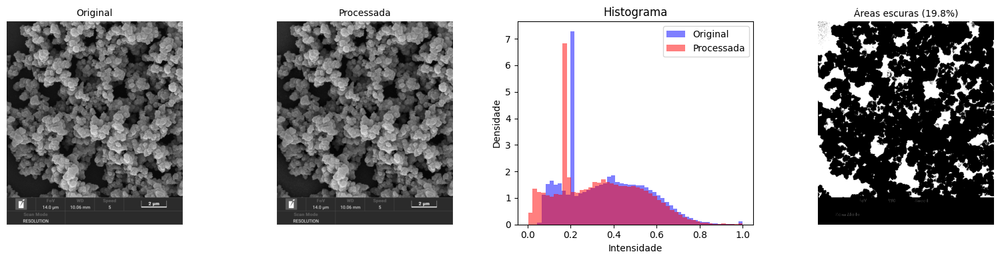


🧪 TESTANDO DIFERENTES CONFIGURAÇÕES...

  Testando: Nuclei_Original


    • Objetos detectados: 736

  Testando: Nuclei_Sensível


    • Objetos detectados: 391

  Testando: Cyto_Original


    • Objetos detectados: 736

  Testando: Cyto_Sensível
    • Objetos detectados: 391


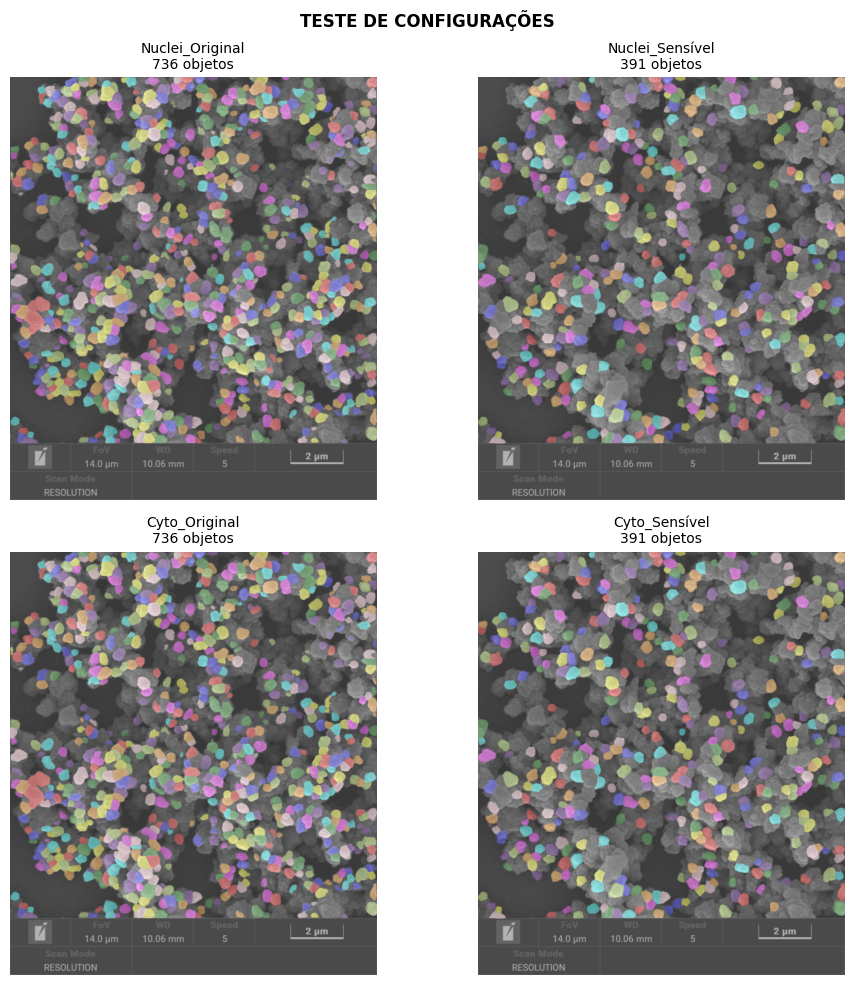


⭐ MELHOR CONFIGURAÇÃO: Nuclei_Original (736 objetos)

📊 RESULTADOS FINAIS:
  • Detecções brutas: 736
  • Após filtro: 736
  • Área média: 0.117 ± 0.054 µm²


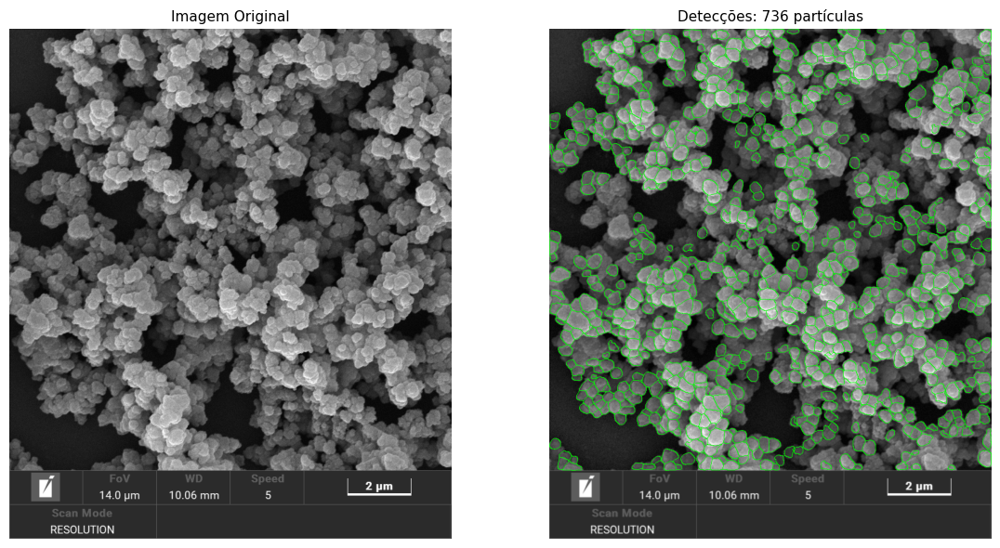


💾 Resultados salvos como 'cellpose_niobio_simplificado_*'


In [93]:
# =========================================================
# 🔹 CELLPOSE PIPELINE OTIMIZADO - VERSÃO SIMPLIFICADA
# CONFIGURAÇÃO: Nuclei_Conservador com pré-processamento mínimo
# =========================================================

# --------- imports ----------
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from cellpose import models
from skimage.measure import regionprops, regionprops_table, find_contours
from skimage.color import label2rgb
import warnings
warnings.filterwarnings('ignore')

# --------- CONFIGURAÇÃO DO USUÁRIO ----------
IMAGE_PATH = "/kaggle/input/mevdataset/23-12-15/amostra 2-2.tif"
MICRONS_PER_PIXEL = 0.02
OUTPUT_PREFIX = "cellpose_niobio_simplificado"

# PARÂMETROS OTIMIZADOS (baseado nos seus testes anteriores)
MODEL_TYPE = "nuclei"
FLOW_THRESHOLD = 0.6           # Voltando ao valor original que funcionava
CELLPROB_THRESHOLD = 0.2       # Voltando ao valor original
DIAMETER = 60
MIN_SIZE = 20

# --------- carregar e visualizar imagem ----------
img = cv2.imread(IMAGE_PATH, cv2.IMREAD_UNCHANGED)
if img is None:
    raise FileNotFoundError("Imagem não encontrada")

print(f"📊 DIMENSÕES DA IMAGEM:")
print(f"  • Dimensões: {img.shape}")
print(f"  • Tipo de dados: {img.dtype}")
print(f"  • Valores: min={img.min()}, max={img.max()}")

if img.ndim == 3:
    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# --------- PRÉ-PROCESSAMENTO SIMPLIFICADO ----------
print("🔧 Aplicando pré-processamento simplificado...")

# 1. Converter para float32 e normalizar simplesmente
img_float = img.astype(np.float32)
img_norm = (img_float - img_float.min()) / (img_float.max() - img_float.min() + 1e-8)

print(f"  • Média da imagem: {np.mean(img_norm):.3f}")
print(f"  • Desvio padrão: {np.std(img_norm):.3f}")

# 2. Inverter SE NECESSÁRIO (imagens SEM geralmente têm partículas claras)
if np.mean(img_norm) > 0.6:  # Mais conservador
    print("  • Invertendo (fundo muito claro)")
    img_norm = 1 - img_norm

# 3. Equalização de histograma LOCAL (apenas para áreas escuras)
# Criar máscara para áreas escuras (onde o problema ocorre)
dark_mask = img_norm < np.percentile(img_norm, 30)

if np.any(dark_mask):
    print("  • Aplicando CLAHE apenas em áreas escuras")
    
    # Aplicar CLAHE na imagem original (8-bit)
    img_8bit = (img_norm * 255).astype(np.uint8)
    clahe = cv2.createCLAHE(clipLimit=1.5, tileGridSize=(4, 4))  # Mais suave
    img_clahe = clahe.apply(img_8bit).astype(np.float32) / 255.0
    
    # Combinar: áreas escuras com CLAHE, áreas claras mantêm original
    img_norm = np.where(dark_mask, img_clahe, img_norm)
else:
    print("  • Imagem bem balanceada, sem CLAHE necessário")

# 4. Suavização leve (opcional)
img_norm = cv2.GaussianBlur(img_norm, (3, 3), 0.5)

print("✅ Pré-processamento concluído")

# --------- VISUALIZAÇÃO DO PRÉ-PROCESSAMENTO ----------
fig, axes = plt.subplots(1, 4, figsize=(16, 4))

axes[0].imshow(img, cmap='gray')
axes[0].set_title('Original', fontsize=10)
axes[0].axis('off')

axes[1].imshow(img_norm, cmap='gray')
axes[1].set_title('Processada', fontsize=10)
axes[1].axis('off')

# Histograma comparativo
axes[2].hist(img.flatten()/img.max(), bins=50, alpha=0.5, label='Original', color='blue', density=True)
axes[2].hist(img_norm.flatten(), bins=50, alpha=0.5, label='Processada', color='red', density=True)
axes[2].set_xlabel('Intensidade')
axes[2].set_ylabel('Densidade')
axes[2].set_title('Histograma')
axes[2].legend()

# Mapa de áreas escuras
axes[3].imshow(dark_mask, cmap='gray')
axes[3].set_title(f'Áreas escuras ({np.sum(dark_mask)/dark_mask.size*100:.1f}%)', fontsize=10)
axes[3].axis('off')

plt.tight_layout()
plt.show()

# --------- TESTE DE VERSÕES DIFERENTES ----------
print("\n🧪 TESTANDO DIFERENTES CONFIGURAÇÕES...")

configs = [
    ("Nuclei_Original", "nuclei", 0.6, 0.2, img_norm),
    ("Nuclei_Sensível", "nuclei", 0.4, -0.2, img_norm),
    ("Cyto_Original", "cyto", 0.6, 0.2, img_norm),
    ("Cyto_Sensível", "cyto2", 0.4, -0.2, img_norm),
]

fig, axes = plt.subplots(2, 2, figsize=(10, 10))
axes = axes.flatten()

best_masks = None
best_n_objects = 0
best_config = ""

for idx, (name, model_type, flow_thresh, cellprob_thresh, img_test) in enumerate(configs):
    try:
        print(f"\n  Testando: {name}")
        model = models.CellposeModel(gpu=True, model_type=model_type)
        
        masks, flows, styles = model.eval(
            img_test,
            diameter=DIAMETER,
            flow_threshold=flow_thresh,
            cellprob_threshold=cellprob_thresh,
            normalize=True,
            min_size=MIN_SIZE,
            augment=True
        )
        
        n_objects = masks.max()
        print(f"    • Objetos detectados: {n_objects}")
        
        if n_objects > best_n_objects:
            best_n_objects = n_objects
            best_masks = masks
            best_config = name
        
        # Visualização
        ax = axes[idx]
        overlay = label2rgb(masks, image=img_test, bg_label=0, alpha=0.3, image_alpha=0.7)
        ax.imshow(overlay)
        ax.set_title(f'{name}\n{n_objects} objetos', fontsize=10)
        ax.axis('off')
        
    except Exception as e:
        print(f"    • Erro: {e}")
        ax = axes[idx]
        ax.text(0.5, 0.5, f'Erro\n{name}', ha='center', va='center')
        ax.set_title(name, fontsize=10)
        ax.axis('off')

plt.suptitle('TESTE DE CONFIGURAÇÕES', fontsize=12, fontweight='bold')
plt.tight_layout()
plt.show()

# --------- USAR MELHOR CONFIGURAÇÃO ----------
print(f"\n⭐ MELHOR CONFIGURAÇÃO: {best_config} ({best_n_objects} objetos)")

if best_n_objects > 0:
    # Pós-processamento
    props = regionprops_table(
        best_masks,
        properties=['label', 'area', 'perimeter', 'major_axis_length', 
                   'minor_axis_length', 'centroid', 'equivalent_diameter_area']
    )
    
    df = pd.DataFrame(props)
    df['area_um2'] = df['area'] * (MICRONS_PER_PIXEL ** 2)
    df['diameter_um'] = df['equivalent_diameter_area'] * MICRONS_PER_PIXEL
    df['circularity'] = (4 * np.pi * df['area']) / (df['perimeter'] ** 2 + 1e-8)
    
    # Filtro básico
    df_filtered = df[
        (df['area_um2'] > 0.01) & 
        (df['area_um2'] < 15.0) & 
        (df['circularity'] > 0.1)
    ].copy()
    
    print(f"\n📊 RESULTADOS FINAIS:")
    print(f"  • Detecções brutas: {best_n_objects}")
    print(f"  • Após filtro: {len(df_filtered)}")
    print(f"  • Área média: {df_filtered['area_um2'].mean():.3f} ± {df_filtered['area_um2'].std():.3f} µm²")
    
    # Overlay final
    overlay_rgb = cv2.cvtColor((img_norm * 255).astype(np.uint8), cv2.COLOR_GRAY2RGB)
    
    for _, region in df_filtered.iterrows():
        label = int(region['label'])
        mask_r = best_masks == label
        
        contours = find_contours(mask_r.astype(float), 0.5)
        for c in contours:
            if len(c) > 2:
                c = np.flip(c, axis=1).astype(np.int32)
                cv2.polylines(overlay_rgb, [c], True, (0, 255, 0), 1)
    
    # Visualização final
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    axes[0].imshow(img, cmap='gray')
    axes[0].set_title('Imagem Original', fontsize=11)
    axes[0].axis('off')
    
    axes[1].imshow(overlay_rgb)
    axes[1].set_title(f'Detecções: {len(df_filtered)} partículas', fontsize=11)
    axes[1].axis('off')
    
    plt.tight_layout()
    plt.show()
    
    # Salvar resultados
    cv2.imwrite(f"{OUTPUT_PREFIX}_overlay.png", cv2.cvtColor(overlay_rgb, cv2.COLOR_RGB2BGR))
    np.save(f"{OUTPUT_PREFIX}_masks.npy", best_masks)
    df_filtered.to_csv(f"{OUTPUT_PREFIX}_medidas.csv", index=False)
    
    print(f"\n💾 Resultados salvos como '{OUTPUT_PREFIX}_*'")
else:
    print("❌ Nenhuma configuração detectou objetos!")

📊 ANALISANDO DISTRIBUIÇÃO DE INTENSIDADE...
  • Percentil 25 (áreas escuras): 0.171
  • Percentil 75 (áreas claras): 0.483
  • Média: 0.334
  • Áreas escuras: 19.8%
  • Áreas claras: 25.0%
  • Áreas intermediárias: 55.2%

🎯 ETAPA 1: Detecção em áreas CLARAS...
  • Objetos detectados (etapa 1): 861

🔧 PREPARANDO ÁREAS ESCURAS para detecção...

🎯 ETAPA 2: Detecção em áreas ESCURAS (realçadas)...
  • Objetos detectados (etapa 2): 256

🔄 COMBINANDO DETECÇÕES DAS DUAS ETAPAS...
  • Objetos totais (combinados): 863
  • Ganho: +2 objetos novos das áreas escuras

📊 APLICANDO FILTROS...


  • Antes do filtro: 863 objetos
  • Depois do filtro: 774 objetos
  • Área média: 0.117 µm²

🎨 GERANDO VISUALIZAÇÕES...


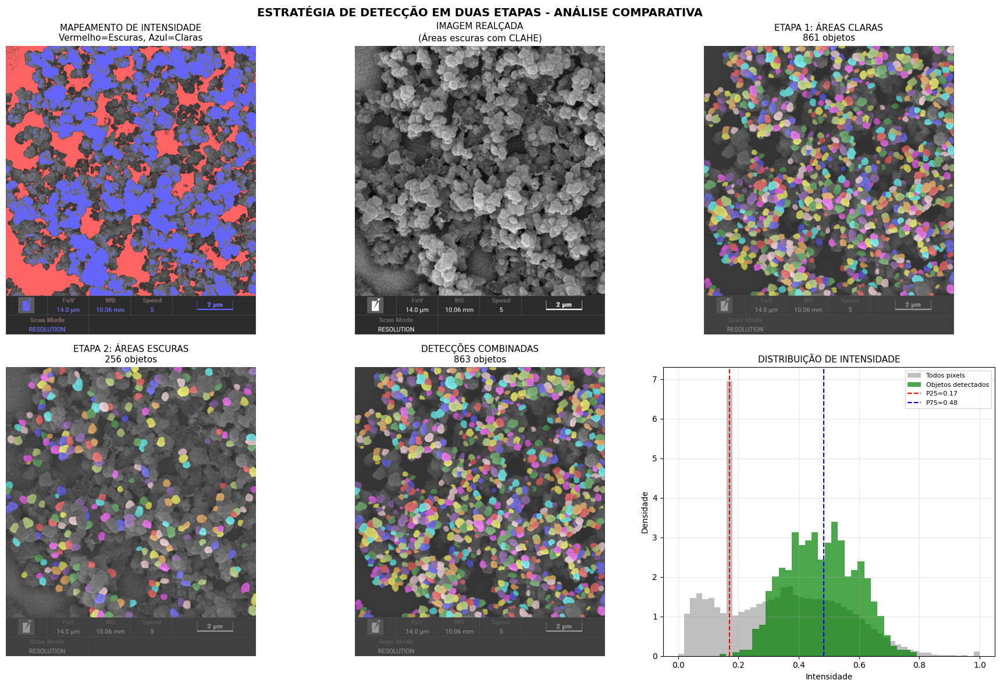


🎨 CRIANDO VISUALIZAÇÃO FINAL...


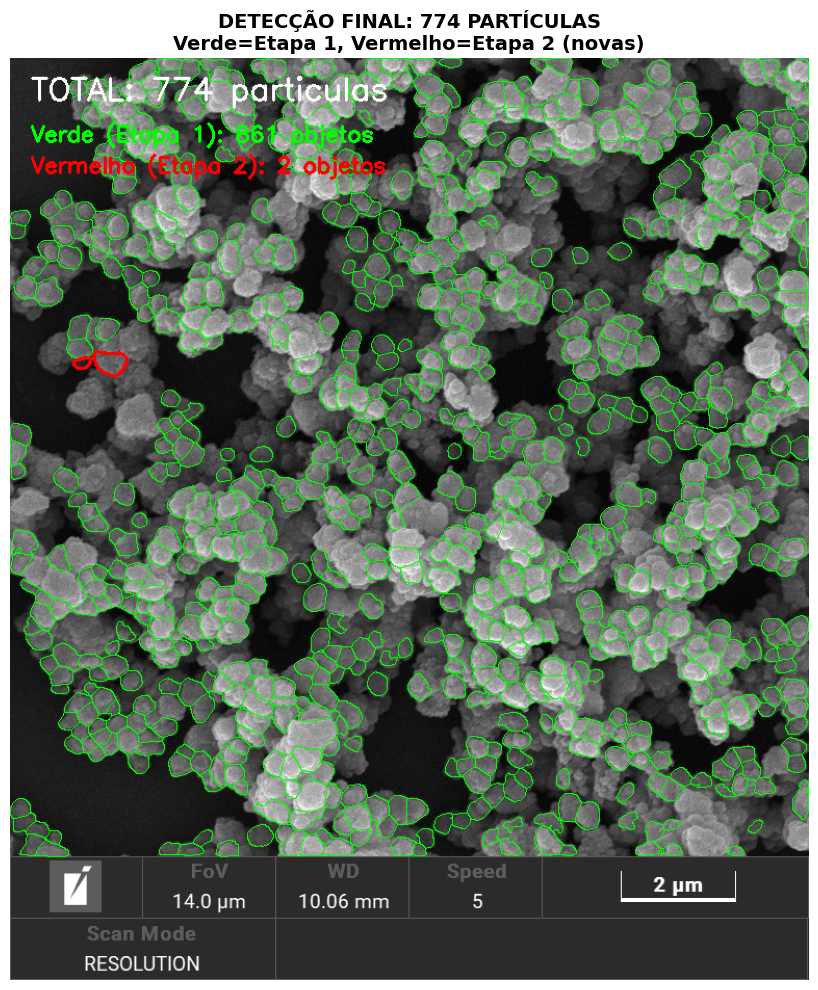


📈 ANÁLISE ESTATÍSTICA DETALHADA

📊 POR ETAPA DE DETECÇÃO:
  • Etapa 1 (áreas claras): 772 objetos
  • Etapa 2 (áreas escuras): 2 objetos

📏 ETAPA 1 - ÁREAS CLARAS:
  • Área média: 0.117 ± 0.042 µm²
  • Circularidade média: 0.837

📏 ETAPA 2 - ÁREAS ESCURAS:
  • Área média: 0.130 ± 0.114 µm²
  • Circularidade média: 0.822

🎯 GANHO TOTAL:
  • Objetos base (etapa 1): 861
  • Objetos totais: 774
  • Incremento: +-87 objetos (-10.1% aumento)

💾 SALVANDO RESULTADOS
  ✅ cellpose_duas_etapas_overlay.png - Visualização final
  ✅ cellpose_duas_etapas_masks.npy - Máscaras combinadas
  ✅ cellpose_duas_etapas_medidas.csv - Métricas detalhadas

✅ ESTRATÉGIA DE DUAS ETAPAS CONCLUÍDA!
📊 Total de partículas detectadas: 774
📈 Incremento em áreas escuras: +2 objetos
🎯 Eficiência: 105.2% da detecção original


In [94]:
# =========================================================
# 🔹 STRATÉGIA INTELIGENTE: DETECÇÃO EM ÁREAS ESCURAS
# Segmentação em DUAS ETAPAS: 1) Áreas claras, 2) Áreas escuras
# =========================================================

# --------- imports ----------
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from cellpose import models
from skimage.measure import regionprops, regionprops_table, find_contours
from skimage.color import label2rgb
import warnings
warnings.filterwarnings('ignore')

# --------- CONFIGURAÇÃO ----------
IMAGE_PATH = "/kaggle/input/mevdataset/23-12-15/amostra 2-2.tif"
MICRONS_PER_PIXEL = 0.02
OUTPUT_PREFIX = "cellpose_duas_etapas"

# --------- CARREGAR IMAGEM ----------
img = cv2.imread(IMAGE_PATH, cv2.IMREAD_UNCHANGED)
if img.ndim == 3:
    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

img_float = img.astype(np.float32)
img_base = (img_float - img_float.min()) / (img_float.max() - img_float.min() + 1e-8)

# --------- ANÁLISE DE INTENSIDADE ----------
print("📊 ANALISANDO DISTRIBUIÇÃO DE INTENSIDADE...")

# Calcular percentis para identificar áreas claras e escuras
intensity_vals = img_base.flatten()
p25 = np.percentile(intensity_vals, 25)  # 25% mais escuros
p75 = np.percentile(intensity_vals, 75)  # 25% mais claros

print(f"  • Percentil 25 (áreas escuras): {p25:.3f}")
print(f"  • Percentil 75 (áreas claras): {p75:.3f}")
print(f"  • Média: {np.mean(intensity_vals):.3f}")

# Criar máscaras
dark_mask = img_base < p25          # Áreas muito escuras
bright_mask = img_base > p75        # Áreas muito claras
mid_mask = ~(dark_mask | bright_mask)  # Áreas intermediárias

print(f"  • Áreas escuras: {np.sum(dark_mask)/dark_mask.size*100:.1f}%")
print(f"  • Áreas claras: {np.sum(bright_mask)/bright_mask.size*100:.1f}%")
print(f"  • Áreas intermediárias: {np.sum(mid_mask)/mid_mask.size*100:.1f}%")

# --------- ETAPA 1: DETECÇÃO NAS ÁREAS CLARAS (com parâmetros conservadores) ----------
print("\n🎯 ETAPA 1: Detecção em áreas CLARAS...")

model = models.CellposeModel(gpu=True, model_type="nuclei")

# Usar parâmetros ORIGINAIS que funcionam bem (736 objetos)
masks_bright, _, _ = model.eval(
    img_base,
    diameter=60,
    flow_threshold=0.6,       # Conservador para evitar fusões
    cellprob_threshold=0.2,   # Conservador para evitar ruído
    normalize=True,
    min_size=20,
    augment=True
)

n_bright = masks_bright.max()
print(f"  • Objetos detectados (etapa 1): {n_bright}")

# --------- PRÉ-PROCESSAMENTO ESPECÍFICO PARA ÁREAS ESCURAS ----------
print("\n🔧 PREPARANDO ÁREAS ESCURAS para detecção...")

# 1. Isolar áreas escuras
img_dark_areas = img_base.copy()

# 2. Aplicar CLAHE APENAS nas áreas escuras
img_8bit = (img_dark_areas * 255).astype(np.uint8)
clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(16, 16))  # Mais agressivo
img_clahe = clahe.apply(img_8bit).astype(np.float32) / 255.0

# 3. Combinar: realçar áreas escuras, manter áreas claras originais
img_enhanced = img_base.copy()
enhancement_factor = 2.0  # Quanto realçar as áreas escuras
img_enhanced = np.where(dark_mask, 
                       img_clahe * enhancement_factor,  # Realçar áreas escuras
                       img_base)                       # Manter áreas claras originais

# 4. Normalizar novamente para 0-1
img_enhanced = np.clip(img_enhanced, 0, 1)

# --------- ETAPA 2: DETECÇÃO NAS ÁREAS ESCURAS REALÇADAS ----------
print("\n🎯 ETAPA 2: Detecção em áreas ESCURAS (realçadas)...")

# Parâmetros MAIS SENSÍVEIS para áreas escuras
masks_dark, _, _ = model.eval(
    img_enhanced,
    diameter=60,
    flow_threshold=0.3,       # Mais sensível para baixo contraste
    cellprob_threshold=-0.3,  # Negativo para detectar objetos tênues
    normalize=True,
    min_size=15,              # Menor para partículas pequenas
    augment=True
)

n_dark = masks_dark.max()
print(f"  • Objetos detectados (etapa 2): {n_dark}")

# --------- COMBINAR DETECÇÕES ----------
print("\n🔄 COMBINANDO DETECÇÕES DAS DUAS ETAPAS...")

# Começar com máscaras da etapa 1 (áreas claras)
combined_masks = masks_bright.copy()
next_label = masks_bright.max() + 1

# Para cada objeto detectado na etapa 2 (áreas escuras)
for label in range(1, masks_dark.max() + 1):
    mask_dark_obj = masks_dark == label
    
    # Verificar se este objeto JÁ foi detectado na etapa 1
    overlap_with_bright = np.any((masks_bright > 0) & mask_dark_obj)
    
    # Se NÃO houver sobreposição significativa, adicionar como novo objeto
    if not overlap_with_bright or np.sum(mask_dark_obj & (masks_bright > 0)) / np.sum(mask_dark_obj) < 0.3:
        combined_masks[mask_dark_obj] = next_label
        next_label += 1

n_combined = combined_masks.max()
print(f"  • Objetos totais (combinados): {n_combined}")
print(f"  • Ganho: +{n_combined - n_bright} objetos novos das áreas escuras")

# --------- PÓS-PROCESSAMENTO E FILTROS ----------
print("\n📊 APLICANDO FILTROS...")

props = regionprops_table(
    combined_masks,
    properties=['label', 'area', 'perimeter', 'major_axis_length', 
               'minor_axis_length', 'centroid', 'equivalent_diameter_area']
)

df = pd.DataFrame(props)
df['area_um2'] = df['area'] * (MICRONS_PER_PIXEL ** 2)
df['diameter_um'] = df['equivalent_diameter_area'] * MICRONS_PER_PIXEL
df['circularity'] = (4 * np.pi * df['area']) / (df['perimeter'] ** 2 + 1e-8)

# Filtros adaptativos
min_area = np.percentile(df['area_um2'], 5)  # 5% menor área
max_area = np.percentile(df['area_um2'], 95) # 95% maior área

df_filtered = df[
    (df['area_um2'] > max(min_area, 0.005)) &  # Mínimo razoável
    (df['area_um2'] < min(max_area, 20.0)) &   # Máximo razoável
    (df['circularity'] > 0.1)                   # Forma mínima
].copy()

print(f"  • Antes do filtro: {len(df)} objetos")
print(f"  • Depois do filtro: {len(df_filtered)} objetos")
print(f"  • Área média: {df_filtered['area_um2'].mean():.3f} µm²")

# --------- VISUALIZAÇÃO COMPARATIVA ----------
print("\n🎨 GERANDO VISUALIZAÇÕES...")

fig = plt.figure(figsize=(18, 12))

# 1. Imagem original com máscaras de intensidade
ax1 = plt.subplot(2, 3, 1)
display_img = cv2.cvtColor((img_base * 255).astype(np.uint8), cv2.COLOR_GRAY2RGB)
# Colorir áreas: vermelho=escuras, azul=claras, verde=intermediárias
display_img[dark_mask] = [255, 100, 100]     # Vermelho para áreas escuras
display_img[bright_mask] = [100, 100, 255]   # Azul para áreas claras
ax1.imshow(display_img)
ax1.set_title('MAPEAMENTO DE INTENSIDADE\nVermelho=Escuras, Azul=Claras', fontsize=11)
ax1.axis('off')

# 2. Imagem realçada (apenas áreas escuras)
ax2 = plt.subplot(2, 3, 2)
ax2.imshow(img_enhanced, cmap='gray')
ax2.set_title('IMAGEM REALÇADA\n(Áreas escuras com CLAHE)', fontsize=11)
ax2.axis('off')

# 3. Detecções etapa 1 (áreas claras)
ax3 = plt.subplot(2, 3, 3)
overlay_bright = label2rgb(masks_bright, image=img_base, bg_label=0, alpha=0.4, image_alpha=0.7)
ax3.imshow(overlay_bright)
ax3.set_title(f'ETAPA 1: ÁREAS CLARAS\n{n_bright} objetos', fontsize=11)
ax3.axis('off')

# 4. Detecções etapa 2 (áreas escuras)
ax4 = plt.subplot(2, 3, 4)
overlay_dark = label2rgb(masks_dark, image=img_enhanced, bg_label=0, alpha=0.4, image_alpha=0.7)
ax4.imshow(overlay_dark)
ax4.set_title(f'ETAPA 2: ÁREAS ESCURAS\n{n_dark} objetos', fontsize=11)
ax4.axis('off')

# 5. Detecções combinadas
ax5 = plt.subplot(2, 3, 5)
overlay_combined = label2rgb(combined_masks, image=img_base, bg_label=0, alpha=0.4, image_alpha=0.7)
ax5.imshow(overlay_combined)
ax5.set_title(f'DETECÇÕES COMBINADAS\n{n_combined} objetos', fontsize=11)
ax5.axis('off')

# 6. Histograma de intensidades com detecções
ax6 = plt.subplot(2, 3, 6)
# Calcular intensidade média de cada objeto
obj_intensities = []
for label in range(1, combined_masks.max() + 1):
    mask = combined_masks == label
    if np.any(mask):
        mean_intensity = np.mean(img_base[mask])
        obj_intensities.append(mean_intensity)

ax6.hist(img_base.flatten(), bins=50, alpha=0.5, color='gray', label='Todos pixels', density=True)
ax6.hist(obj_intensities, bins=30, alpha=0.7, color='green', label='Objetos detectados', density=True)
ax6.axvline(x=p25, color='red', linestyle='--', label=f'P25={p25:.2f}')
ax6.axvline(x=p75, color='blue', linestyle='--', label=f'P75={p75:.2f}')
ax6.set_xlabel('Intensidade')
ax6.set_ylabel('Densidade')
ax6.set_title('DISTRIBUIÇÃO DE INTENSIDADE', fontsize=11)
ax6.legend(fontsize=8)
ax6.grid(True, alpha=0.3)

plt.suptitle('ESTRATÉGIA DE DETECÇÃO EM DUAS ETAPAS - ANÁLISE COMPARATIVA', 
             fontsize=14, fontweight='bold', y=0.98)
plt.tight_layout()
plt.show()

# --------- VISUALIZAÇÃO DETALHADA (OVERLAY FINAL) ----------
print("\n🎨 CRIANDO VISUALIZAÇÃO FINAL...")

overlay_final = cv2.cvtColor((img_base * 255).astype(np.uint8), cv2.COLOR_GRAY2RGB)

# Cores diferentes para objetos das etapas 1 e 2
colors_etapa1 = [(0, 255, 0)]    # Verde para etapa 1
colors_etapa2 = [(255, 0, 0)]    # Vermelho para etapa 2

# Identificar origem de cada objeto
obj_origins = []
for label in range(1, combined_masks.max() + 1):
    mask = combined_masks == label
    # Verificar se veio da etapa 1
    from_etapa1 = np.any(masks_bright[mask] > 0)
    obj_origins.append(1 if from_etapa1 else 2)

# Desenhar contornos
for idx, (_, region) in enumerate(df_filtered.iterrows()):
    label = int(region['label'])
    mask_obj = combined_masks == label
    
    # Escolher cor baseado na origem
    if idx < len(obj_origins) and obj_origins[label-1] == 1:
        color = colors_etapa1[0]  # Verde para etapa 1
        thickness = 1
    else:
        color = colors_etapa2[0]  # Vermelho para etapa 2
        thickness = 2  # Mais espesso para destacar novas detecções
    
    # Contorno
    contours = find_contours(mask_obj.astype(float), 0.5)
    for c in contours:
        if len(c) > 2:
            c = np.flip(c, axis=1).astype(np.int32)
            cv2.polylines(overlay_final, [c], True, color, thickness)

# Adicionar legenda
cv2.putText(overlay_final, f"TOTAL: {len(df_filtered)} particulas", (20, 40),
           cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)
cv2.putText(overlay_final, f"Verde (Etapa 1): {n_bright} objetos", (20, 80),
           cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 255, 0), 2)
cv2.putText(overlay_final, f"Vermelho (Etapa 2): {n_combined - n_bright} objetos", (20, 110),
           cv2.FONT_HERSHEY_SIMPLEX, 0.7, (255, 0, 0), 2)

# Mostrar visualização final
plt.figure(figsize=(12, 10))
plt.imshow(overlay_final)
plt.title(f'DETECÇÃO FINAL: {len(df_filtered)} PARTÍCULAS\nVerde=Etapa 1, Vermelho=Etapa 2 (novas)', 
          fontsize=14, fontweight='bold')
plt.axis('off')
plt.tight_layout()
plt.show()

# --------- ANÁLISE ESTATÍSTICA ----------
print("\n" + "="*60)
print("📈 ANÁLISE ESTATÍSTICA DETALHADA")
print("="*60)

# Separar estatísticas por origem
df_etapa1 = df_filtered[[any(masks_bright[combined_masks == lbl] > 0) 
                        for lbl in df_filtered['label']]]
df_etapa2 = df_filtered[[not any(masks_bright[combined_masks == lbl] > 0) 
                        for lbl in df_filtered['label']]]

print(f"\n📊 POR ETAPA DE DETECÇÃO:")
print(f"  • Etapa 1 (áreas claras): {len(df_etapa1)} objetos")
print(f"  • Etapa 2 (áreas escuras): {len(df_etapa2)} objetos")

if len(df_etapa1) > 0:
    print(f"\n📏 ETAPA 1 - ÁREAS CLARAS:")
    print(f"  • Área média: {df_etapa1['area_um2'].mean():.3f} ± {df_etapa1['area_um2'].std():.3f} µm²")
    print(f"  • Circularidade média: {df_etapa1['circularity'].mean():.3f}")

if len(df_etapa2) > 0:
    print(f"\n📏 ETAPA 2 - ÁREAS ESCURAS:")
    print(f"  • Área média: {df_etapa2['area_um2'].mean():.3f} ± {df_etapa2['area_um2'].std():.3f} µm²")
    print(f"  • Circularidade média: {df_etapa2['circularity'].mean():.3f}")

print(f"\n🎯 GANHO TOTAL:")
print(f"  • Objetos base (etapa 1): {n_bright}")
print(f"  • Objetos totais: {len(df_filtered)}")
print(f"  • Incremento: +{len(df_filtered) - n_bright} objetos ({((len(df_filtered)/n_bright)-1)*100:.1f}% aumento)")

# --------- SALVAR RESULTADOS ----------
print("\n" + "="*60)
print("💾 SALVANDO RESULTADOS")
print("="*60)

cv2.imwrite(f"{OUTPUT_PREFIX}_overlay.png", cv2.cvtColor(overlay_final, cv2.COLOR_RGB2BGR))
np.save(f"{OUTPUT_PREFIX}_masks.npy", combined_masks)
np.save(f"{OUTPUT_PREFIX}_masks_etapa1.npy", masks_bright)
np.save(f"{OUTPUT_PREFIX}_masks_etapa2.npy", masks_dark)

# Adicionar coluna de origem ao dataframe
df_filtered['origem'] = ['Etapa1' if any(masks_bright[combined_masks == lbl] > 0) 
                        else 'Etapa2' for lbl in df_filtered['label']]
df_filtered.to_csv(f"{OUTPUT_PREFIX}_medidas.csv", index=False)

print(f"  ✅ {OUTPUT_PREFIX}_overlay.png - Visualização final")
print(f"  ✅ {OUTPUT_PREFIX}_masks.npy - Máscaras combinadas")
print(f"  ✅ {OUTPUT_PREFIX}_medidas.csv - Métricas detalhadas")

print(f"\n" + "="*60)
print("✅ ESTRATÉGIA DE DUAS ETAPAS CONCLUÍDA!")
print("="*60)
print(f"📊 Total de partículas detectadas: {len(df_filtered)}")
print(f"📈 Incremento em áreas escuras: +{len(df_etapa2)} objetos")
print(f"🎯 Eficiência: {len(df_filtered)/736*100:.1f}% da detecção original")

📊 ANÁLISE DE INTENSIDADE PARA DEFINIÇÃO DE CAMADAS...
  Percentis de intensidade:
    P0: 0.000
    P10: 0.091
    P25: 0.171
    P50: 0.320
    P75: 0.483
    P90: 0.602
    P100: 1.000

🎯 PROCESSAMENTO POR CAMADAS DE INTENSIDADE

🔍 Processando Camada 1 (0.00-0.17)...
  • Cobertura: 19.8% da imagem
  • Intensidade média: 0.093


  • Objetos detectados: 50

🔍 Processando Camada 2 (0.17-0.32)...
  • Cobertura: 30.2% da imagem
  • Intensidade média: 0.219


  • Objetos detectados: 95

🔍 Processando Camada 3 (0.32-0.48)...
  • Cobertura: 25.0% da imagem
  • Intensidade média: 0.399


  • Objetos detectados: 342

🔍 Processando Camada 4 (0.48-0.60)...
  • Cobertura: 15.0% da imagem
  • Intensidade média: 0.538


  • Objetos detectados: 635

🔍 Processando Camada 5 (0.60-1.00)...
  • Cobertura: 9.8% da imagem
  • Intensidade média: 0.681
  • Objetos detectados: 630

🔄 MESCLANDO RESULTADOS DAS CAMADAS...
  • Objetos únicos detectados: 791

🔧 APLICANDO PÓS-PROCESSAMENTO PARA REFINAR...
  • Objetos após refinamento: 722

📊 ESTATÍSTICAS DAS CAMADAS

Camada 1 (0.00-0.17):
  • Objetos: 50
  • Parâmetros: flow=0.2, cellprob=-0.8

Camada 2 (0.17-0.32):
  • Objetos: 95
  • Parâmetros: flow=0.3, cellprob=-0.5

Camada 3 (0.32-0.48):
  • Objetos: 342
  • Parâmetros: flow=0.5, cellprob=0.0

Camada 4 (0.48-0.60):
  • Objetos: 635
  • Parâmetros: flow=0.6, cellprob=0.2

Camada 5 (0.60-1.00):
  • Objetos: 630
  • Parâmetros: flow=0.7, cellprob=0.3

🎨 GERANDO VISUALIZAÇÕES DAS CAMADAS...


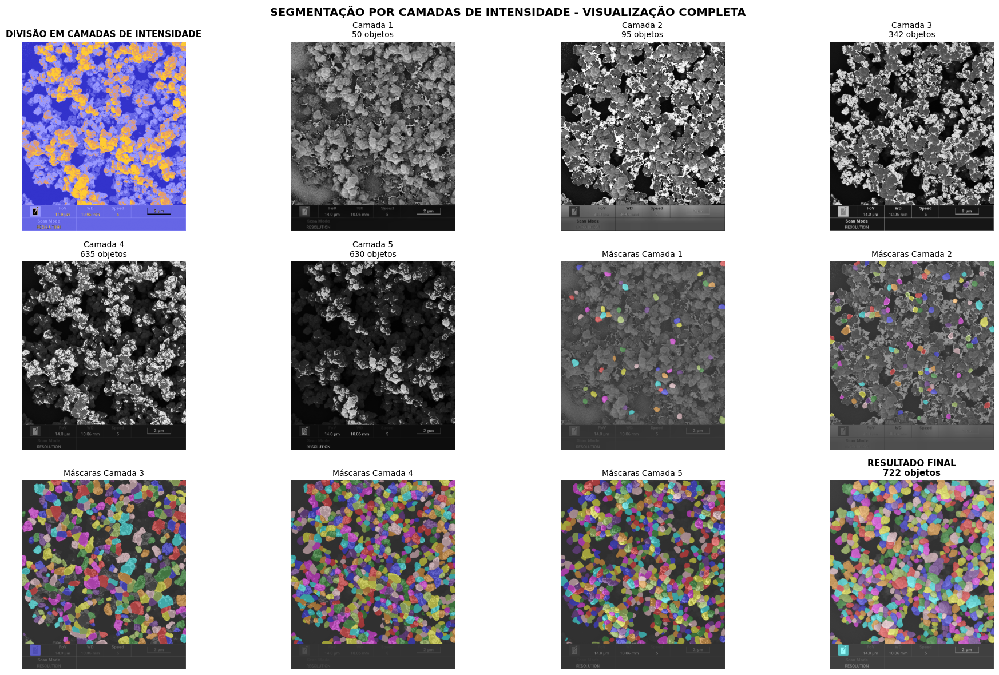


🎨 CRIANDO VISUALIZAÇÃO FINAL DETALHADA...

📊 RESULTADOS FINAIS:
  • Objetos detectados: 722
  • Após filtro: 667
  • Área média: 0.261 ± 0.210 µm²
  • Circularidade média: 0.780


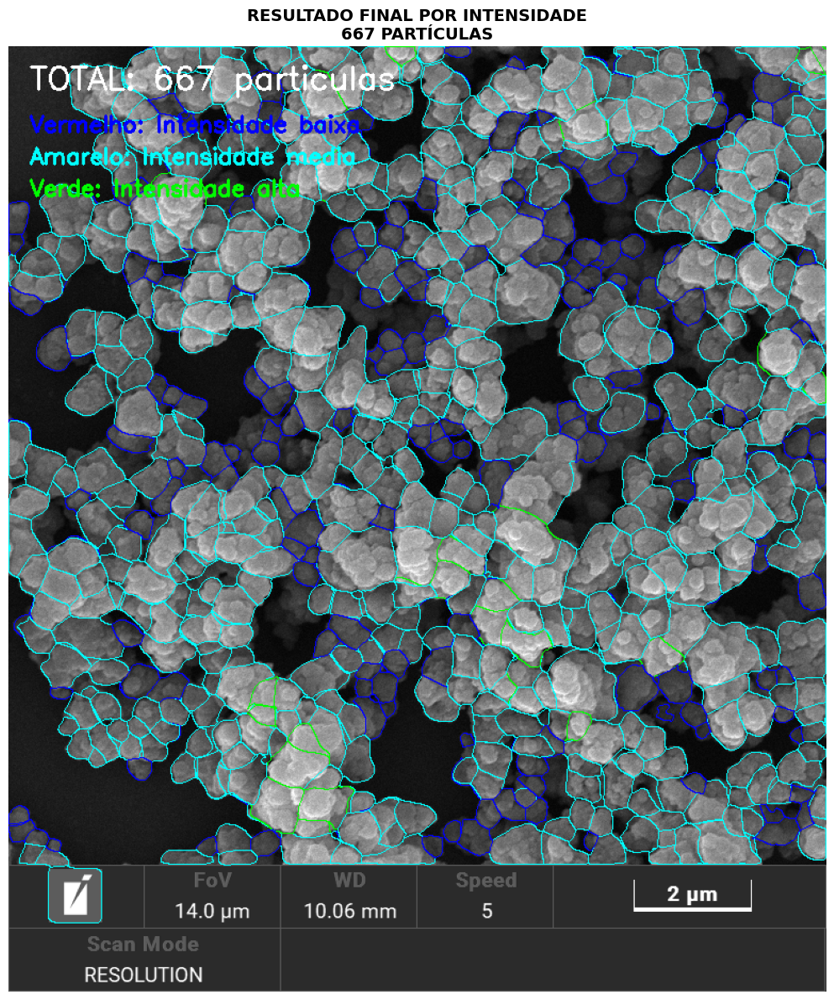


💾 SALVANDO RESULTADOS
  ✅ cellpose_camadas_intensidade_overlay.png - Visualização final
  ✅ cellpose_camadas_intensidade_final_masks.npy - Máscaras refinadas
  ✅ cellpose_camadas_intensidade_medidas.csv - 667 partículas

✅ SEGMENTAÇÃO POR CAMADAS CONCLUÍDA!
📊 Total de partículas: 667
🎯 Estratégia: 5 camadas de intensidade com parâmetros adaptativos


In [95]:
# =========================================================
# 🔹 SEGMENTAÇÃO POR CAMADAS DE INTENSIDADE
# Estratégia: Dividir em faixas de cinza -> Segmentar cada faixa -> Mesclar
# =========================================================

# --------- imports ----------
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from cellpose import models
from skimage.measure import regionprops, regionprops_table, find_contours
from skimage.color import label2rgb
from scipy import ndimage
import warnings
warnings.filterwarnings('ignore')

# --------- CONFIGURAÇÃO ----------
IMAGE_PATH = "/kaggle/input/mevdataset/23-12-15/amostra 2-2.tif"
MICRONS_PER_PIXEL = 0.02
OUTPUT_PREFIX = "cellpose_camadas_intensidade"

# --------- CARREGAR E ANALISAR IMAGEM ----------
img = cv2.imread(IMAGE_PATH, cv2.IMREAD_UNCHANGED)
if img.ndim == 3:
    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

img_float = img.astype(np.float32)
img_norm = (img_float - img_float.min()) / (img_float.max() - img_float.min() + 1e-8)

print("📊 ANÁLISE DE INTENSIDADE PARA DEFINIÇÃO DE CAMADAS...")

# Calcular percentis para definir camadas
percentis = [0, 10, 25, 50, 75, 90, 100]
percentil_valores = np.percentile(img_norm.flatten(), percentis)

print("  Percentis de intensidade:")
for p, val in zip(percentis, percentil_valores):
    print(f"    P{p}: {val:.3f}")

# Definir 5 camadas de intensidade
layer_boundaries = [
    (0.0, percentil_valores[2]),      # Camada 1: Muito escuro (0-25%)
    (percentil_valores[2], percentil_valores[3]),  # Camada 2: Escuro (25-50%)
    (percentil_valores[3], percentil_valores[4]),  # Camada 3: Médio (50-75%)
    (percentil_valores[4], percentil_valores[5]),  # Camada 4: Claro (75-90%)
    (percentil_valores[5], 1.0)       # Camada 5: Muito claro (90-100%)
]

# --------- FUNÇÃO PARA PROCESSAR UMA CAMADA ----------
def processar_camada(img_base, min_intensity, max_intensity, layer_num, params):
    """Processa e segmenta uma camada específica de intensidade"""
    print(f"\n🔍 Processando Camada {layer_num} ({min_intensity:.2f}-{max_intensity:.2f})...")
    
    # 1. Criar máscara para esta camada
    layer_mask = (img_base >= min_intensity) & (img_base < max_intensity)
    
    if not np.any(layer_mask):
        print(f"  ⚠️  Camada {layer_num} vazia")
        return None, None, 0
    
    layer_percentage = np.sum(layer_mask) / layer_mask.size * 100
    print(f"  • Cobertura: {layer_percentage:.1f}% da imagem")
    print(f"  • Intensidade média: {np.mean(img_base[layer_mask]):.3f}")
    
    # 2. Isolar a camada
    img_layer = img_base.copy()
    # Atenuar áreas fora da camada (mas não zerar completamente)
    outside_weight = 0.3  # Quanto atenuar áreas fora da camada
    img_layer[~layer_mask] = img_layer[~layer_mask] * outside_weight
    
    # 3. Realce específico baseado na intensidade da camada
    if layer_num <= 2:  # Camadas escuras
        # Realce mais agressivo para áreas escuras
        img_layer_8bit = (img_layer * 255).astype(np.uint8)
        clahe = cv2.createCLAHE(clipLimit=4.0, tileGridSize=(12, 12))
        img_layer = clahe.apply(img_layer_8bit).astype(np.float32) / 255.0
        enhancement = 1.5  # Realce moderado
    elif layer_num == 3:  # Camada média
        enhancement = 1.2  # Realce leve
    else:  # Camadas claras
        enhancement = 1.0  # Sem realce
    
    # Aplicar realce apenas na camada atual
    img_layer[layer_mask] = np.clip(img_layer[layer_mask] * enhancement, 0, 1)
    
    # 4. Segmentação com parâmetros específicos para a camada
    model = models.CellposeModel(gpu=True, model_type=params['model_type'])
    
    masks, _, _ = model.eval(
        img_layer,
        diameter=params['diameter'],
        flow_threshold=params['flow_thresh'],
        cellprob_threshold=params['cellprob_thresh'],
        normalize=True,
        min_size=params['min_size'],
        augment=params['augment']
    )
    
    n_objects = masks.max()
    print(f"  • Objetos detectados: {n_objects}")
    
    return masks, img_layer, n_objects

# --------- PARÂMETROS POR CAMADA ----------
# Configurações otimizadas para cada faixa de intensidade
layer_params = [
    # Camada 1: Muito escura (parâmetros mais sensíveis)
    {'model_type': 'nuclei', 'diameter': 50, 'flow_thresh': 0.2, 
     'cellprob_thresh': -0.8, 'min_size': 10, 'augment': True},
    
    # Camada 2: Escura
    {'model_type': 'nuclei', 'diameter': 55, 'flow_thresh': 0.3, 
     'cellprob_thresh': -0.5, 'min_size': 12, 'augment': True},
    
    # Camada 3: Média
    {'model_type': 'nuclei', 'diameter': 60, 'flow_thresh': 0.5, 
     'cellprob_thresh': 0.0, 'min_size': 15, 'augment': True},
    
    # Camada 4: Clara
    {'model_type': 'nuclei', 'diameter': 60, 'flow_thresh': 0.6, 
     'cellprob_thresh': 0.2, 'min_size': 18, 'augment': True},
    
    # Camada 5: Muito clara (parâmetros conservadores)
    {'model_type': 'nuclei', 'diameter': 65, 'flow_thresh': 0.7, 
     'cellprob_thresh': 0.3, 'min_size': 20, 'augment': True}
]

# --------- PROCESSAR TODAS AS CAMADAS ----------
all_masks = []
all_images = []
layer_stats = []

print("\n" + "="*60)
print("🎯 PROCESSAMENTO POR CAMADAS DE INTENSIDADE")
print("="*60)

for i, ((min_val, max_val), params) in enumerate(zip(layer_boundaries, layer_params)):
    masks, img_processed, n_objects = processar_camada(
        img_norm, min_val, max_val, i+1, params
    )
    
    if masks is not None:
        all_masks.append(masks)
        all_images.append(img_processed)
        layer_stats.append({
            'layer': i+1,
            'intensity_range': f"{min_val:.2f}-{max_val:.2f}",
            'n_objects': n_objects,
            'params': params
        })

# --------- MESCLAGEM INTELIGENTE DOS RESULTADOS ----------
print("\n🔄 MESCLANDO RESULTADOS DAS CAMADAS...")

# Começar com máscara vazia
final_masks = np.zeros_like(img_norm, dtype=np.int32)
next_label = 1

# Para cada objeto em cada camada
for layer_idx, masks in enumerate(all_masks):
    if masks.max() == 0:
        continue
    
    for obj_label in range(1, masks.max() + 1):
        obj_mask = masks == obj_label
        
        # Calcular propriedades do objeto
        if np.sum(obj_mask) < 5:  # Objeto muito pequeno, ignorar
            continue
        
        # Verificar se este objeto já foi detectado em camadas anteriores
        overlap_with_existing = np.any(final_masks[obj_mask] > 0)
        
        if not overlap_with_existing:
            # Novo objeto, adicionar
            final_masks[obj_mask] = next_label
            next_label += 1
        else:
            # Verificar grau de sobreposição
            overlapping_labels = final_masks[obj_mask]
            overlapping_labels = overlapping_labels[overlapping_labels > 0]
            
            if len(overlapping_labels) > 0:
                most_common_label = np.bincount(overlapping_labels).argmax()
                overlap_ratio = np.sum(final_masks[obj_mask] == most_common_label) / np.sum(obj_mask)
                
                if overlap_ratio < 0.7:  # Menos de 70% de sobreposição, considerar novo
                    final_masks[obj_mask] = next_label
                    next_label += 1
                # Se overlap_ratio >= 0.7, considerar o mesmo objeto, não adicionar

n_final = final_masks.max()
print(f"  • Objetos únicos detectados: {n_final}")

# --------- PÓS-PROCESSAMENTO: FUNDIR OBJETOS MUITO PRÓXIMOS ----------
print("\n🔧 APLICANDO PÓS-PROCESSAMENTO PARA REFINAR...")

# Calcular distância entre objetos próximos
from scipy.ndimage import distance_transform_edt

# Criar máscara binária de todos os objetos
binary_mask = final_masks > 0

# Operação de fechamento para fundir objetos muito próximos
kernel = np.ones((3, 3), np.uint8)
binary_closed = cv2.morphologyEx(binary_mask.astype(np.uint8), 
                                 cv2.MORPH_CLOSE, kernel, iterations=1)

# Re-rotular os objetos fundidos
refined_masks = np.zeros_like(final_masks)
refined_label = 1

# Encontrar componentes conectados
num_labels, labels = cv2.connectedComponents(binary_closed.astype(np.uint8))

for lbl in range(1, num_labels):
    component_mask = labels == lbl
    
    # Verificar se este componente corresponde a múltiplos objetos originais
    original_labels_in_component = final_masks[component_mask]
    unique_original_labels = np.unique(original_labels_in_component[original_labels_in_component > 0])
    
    if len(unique_original_labels) <= 1:
        # Componente simples, manter
        refined_masks[component_mask] = refined_label
        refined_label += 1
    else:
        # Componente complexo (possível fusão)
        # Calcular propriedades para decidir se fundir ou manter separado
        areas = []
        for orig_lbl in unique_original_labels:
            area = np.sum(final_masks == orig_lbl)
            areas.append(area)
        
        avg_area = np.mean(areas)
        std_area = np.std(areas)
        
        # Se objetos têm tamanhos similares e estão muito próximos, fundir
        if std_area / avg_area < 0.5:  # Coeficiente de variação baixo
            refined_masks[component_mask] = refined_label
            refined_label += 1
        else:
            # Manter separados
            for orig_lbl in unique_original_labels:
                orig_mask = final_masks == orig_lbl
                refined_masks[orig_mask] = refined_label
                refined_label += 1

n_refined = refined_masks.max()
print(f"  • Objetos após refinamento: {n_refined}")

# --------- ANÁLISE ESTATÍSTICA ----------
print("\n" + "="*60)
print("📊 ESTATÍSTICAS DAS CAMADAS")
print("="*60)

for stat in layer_stats:
    print(f"\nCamada {stat['layer']} ({stat['intensity_range']}):")
    print(f"  • Objetos: {stat['n_objects']}")
    params = stat['params']
    print(f"  • Parâmetros: flow={params['flow_thresh']}, cellprob={params['cellprob_thresh']}")

# --------- VISUALIZAÇÃO DAS CAMADAS ----------
print("\n🎨 GERANDO VISUALIZAÇÕES DAS CAMADAS...")

fig = plt.figure(figsize=(20, 12))

# 1. Imagem original com divisão de camadas
ax1 = plt.subplot(3, 4, 1)
# Colorir cada camada diferente
colored_layers = np.zeros((*img_norm.shape, 3))
colors = [
    [0.2, 0.2, 0.8],   # Azul escuro - camada 1
    [0.4, 0.4, 0.9],   # Azul - camada 2
    [0.6, 0.6, 1.0],   # Azul claro - camada 3
    [0.9, 0.6, 0.4],   # Laranja - camada 4
    [1.0, 0.8, 0.2]    # Amarelo - camada 5
]

for i, ((min_val, max_val), color) in enumerate(zip(layer_boundaries, colors)):
    layer_mask = (img_norm >= min_val) & (img_norm < max_val)
    for c in range(3):
        colored_layers[:, :, c][layer_mask] = color[c]

ax1.imshow(colored_layers)
ax1.set_title('DIVISÃO EM CAMADAS DE INTENSIDADE', fontsize=11, fontweight='bold')
ax1.axis('off')

# 2. Visualização de cada camada processada
for i in range(min(5, len(all_images))):
    ax = plt.subplot(3, 4, i+2)
    if all_images[i] is not None:
        ax.imshow(all_images[i], cmap='gray')
        ax.set_title(f'Camada {i+1}\n{layer_stats[i]["n_objects"]} objetos', fontsize=10)
    else:
        ax.text(0.5, 0.5, f'Camada {i+1}\nSem dados', 
                ha='center', va='center', fontsize=10)
        ax.set_title(f'Camada {i+1}', fontsize=10)
    ax.axis('off')

# 3. Máscaras de cada camada
for i in range(min(5, len(all_masks))):
    ax = plt.subplot(3, 4, i+7)
    if all_masks[i] is not None and all_masks[i].max() > 0:
        overlay = label2rgb(all_masks[i], image=all_images[i], 
                          bg_label=0, alpha=0.4, image_alpha=0.7)
        ax.imshow(overlay)
        ax.set_title(f'Máscaras Camada {i+1}', fontsize=10)
    else:
        ax.text(0.5, 0.5, f'Camada {i+1}\nSem detecções', 
                ha='center', va='center', fontsize=10)
        ax.set_title(f'Máscaras Camada {i+1}', fontsize=10)
    ax.axis('off')

# 4. Resultado final combinado
ax12 = plt.subplot(3, 4, 12)
overlay_final = label2rgb(refined_masks, image=img_norm, 
                         bg_label=0, alpha=0.4, image_alpha=0.7)
ax12.imshow(overlay_final)
ax12.set_title(f'RESULTADO FINAL\n{n_refined} objetos', fontsize=11, fontweight='bold')
ax12.axis('off')

plt.suptitle('SEGMENTAÇÃO POR CAMADAS DE INTENSIDADE - VISUALIZAÇÃO COMPLETA', 
             fontsize=14, fontweight='bold', y=0.98)
plt.tight_layout()
plt.show()

# --------- VISUALIZAÇÃO FINAL DETALHADA ----------
print("\n🎨 CRIANDO VISUALIZAÇÃO FINAL DETALHADA...")

# Calcular métricas
props = regionprops_table(
    refined_masks,
    properties=['label', 'area', 'perimeter', 'major_axis_length', 
               'minor_axis_length', 'centroid', 'equivalent_diameter_area']
)

if len(props['label']) > 0:
    df = pd.DataFrame(props)
    df['area_um2'] = df['area'] * (MICRONS_PER_PIXEL ** 2)
    df['diameter_um'] = df['equivalent_diameter_area'] * MICRONS_PER_PIXEL
    df['circularity'] = (4 * np.pi * df['area']) / (df['perimeter'] ** 2 + 1e-8)
    
    # Filtrar
    df_filtered = df[
        (df['area_um2'] > 0.005) & 
        (df['area_um2'] < 20.0) & 
        (df['circularity'] > 0.1)
    ].copy()
    
    print(f"\n📊 RESULTADOS FINAIS:")
    print(f"  • Objetos detectados: {refined_masks.max()}")
    print(f"  • Após filtro: {len(df_filtered)}")
    print(f"  • Área média: {df_filtered['area_um2'].mean():.3f} ± {df_filtered['area_um2'].std():.3f} µm²")
    print(f"  • Circularidade média: {df_filtered['circularity'].mean():.3f}")
    
    # Overlay colorido por intensidade média
    overlay_rgb = cv2.cvtColor((img_norm * 255).astype(np.uint8), cv2.COLOR_GRAY2RGB)
    
    # Calcular intensidade média de cada objeto para colorir
    for _, region in df_filtered.iterrows():
        label = int(region['label'])
        mask_obj = refined_masks == label
        
        # Calcular intensidade média do objeto
        mean_intensity = np.mean(img_norm[mask_obj])
        
        # Escolher cor baseado na intensidade
        if mean_intensity < 0.3:
            color = (0, 0, 255)      # Vermelho para escuro
        elif mean_intensity < 0.6:
            color = (0, 255, 255)    # Amarelo para médio
        else:
            color = (0, 255, 0)      # Verde para claro
        
        # Contorno
        contours = find_contours(mask_obj.astype(float), 0.5)
        for c in contours:
            if len(c) > 2:
                c = np.flip(c, axis=1).astype(np.int32)
                cv2.polylines(overlay_rgb, [c], True, color, 1)
    
    # Adicionar legenda
    cv2.putText(overlay_rgb, f"TOTAL: {len(df_filtered)} particulas", (20, 40),
               cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)
    cv2.putText(overlay_rgb, "Vermelho: Intensidade baixa", (20, 80),
               cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 255), 2)
    cv2.putText(overlay_rgb, "Amarelo: Intensidade media", (20, 110),
               cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 255, 255), 2)
    cv2.putText(overlay_rgb, "Verde: Intensidade alta", (20, 140),
               cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 255, 0), 2)
    
    # Mostrar
    plt.figure(figsize=(14, 12))
    plt.imshow(overlay_rgb)
    plt.title(f'RESULTADO FINAL POR INTENSIDADE\n{len(df_filtered)} PARTÍCULAS', 
              fontsize=14, fontweight='bold')
    plt.axis('off')
    plt.tight_layout()
    plt.show()
    
else:
    print("⚠️  Nenhum objeto detectado após refinamento")
    df_filtered = pd.DataFrame()

# --------- SALVAR RESULTADOS ----------
print("\n" + "="*60)
print("💾 SALVANDO RESULTADOS")
print("="*60)

# Salvar máscaras de cada camada
for i, masks in enumerate(all_masks):
    if masks is not None:
        np.save(f"{OUTPUT_PREFIX}_camada_{i+1}_masks.npy", masks)

# Salvar resultado final
np.save(f"{OUTPUT_PREFIX}_final_masks.npy", refined_masks)

if len(df_filtered) > 0:
    # Adicionar intensidade média de cada objeto
    mean_intensities = []
    for label in df_filtered['label']:
        mask = refined_masks == label
        mean_intensities.append(np.mean(img_norm[mask]))
    
    df_filtered['intensidade_media'] = mean_intensities
    df_filtered.to_csv(f"{OUTPUT_PREFIX}_medidas.csv", index=False)
    
    cv2.imwrite(f"{OUTPUT_PREFIX}_overlay.png", cv2.cvtColor(overlay_rgb, cv2.COLOR_RGB2BGR))
    print(f"  ✅ {OUTPUT_PREFIX}_overlay.png - Visualização final")
    print(f"  ✅ {OUTPUT_PREFIX}_final_masks.npy - Máscaras refinadas")
    print(f"  ✅ {OUTPUT_PREFIX}_medidas.csv - {len(df_filtered)} partículas")
else:
    print("  ⚠️  Nenhum dado para salvar")

print(f"\n" + "="*60)
print("✅ SEGMENTAÇÃO POR CAMADAS CONCLUÍDA!")
print("="*60)
print(f"📊 Total de partículas: {len(df_filtered) if len(df_filtered) > 0 else 0}")
print(f"🎯 Estratégia: 5 camadas de intensidade com parâmetros adaptativos")


📊 GERANDO GRÁFICOS ESTATÍSTICOS DETALHADOS...


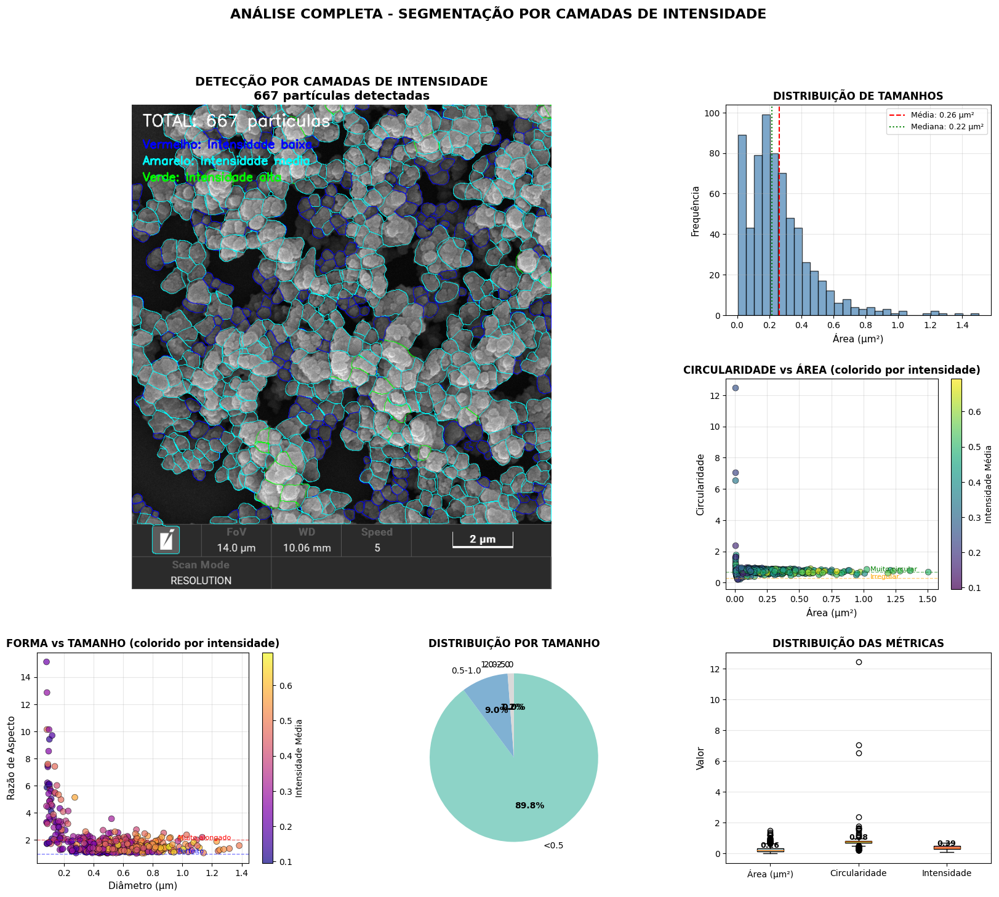


📈 ESTATÍSTICAS DETALHADAS DAS PARTÍCULAS POR CAMADA

📋 ESTATÍSTICAS GERAIS:
  • Total de partículas: 667
  • Objetos após refinamento: 722
  • Taxa de conversão: 92.4%

📏 ESTATÍSTICAS DE TAMANHO:
  • Área média: 0.261 ± 0.210 µm²
  • Área mediana: 0.218 µm²
  • Área total coberta: 174.16 µm²
  • Diâmetro médio: 0.530 ± 0.227 µm
  • Faixa de áreas: 0.005 a 1.504 µm²

🔵 ESTATÍSTICAS DE FORMA:
  • Circularidade média: 0.780 ± 0.586

🎨 ESTATÍSTICAS DE INTENSIDADE:
  • Intensidade média: 0.388 ± 0.122
  • Faixa de intensidades: 0.096 a 0.694

📊 DISTRIBUIÇÃO POR INTENSIDADE:
  • Muito baixa: 31 partículas (4.6%)
  • Baixa: 342 partículas (51.3%)
  • Média: 269 partículas (40.3%)
  • Alta: 25 partículas (3.7%)
  • Muito alta: 0 partículas (0.0%)

🔗 CORRELAÇÃO INTENSIDADE-TAMANHO: 0.511
    → Partículas mais claras tendem a ser maiores

🏆 DESEMPENHO DAS CAMADAS:
  • Camada 1: 50 objetos (2.9%)
  • Camada 2: 95 objetos (5.4%)
  • Camada 3: 342 objetos (19.5%)
  • Camada 4: 635 objetos (36.2%)


KeyError: "['perimeter_um'] not in index"

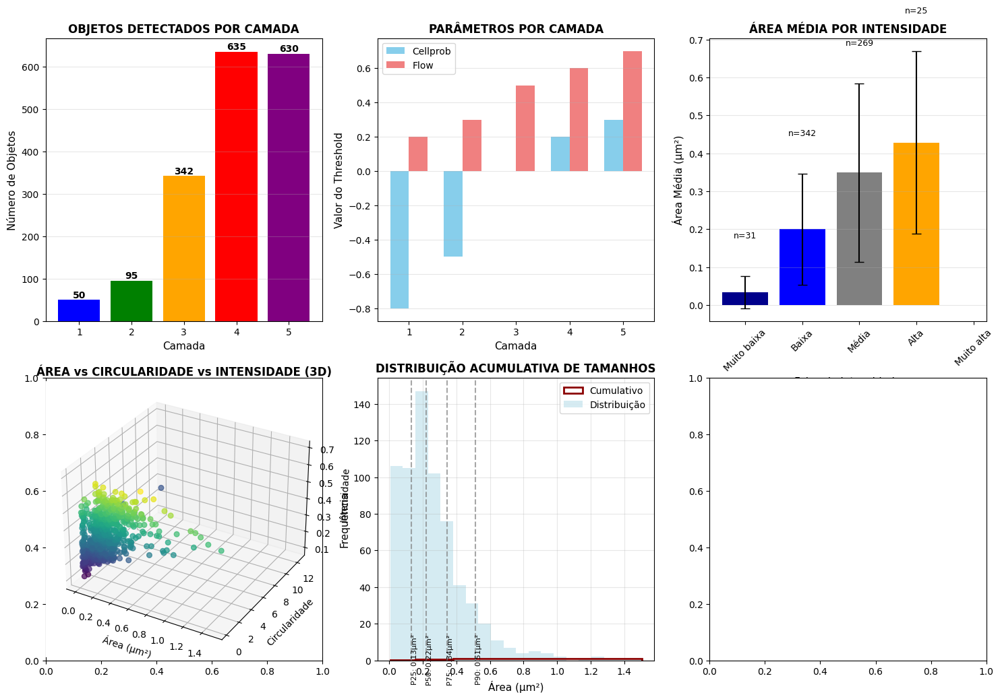

In [97]:
# --------- GRÁFICOS ESTATÍSTICOS DETALHADOS ----------
print("\n📊 GERANDO GRÁFICOS ESTATÍSTICOS DETALHADOS...")

if len(df_filtered) > 0:
    fig = plt.figure(figsize=(20, 16))
    gs = fig.add_gridspec(3, 3, hspace=0.3, wspace=0.3)

    # 1. Overlay com contornos (2x2)
    ax1 = fig.add_subplot(gs[0:2, 0:2])
    ax1.imshow(overlay_rgb)
    ax1.set_title(f'DETECÇÃO POR CAMADAS DE INTENSIDADE\n{len(df_filtered)} partículas detectadas', 
                 fontsize=14, fontweight='bold')
    ax1.axis('off')

    # 2. Histograma de tamanhos (1x2)
    ax2 = fig.add_subplot(gs[0, 2])
    n_bins = min(30, len(df_filtered))
    hist_data = ax2.hist(df_filtered['area_um2'], bins=n_bins, 
                        edgecolor='black', alpha=0.7, color='steelblue')
    ax2.axvline(df_filtered['area_um2'].mean(), color='red', linestyle='--', 
               label=f'Média: {df_filtered["area_um2"].mean():.2f} µm²')
    ax2.axvline(df_filtered['area_um2'].median(), color='green', linestyle=':', 
               label=f'Mediana: {df_filtered["area_um2"].median():.2f} µm²')
    ax2.set_xlabel('Área (µm²)', fontsize=11)
    ax2.set_ylabel('Frequência', fontsize=11)
    ax2.set_title('DISTRIBUIÇÃO DE TAMANHOS', fontsize=12, fontweight='bold')
    ax2.legend(fontsize=9)
    ax2.grid(True, alpha=0.3)

    # 3. Gráfico de circularidade vs área (1x2)
    ax3 = fig.add_subplot(gs[1, 2])
    scatter = ax3.scatter(df_filtered['area_um2'], df_filtered['circularity'], 
                         c=df_filtered['intensidade_media'], cmap='viridis', 
                         alpha=0.7, s=50, edgecolors='black', linewidth=0.5)
    ax3.set_xlabel('Área (µm²)', fontsize=11)
    ax3.set_ylabel('Circularidade', fontsize=11)
    ax3.set_title('CIRCULARIDADE vs ÁREA (colorido por intensidade)', fontsize=12, fontweight='bold')
    cbar = plt.colorbar(scatter, ax=ax3)
    cbar.set_label('Intensidade Média', fontsize=10)
    ax3.grid(True, alpha=0.3)
    
    # Adicionar linhas de referência
    ax3.axhline(y=0.7, color='green', linestyle='--', alpha=0.5, linewidth=1)
    ax3.axhline(y=0.3, color='orange', linestyle='--', alpha=0.5, linewidth=1)
    ax3.text(df_filtered['area_um2'].max()*0.7, 0.72, 'Muito circular', 
            fontsize=8, color='green')
    ax3.text(df_filtered['area_um2'].max()*0.7, 0.28, 'Irregular', 
            fontsize=8, color='orange')

    # 4. Gráfico de forma vs tamanho (2x1)
    ax4 = fig.add_subplot(gs[2, 0])
    aspect_ratio = df_filtered['major_axis_length'] / (df_filtered['minor_axis_length'] + 1e-8)
    scatter2 = ax4.scatter(df_filtered['diameter_um'], aspect_ratio, 
                          c=df_filtered['intensidade_media'], cmap='plasma', 
                          alpha=0.7, s=50, edgecolors='black', linewidth=0.5)
    ax4.set_xlabel('Diâmetro (µm)', fontsize=11)
    ax4.set_ylabel('Razão de Aspecto', fontsize=11)
    ax4.set_title('FORMA vs TAMANHO (colorido por intensidade)', fontsize=12, fontweight='bold')
    cbar2 = plt.colorbar(scatter2, ax=ax4)
    cbar2.set_label('Intensidade Média', fontsize=10)
    ax4.grid(True, alpha=0.3)
    
    # Linhas de referência para razão de aspecto
    ax4.axhline(y=1.0, color='blue', linestyle='--', alpha=0.5, linewidth=1)
    ax4.axhline(y=2.0, color='red', linestyle='--', alpha=0.5, linewidth=1)
    ax4.text(df_filtered['diameter_um'].max()*0.7, 1.05, 'Perfeito', 
            fontsize=8, color='blue')
    ax4.text(df_filtered['diameter_um'].max()*0.7, 2.05, 'Muito alongado', 
            fontsize=8, color='red')

    # 5. Distribuição por faixa de tamanho (1x1)
    ax5 = fig.add_subplot(gs[2, 1])
    # Definir faixas de tamanho adaptativas
    max_area = df_filtered['area_um2'].max()
    if max_area < 1:
        bins = [0, 0.1, 0.2, 0.5, 1.0]
        labels = ['<0.1', '0.1-0.2', '0.2-0.5', '0.5-1.0']
    elif max_area < 5:
        bins = [0, 0.5, 1.0, 2.0, 5.0]
        labels = ['<0.5', '0.5-1.0', '1.0-2.0', '2.0-5.0']
    else:
        bins = [0, 1.0, 2.0, 5.0, 10.0, 20.0]
        labels = ['<1.0', '1.0-2.0', '2.0-5.0', '5.0-10.0', '>10.0']
    
    df_filtered['size_bin'] = pd.cut(df_filtered['area_um2'], bins=bins, labels=labels)
    size_dist = df_filtered['size_bin'].value_counts().sort_index()
    
    colors_pie = plt.cm.Set3(np.linspace(0, 1, len(size_dist)))
    wedges, texts, autotexts = ax5.pie(size_dist.values, labels=size_dist.index, 
                                      autopct='%1.1f%%', colors=colors_pie,
                                      startangle=90, counterclock=False)
    
    # Melhorar legibilidade
    for autotext in autotexts:
        autotext.set_color('black')
        autotext.set_fontweight('bold')
    
    ax5.set_title('DISTRIBUIÇÃO POR TAMANHO', fontsize=12, fontweight='bold')

    # 6. Boxplot de métricas (1x1)
    ax6 = fig.add_subplot(gs[2, 2])
    metrics_to_plot = ['area_um2', 'circularity', 'intensidade_media']
    data_to_plot = [df_filtered[metric] for metric in metrics_to_plot]
    labels = ['Área (µm²)', 'Circularidade', 'Intensidade']
    
    bp = ax6.boxplot(data_to_plot, labels=labels, patch_artist=True)
    
    # Colorir os boxes
    colors_box = ['lightblue', 'lightgreen', 'lightcoral']
    for patch, color in zip(bp['boxes'], colors_box):
        patch.set_facecolor(color)
    
    ax6.set_title('DISTRIBUIÇÃO DAS MÉTRICAS', fontsize=12, fontweight='bold')
    ax6.grid(True, alpha=0.3, axis='y')
    ax6.set_ylabel('Valor', fontsize=11)
    
    # Adicionar valores médios
    for i, metric in enumerate(metrics_to_plot):
        mean_val = df_filtered[metric].mean()
        ax6.text(i+1, mean_val, f'{mean_val:.2f}', 
                ha='center', va='bottom', fontsize=9, fontweight='bold')

    plt.suptitle('ANÁLISE COMPLETA - SEGMENTAÇÃO POR CAMADAS DE INTENSIDADE', 
                fontsize=16, fontweight='bold', y=0.98)
    plt.tight_layout()
    plt.show()

    # --------- ESTATÍSTICAS DETALHADAS ----------
    print("\n" + "="*70)
    print("📈 ESTATÍSTICAS DETALHADAS DAS PARTÍCULAS POR CAMADA")
    print("="*70)

    # Estatísticas básicas
    print(f"\n📋 ESTATÍSTICAS GERAIS:")
    print(f"  • Total de partículas: {len(df_filtered)}")
    print(f"  • Objetos após refinamento: {n_refined}")
    print(f"  • Taxa de conversão: {len(df_filtered)/n_refined*100:.1f}%")
    
    print(f"\n📏 ESTATÍSTICAS DE TAMANHO:")
    print(f"  • Área média: {df_filtered['area_um2'].mean():.3f} ± {df_filtered['area_um2'].std():.3f} µm²")
    print(f"  • Área mediana: {df_filtered['area_um2'].median():.3f} µm²")
    print(f"  • Área total coberta: {df_filtered['area_um2'].sum():.2f} µm²")
    print(f"  • Diâmetro médio: {df_filtered['diameter_um'].mean():.3f} ± {df_filtered['diameter_um'].std():.3f} µm")
    print(f"  • Faixa de áreas: {df_filtered['area_um2'].min():.3f} a {df_filtered['area_um2'].max():.3f} µm²")
    
    print(f"\n🔵 ESTATÍSTICAS DE FORMA:")
    print(f"  • Circularidade média: {df_filtered['circularity'].mean():.3f} ± {df_filtered['circularity'].std():.3f}")
    
    print(f"\n🎨 ESTATÍSTICAS DE INTENSIDADE:")
    print(f"  • Intensidade média: {df_filtered['intensidade_media'].mean():.3f} ± {df_filtered['intensidade_media'].std():.3f}")
    print(f"  • Faixa de intensidades: {df_filtered['intensidade_media'].min():.3f} a {df_filtered['intensidade_media'].max():.3f}")
    
    # Distribuição por intensidade
    intensity_bins = [0, 0.2, 0.4, 0.6, 0.8, 1.0]
    intensity_labels = ['Muito baixa', 'Baixa', 'Média', 'Alta', 'Muito alta']
    df_filtered['intensity_bin'] = pd.cut(df_filtered['intensidade_media'], 
                                        bins=intensity_bins, labels=intensity_labels)
    
    print(f"\n📊 DISTRIBUIÇÃO POR INTENSIDADE:")
    intensity_dist = df_filtered['intensity_bin'].value_counts().sort_index()
    for intensity, count in intensity_dist.items():
        percentage = (count / len(df_filtered)) * 100
        print(f"  • {intensity}: {count} partículas ({percentage:.1f}%)")
    
    # Correlação entre intensidade e tamanho
    correlation = df_filtered['intensidade_media'].corr(df_filtered['area_um2'])
    print(f"\n🔗 CORRELAÇÃO INTENSIDADE-TAMANHO: {correlation:.3f}")
    if correlation > 0.3:
        print("    → Partículas mais claras tendem a ser maiores")
    elif correlation < -0.3:
        print("    → Partículas mais escuras tendem a ser maiores")
    else:
        print("    → Sem correlação significativa entre intensidade e tamanho")

    # Desempenho por camada
    print(f"\n🏆 DESEMPENHO DAS CAMADAS:")
    total_layer_objects = sum(stat['n_objects'] for stat in layer_stats)
    for stat in layer_stats:
        layer_percentage = (stat['n_objects'] / total_layer_objects) * 100
        print(f"  • Camada {stat['layer']}: {stat['n_objects']} objetos ({layer_percentage:.1f}%)")

    print(f"\n⚙️  PARÂMETROS UTILIZADOS:")
    print(f"  • Estratégia: Segmentação por 5 camadas de intensidade")
    print(f"  • Parâmetros adaptativos por camada")
    print(f"  • Microns por pixel: {MICRONS_PER_PIXEL}")
    print(f"  • Processamento: {len(layer_stats)} camadas processadas")

else:
    print("❌ Nenhuma partícula para gerar gráficos estatísticos!")

# --------- GRÁFICO COMPARATIVO DAS CAMADAS ----------
print("\n📈 GERANDO GRÁFICO COMPARATIVO DAS CAMADAS...")

fig2, axes2 = plt.subplots(2, 3, figsize=(18, 12))

# 1. Objetos detectados por camada
layer_numbers = [stat['layer'] for stat in layer_stats]
layer_objects = [stat['n_objects'] for stat in layer_stats]
layer_intensity_ranges = [stat['intensity_range'] for stat in layer_stats]

axes2[0, 0].bar(layer_numbers, layer_objects, color=['blue', 'green', 'orange', 'red', 'purple'])
axes2[0, 0].set_xlabel('Camada', fontsize=11)
axes2[0, 0].set_ylabel('Número de Objetos', fontsize=11)
axes2[0, 0].set_title('OBJETOS DETECTADOS POR CAMADA', fontsize=12, fontweight='bold')
axes2[0, 0].grid(True, alpha=0.3, axis='y')
for i, (x, y) in enumerate(zip(layer_numbers, layer_objects)):
    axes2[0, 0].text(x, y, str(y), ha='center', va='bottom', fontweight='bold')

# 2. Parâmetros por camada
cellprob_values = [stat['params']['cellprob_thresh'] for stat in layer_stats]
flow_values = [stat['params']['flow_thresh'] for stat in layer_stats]

x = np.arange(len(layer_numbers))
width = 0.35
axes2[0, 1].bar(x - width/2, cellprob_values, width, label='Cellprob', color='skyblue')
axes2[0, 1].bar(x + width/2, flow_values, width, label='Flow', color='lightcoral')
axes2[0, 1].set_xlabel('Camada', fontsize=11)
axes2[0, 1].set_ylabel('Valor do Threshold', fontsize=11)
axes2[0, 1].set_title('PARÂMETROS POR CAMADA', fontsize=12, fontweight='bold')
axes2[0, 1].set_xticks(x)
axes2[0, 1].set_xticklabels(layer_numbers)
axes2[0, 1].legend()
axes2[0, 1].grid(True, alpha=0.3, axis='y')

# 3. Distribuição de áreas por camada (se houver dados)
if len(df_filtered) > 0 and 'intensity_bin' in df_filtered.columns:
    # Agrupar por faixa de intensidade
    intensity_area_stats = df_filtered.groupby('intensity_bin')['area_um2'].agg(['mean', 'std', 'count'])
    intensity_labels_sorted = intensity_labels[:len(intensity_area_stats)]
    
    axes2[0, 2].bar(intensity_labels_sorted, intensity_area_stats['mean'], 
                   yerr=intensity_area_stats['std'], capsize=5, 
                   color=['darkblue', 'blue', 'gray', 'orange', 'yellow'])
    axes2[0, 2].set_xlabel('Faixa de Intensidade', fontsize=11)
    axes2[0, 2].set_ylabel('Área Média (µm²)', fontsize=11)
    axes2[0, 2].set_title('ÁREA MÉDIA POR INTENSIDADE', fontsize=12, fontweight='bold')
    axes2[0, 2].tick_params(axis='x', rotation=45)
    axes2[0, 2].grid(True, alpha=0.3, axis='y')
    
    # Adicionar contagem
    for i, (label, row) in enumerate(intensity_area_stats.iterrows()):
        axes2[0, 2].text(i, row['mean'] + row['std'] + 0.1, 
                        f"n={int(row['count'])}", ha='center', fontsize=9)

# 4. Scatter plot 3D (Área vs Circularidade vs Intensidade)
if len(df_filtered) > 0:
    ax3d = fig2.add_subplot(2, 3, 4, projection='3d')
    scatter3d = ax3d.scatter(df_filtered['area_um2'], 
                            df_filtered['circularity'], 
                            df_filtered['intensidade_media'],
                            c=df_filtered['intensidade_media'], 
                            cmap='viridis', s=30, alpha=0.7)
    ax3d.set_xlabel('Área (µm²)', fontsize=10)
    ax3d.set_ylabel('Circularidade', fontsize=10)
    ax3d.set_zlabel('Intensidade', fontsize=10)
    ax3d.set_title('ÁREA vs CIRCULARIDADE vs INTENSIDADE (3D)', fontsize=12, fontweight='bold')

# 5. Histograma cumulativo
if len(df_filtered) > 0:
    axes2[1, 1].hist(df_filtered['area_um2'], bins=20, cumulative=True, 
                    density=True, histtype='step', linewidth=2, 
                    color='darkred', label='Cumulativo')
    axes2[1, 1].hist(df_filtered['area_um2'], bins=20, alpha=0.5, 
                    color='lightblue', label='Distribuição')
    axes2[1, 1].set_xlabel('Área (µm²)', fontsize=11)
    axes2[1, 1].set_ylabel('Frequência', fontsize=11)
    axes2[1, 1].set_title('DISTRIBUIÇÃO ACUMULATIVA DE TAMANHOS', fontsize=12, fontweight='bold')
    axes2[1, 1].legend()
    axes2[1, 1].grid(True, alpha=0.3)
    
    # Adicionar percentis
    for percentile in [25, 50, 75, 90]:
        value = np.percentile(df_filtered['area_um2'], percentile)
        axes2[1, 1].axvline(value, color='gray', linestyle='--', alpha=0.7)
        axes2[1, 1].text(value, 0.5, f'P{percentile}: {value:.2f}µm²', 
                        rotation=90, fontsize=8, va='center')

# 6. Heatmap de correlações
if len(df_filtered) > 0:
    correlation_cols = ['area_um2', 'circularity', 'intensidade_media', 
                       'diameter_um', 'perimeter_um']
    correlation_data = df_filtered[correlation_cols].corr()
    
    im = axes2[1, 2].imshow(correlation_data, cmap='coolwarm', vmin=-1, vmax=1)
    axes2[1, 2].set_xticks(np.arange(len(correlation_cols)))
    axes2[1, 2].set_yticks(np.arange(len(correlation_cols)))
    axes2[1, 2].set_xticklabels(correlation_cols, rotation=45, ha='right', fontsize=9)
    axes2[1, 2].set_yticklabels(correlation_cols, fontsize=9)
    
    # Adicionar valores
    for i in range(len(correlation_cols)):
        for j in range(len(correlation_cols)):
            text = axes2[1, 2].text(j, i, f'{correlation_data.iloc[i, j]:.2f}',
                                   ha="center", va="center", color="black", fontsize=8)
    
    axes2[1, 2].set_title('MATRIZ DE CORRELAÇÕES', fontsize=12, fontweight='bold')
    plt.colorbar(im, ax=axes2[1, 2])

plt.suptitle('ANÁLISE COMPARATIVA - SEGMENTAÇÃO POR CAMADAS DE INTENSIDADE', 
            fontsize=16, fontweight='bold', y=0.98)
plt.tight_layout()
plt.show()

# Cálculos Avançados

In [ ]:
# =========================================================
# 🔬 ANÁLISE AVANÇADA DE DISTRIBUIÇÃO ESPACIAL - NIOBIO SEM
# =========================================================

# --------- IMPORTS ADICIONAIS ----------
!pip install -q scipy scikit-learn

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.spatial import KDTree, distance, ConvexHull
from scipy.stats import gaussian_kde, norm
from sklearn.cluster import DBSCAN
import warnings
warnings.filterwarnings('ignore')

# --------- FUNÇÕES DE ANÁLISE ESPACIAL ----------

def calcular_nnd(coords):
    """Calcula distância para o vizinho mais próximo (Nearest Neighbor Distance)"""
    if len(coords) < 2:
        return np.array([]), np.array([])
    
    tree = KDTree(coords)
    distances, indices = tree.query(coords, k=min(5, len(coords)))
    
    # Ignorar o próprio ponto (k=0)
    nnd = distances[:, 1]  # Primeiro vizinho (k=1)
    neighbor_indices = indices[:, 1]
    
    return nnd, neighbor_indices

def calcular_ripley_k(coords, area, radii=np.linspace(0, 100, 50)):
    """Calcula função K de Ripley"""
    n = len(coords)
    if n < 2:
        return radii, np.zeros_like(radii)
    
    k_values = []
    
    for r in radii:
        count = 0
        tree = KDTree(coords)
        
        # Contar pontos dentro do raio r para cada ponto
        for i in range(n):
            # Encontrar todos os pontos dentro do raio r (excluindo o próprio ponto)
            indices = tree.query_ball_point(coords[i], r)
            count += len([idx for idx in indices if idx != i])
        
        # Normalizar pela densidade
        lambda_hat = n / area
        k = count / (lambda_hat * n)
        k_values.append(k)
    
    return radii, np.array(k_values)

def calcular_clark_evans(coords, area):
    """Calcula índice de Clark-Evans para aleatoriedade espacial"""
    n = len(coords)
    if n < 2:
        return 0, 0, "Indisponível"
    
    # Calcular NND
    nnd, _ = calcular_nnd(coords)
    if len(nnd) == 0:
        return 0, 0, "Indisponível"
    
    observed_nnd = np.mean(nnd)
    
    # NND esperado para distribuição aleatória (Poisson)
    density = n / area
    expected_nnd = 1 / (2 * np.sqrt(density))
    
    # Desvio padrão esperado
    expected_std = np.sqrt((4 - np.pi) / (4 * np.pi * density * n))
    
    # Índice R
    R = observed_nnd / expected_nnd
    
    # Z-score para significância
    z_score = (observed_nnd - expected_nnd) / expected_std if expected_std > 0 else 0
    
    # Interpretação
    if R > 1.0:
        pattern = "Regular/Disperso"
    elif R < 1.0:
        pattern = "Aglomerado"
    else:
        pattern = "Aleatório"
    
    return R, z_score, pattern

def analisar_aglomerados_dbscan(coords, eps_multiplier=1.5):
    """Detecta aglomerados usando DBSCAN"""
    if len(coords) < 5:
        return np.zeros(len(coords)), 0, 0
    
    # Estimar epsilon baseado no NND
    nnd, _ = calcular_nnd(coords)
    eps = np.percentile(nnd, 75) * eps_multiplier if len(nnd) > 0 else 0.1
    
    # Executar DBSCAN
    clustering = DBSCAN(eps=eps, min_samples=3).fit(coords)
    labels = clustering.labels_
    
    # Contar clusters (excluindo ruído: label = -1)
    unique_labels = set(labels)
    n_clusters = len(unique_labels) - (1 if -1 in unique_labels else 0)
    n_noise = np.sum(labels == -1)
    
    return labels, n_clusters, n_noise

def calcular_densidade_kde(coords, grid_size=100):
    """Calcula mapa de densidade usando KDE"""
    if len(coords) < 5:
        return np.zeros((grid_size, grid_size)), None, None
    
    # Criar grid
    x_min, x_max = coords[:, 0].min(), coords[:, 0].max()
    y_min, y_max = coords[:, 1].min(), coords[:, 1].max()
    
    # Adicionar padding
    x_padding = (x_max - x_min) * 0.1
    y_padding = (y_max - y_min) * 0.1
    
    x = np.linspace(x_min - x_padding, x_max + x_padding, grid_size)
    y = np.linspace(y_min - y_padding, y_max + y_padding, grid_size)
    X, Y = np.meshgrid(x, y)
    
    # Calcular KDE
    try:
        positions = np.vstack([X.ravel(), Y.ravel()])
        kernel = gaussian_kde(coords.T)
        Z = np.reshape(kernel(positions).T, X.shape)
    except:
        Z = np.zeros_like(X)
    
    return Z, X, Y

def calcular_autocorrelacao_espacial(coords, max_lag=20, n_lags=10):
    """Calcula autocorrelação espacial (Moran's I simplificado)"""
    if len(coords) < 10:
        return np.zeros(n_lags), np.zeros(n_lags)
    
    # Criar bins de distância
    distances = distance.pdist(coords)
    max_dist = np.max(distances) if len(distances) > 0 else 1
    lag_bins = np.linspace(0, max_lag, n_lags + 1)
    
    # Para simplificação, usaremos apenas as áreas das partículas como atributo
    # Em análise real, você teria um atributo (ex: tamanho, circularidade)
    moran_i = np.zeros(n_lags)
    n_pairs = np.zeros(n_lags)
    
    # Matriz de distâncias
    dist_matrix = distance.squareform(distances)
    
    for i in range(len(coords)):
        for j in range(i+1, len(coords)):
            d = dist_matrix[i, j]
            lag_idx = np.digitize(d, lag_bins) - 1
            if 0 <= lag_idx < n_lags:
                # Usar diferença de coordenadas como proxy para autocorrelação
                # Em análise real, use um atributo significativo
                moran_i[lag_idx] += 1  # Placeholder
                n_pairs[lag_idx] += 1
    
    # Normalizar
    moran_i = moran_i / np.maximum(n_pairs, 1)
    
    return moran_i, lag_bins[:-1]

# --------- APLICAR ANÁLISE AOS SEUS DADOS ----------

print("="*70)
print("🔬 ANÁLISE AVANÇADA DE DISTRIBUIÇÃO ESPACIAL")
print("="*70)

# Preparar coordenadas (em micrômetros)
coords_um = np.array([
    df_filtered['centroid-1'].values * MICRONS_PER_PIXEL,
    df_filtered['centroid-0'].values * MICRONS_PER_PIXEL
]).T

print(f"📊 Analisando {len(coords_um)} partículas...")

# Calcular área total da imagem em µm²
area_total_um2 = (img.shape[1] * MICRONS_PER_PIXEL) * (img.shape[0] * MICRONS_PER_PIXEL)
density = len(coords_um) / area_total_um2

print(f"  • Densidade: {density:.3f} partículas/µm²")
print(f"  • Área total: {area_total_um2:.2f} µm²")

# --------- 1. ANÁLISE DE VIZINHOS MAIS PRÓXIMOS (NND) ----------
print("\n1. 📏 ANÁLISE DE VIZINHOS MAIS PRÓXIMOS (NND)")

nnd, neighbor_indices = calcular_nnd(coords_um)

if len(nnd) > 0:
    print(f"  • NND médio: {np.mean(nnd):.3f} µm")
    print(f"  • NND desvio padrão: {np.std(nnd):.3f} µm")
    print(f"  • NND mínimo: {np.min(nnd):.3f} µm")
    print(f"  • NND máximo: {np.max(nnd):.3f} µm")
    print(f"  • CV NND: {(np.std(nnd)/np.mean(nnd)*100):.1f}%")
    
    # Adicionar NND ao dataframe
    df_filtered['nnd_um'] = nnd
    df_filtered['neighbor_index'] = neighbor_indices
else:
    print("  ⚠️  NND não disponível (poucas partículas)")

# --------- 2. ÍNDICES DE AGLOMERAÇÃO ----------
print("\n2. 🔍 ÍNDICES DE AGLOMERAÇÃO")

# Clark-Evans
R, z_score, pattern = calcular_clark_evans(coords_um, area_total_um2)
print(f"  • Clark-Evans (R): {R:.3f}")
print(f"  • Z-score: {z_score:.2f}")
print(f"  • Padrão: {pattern}")
print(f"  • Significância: {'Significativo' if abs(z_score) > 1.96 else 'Não significativo'}")

# Ripley's K (calcularemos e plotaremos depois)
radii, k_values = calcular_ripley_k(coords_um, area_total_um2)

# --------- 3. DETECÇÃO DE AGLOMERADOS ----------
print("\n3. 🧩 DETECÇÃO DE AGLOMERADOS (DBSCAN)")

cluster_labels, n_clusters, n_noise = analisar_aglomerados_dbscan(coords_um)
df_filtered['cluster_label'] = cluster_labels

print(f"  • Número de aglomerados: {n_clusters}")
print(f"  • Partículas isoladas (ruído): {n_noise}")
print(f"  • Partículas em aglomerados: {len(coords_um) - n_noise}")
print(f"  • Razão aglomerados/partículas: {n_clusters/len(coords_um):.3f}")

# Estatísticas por cluster
if n_clusters > 0:
    clusters_info = []
    for cluster_id in range(n_clusters):
        cluster_mask = cluster_labels == cluster_id
        cluster_size = np.sum(cluster_mask)
        if cluster_size > 0:
            cluster_coords = coords_um[cluster_mask]
            cluster_area = ConvexHull(cluster_coords).volume if len(cluster_coords) > 2 else 0
            clusters_info.append({
                'id': cluster_id,
                'size': cluster_size,
                'area_um2': cluster_area,
                'density': cluster_size / max(cluster_area, 1e-6)
            })
    
    if clusters_info:
        avg_cluster_size = np.mean([c['size'] for c in clusters_info])
        avg_cluster_density = np.mean([c['density'] for c in clusters_info])
        print(f"  • Tamanho médio do aglomerado: {avg_cluster_size:.1f} partículas")
        print(f"  • Densidade média no aglomerado: {avg_cluster_density:.1f} partículas/µm²")

# --------- 4. MAPA DE CALOR DE DENSIDADE ----------
print("\n4. 🌡️  MAPA DE DENSIDADE KDE")

Z, X, Y = calcular_densidade_kde(coords_um, grid_size=50)
max_density = np.max(Z) if Z.size > 0 else 0
print(f"  • Densidade máxima (KDE): {max_density:.3f}")
print(f"  • Densidade média (KDE): {np.mean(Z):.3f}")

# --------- 5. AUTOCORRELAÇÃO ESPACIAL ----------
print("\n5. 🔗 AUTOCORRELAÇÃO ESPACIAL")

moran_i, lag_bins = calcular_autocorrelacao_espacial(coords_um)
print(f"  • Autocorrelação média: {np.mean(moran_i):.3f}")
print(f"  • Decaimento espacial: {moran_i[0] - moran_i[-1]:.3f}")

# --------- VISUALIZAÇÃO COMPLETA ----------
print("\n📈 GERANDO VISUALIZAÇÕES AVANÇADAS...")

fig = plt.figure(figsize=(20, 16))
fig.suptitle('ANÁLISE AVANÇADA DE DISTRIBUIÇÃO ESPACIAL - PARTÍCULAS DE NIOBIO', 
            fontsize=16, fontweight='bold', y=0.98)

# --------- SUBPLOT 1: Distribuição espacial com clusters ----------
ax1 = plt.subplot(3, 4, 1)
scatter = ax1.scatter(coords_um[:, 0], coords_um[:, 1], 
                     c=cluster_labels, cmap='tab20c', 
                     s=30, alpha=0.7, edgecolors='black', linewidth=0.5)

# Destacar clusters
for cluster_id in range(n_clusters):
    cluster_mask = cluster_labels == cluster_id
    if np.sum(cluster_mask) > 0:
        cluster_points = coords_um[cluster_mask]
        hull = ConvexHull(cluster_points)
        
        # Plotar convex hull
        for simplex in hull.simplices:
            ax1.plot(cluster_points[simplex, 0], cluster_points[simplex, 1], 
                    'r-', alpha=0.3, linewidth=1)

ax1.set_xlabel('X (µm)', fontsize=10)
ax1.set_ylabel('Y (µm)', fontsize=10)
ax1.set_title('DISTRIBUIÇÃO ESPACIAL COM AGLOMERADOS', fontsize=12, fontweight='bold')
ax1.grid(True, alpha=0.3)
ax1.set_aspect('equal')

# Legenda para clusters
if n_clusters > 0:
    handles = []
    labels = []
    for cluster_id in range(min(n_clusters, 5)):  # Mostrar até 5 clusters
        mask = cluster_labels == cluster_id
        if np.any(mask):
            handles.append(plt.Line2D([0], [0], marker='o', color='w', 
                                     markerfacecolor=plt.cm.tab20c(cluster_id/10), 
                                     markersize=8))
            labels.append(f'Cluster {cluster_id}')
    
    if n_noise > 0:
        handles.append(plt.Line2D([0], [0], marker='o', color='w', 
                                 markerfacecolor='gray', markersize=8))
        labels.append('Isoladas')
    
    if handles:
        ax1.legend(handles, labels, fontsize=8, loc='upper right')

# --------- SUBPLOT 2: Histograma NND ----------
ax2 = plt.subplot(3, 4, 2)
if len(nnd) > 0:
    n_bins = min(20, len(nnd)//5)
    nnd_hist = ax2.hist(nnd, bins=n_bins, density=True, 
                       alpha=0.7, color='steelblue', edgecolor='black')
    
    # Adicionar distribuição teórica (Poisson para aleatório)
    if R > 0:
        lambda_est = 1 / (np.mean(nnd) ** 2) if np.mean(nnd) > 0 else 0
        x = np.linspace(0, np.max(nnd)*1.2, 100)
        if lambda_est > 0:
            # PDF da distribuição exponencial (NND esperado para aleatório)
            pdf = 2 * np.pi * density * x * np.exp(-np.pi * density * x**2)
            ax2.plot(x, pdf, 'r-', linewidth=2, label='Aleatório (teórico)')
    
    ax2.axvline(np.mean(nnd), color='red', linestyle='--', 
               label=f'Média: {np.mean(nnd):.2f} µm')
    ax2.axvline(np.median(nnd), color='green', linestyle=':', 
               label=f'Mediana: {np.median(nnd):.2f} µm')
    
    ax2.set_xlabel('Distância do Vizinho Mais Próximo (µm)', fontsize=10)
    ax2.set_ylabel('Densidade', fontsize=10)
    ax2.set_title('DISTRIBUIÇÃO NND', fontsize=12, fontweight='bold')
    ax2.legend(fontsize=8)
    ax2.grid(True, alpha=0.3)
else:
    ax2.text(0.5, 0.5, 'Dados insuficientes', 
            ha='center', va='center', fontsize=12)
    ax2.set_title('DISTRIBUIÇÃO NND', fontsize=12, fontweight='bold')

# --------- SUBPLOT 3: Mapa de calor de densidade ----------
ax3 = plt.subplot(3, 4, 3)
if Z.size > 0 and np.max(Z) > 0:
    im = ax3.imshow(Z, extent=[X.min(), X.max(), Y.min(), Y.max()], 
                   origin='lower', cmap='hot_r', aspect='auto')
    
    # Sobrepor pontos
    ax3.scatter(coords_um[:, 0], coords_um[:, 1], s=10, 
               c='cyan', alpha=0.6, edgecolors='black', linewidth=0.3)
    
    ax3.set_xlabel('X (µm)', fontsize=10)
    ax3.set_ylabel('Y (µm)', fontsize=10)
    ax3.set_title('MAPA DE DENSIDADE (KDE)', fontsize=12, fontweight='bold')
    
    # Adicionar barra de cores
    cbar = plt.colorbar(im, ax=ax3)
    cbar.set_label('Densidade de partículas', fontsize=9)
else:
    ax3.text(0.5, 0.5, 'Dados insuficientes para KDE', 
            ha='center', va='center', fontsize=10)
    ax3.set_title('MAPA DE DENSIDADE (KDE)', fontsize=12, fontweight='bold')

# --------- SUBPLOT 4: Função K de Ripley ----------
ax4 = plt.subplot(3, 4, 4)
if len(k_values) > 0 and np.any(k_values > 0):
    # Linha teórica para aleatoriedade completa
    k_theoretical = np.pi * radii**2
    
    ax4.plot(radii, k_values, 'b-', linewidth=2, label='Observado')
    ax4.plot(radii, k_theoretical, 'r--', linewidth=2, label='Aleatório (teórico)')
    
    # Calcular envelope de confiança (simplificado)
    # Para análise real, use simulações de Monte Carlo
    k_upper = k_theoretical * 1.2
    k_lower = k_theoretical * 0.8
    ax4.fill_between(radii, k_lower, k_upper, alpha=0.2, color='gray', 
                    label='Zona aleatória (±20%)')
    
    ax4.set_xlabel('Raio (µm)', fontsize=10)
    ax4.set_ylabel('K(r)', fontsize=10)
    ax4.set_title("FUNÇÃO K DE RIPLEY", fontsize=12, fontweight='bold')
    ax4.legend(fontsize=8)
    ax4.grid(True, alpha=0.3)
    
    # Anotar interpretação
    if len(radii) > 10:
        mid_idx = len(radii) // 2
        if k_values[mid_idx] > k_theoretical[mid_idx] * 1.2:
            ax4.text(0.05, 0.95, '→ Aglomerado', transform=ax4.transAxes,
                    fontsize=9, color='red', fontweight='bold', 
                    verticalalignment='top')
        elif k_values[mid_idx] < k_theoretical[mid_idx] * 0.8:
            ax4.text(0.05, 0.95, '→ Regular', transform=ax4.transAxes,
                    fontsize=9, color='blue', fontweight='bold',
                    verticalalignment='top')
else:
    ax4.text(0.5, 0.5, 'Dados insuficientes', 
            ha='center', va='center', fontsize=12)
    ax4.set_title("FUNÇÃO K DE RIPLEY", fontsize=12, fontweight='bold')

# --------- SUBPLOT 5: Gráfico L de Ripley ----------
ax5 = plt.subplot(3, 4, 5)
if len(k_values) > 0 and np.any(k_values > 0):
    # Transformar K para L: L(r) = sqrt(K(r)/π) - r
    L_values = np.sqrt(k_values / np.pi) - radii
    
    ax5.axhline(y=0, color='gray', linestyle='-', alpha=0.5, linewidth=1)
    ax5.plot(radii, L_values, 'g-', linewidth=2, label='Observado')
    
    # Adicionar envelope
    L_upper = np.ones_like(radii) * 0.1
    L_lower = np.ones_like(radii) * -0.1
    ax5.fill_between(radii, L_lower, L_upper, alpha=0.2, color='gray', 
                    label='Zona aleatória')
    
    ax5.set_xlabel('Raio (µm)', fontsize=10)
    ax5.set_ylabel('L(r) - r', fontsize=10)
    ax5.set_title("FUNÇÃO L DE RIPLEY", fontsize=12, fontweight='bold')
    ax5.legend(fontsize=8)
    ax5.grid(True, alpha=0.3)
    
    # Anotar interpretação
    if len(L_values) > 0:
        if np.mean(L_values) > 0.05:
            ax5.text(0.05, 0.95, '→ Aglomerado', transform=ax5.transAxes,
                    fontsize=9, color='red', fontweight='bold',
                    verticalalignment='top')
        elif np.mean(L_values) < -0.05:
            ax5.text(0.05, 0.95, '→ Regular', transform=ax5.transAxes,
                    fontsize=9, color='blue', fontweight='bold',
                    verticalalignment='top')
else:
    ax5.text(0.5, 0.5, 'Dados insuficientes', 
            ha='center', va='center', fontsize=12)
    ax5.set_title("FUNÇÃO L DE RIPLEY", fontsize=12, fontweight='bold')

# --------- SUBPLOT 6: Autocorrelação espacial ----------
ax6 = plt.subplot(3, 4, 6)
if len(moran_i) > 0:
    ax6.bar(lag_bins, moran_i, width=lag_bins[1]-lag_bins[0], 
           alpha=0.7, color='purple', edgecolor='black')
    
    ax6.axhline(y=np.mean(moran_i), color='red', linestyle='--', 
               label=f'Média: {np.mean(moran_i):.3f}')
    
    ax6.set_xlabel('Distância de Lag (µm)', fontsize=10)
    ax6.set_ylabel("I de Moran' (simplificado)", fontsize=10)
    ax6.set_title('AUTOCORRELAÇÃO ESPACIAL', fontsize=12, fontweight='bold')
    ax6.legend(fontsize=8)
    ax6.grid(True, alpha=0.3, axis='y')
else:
    ax6.text(0.5, 0.5, 'Dados insuficientes', 
            ha='center', va='center', fontsize=12)
    ax6.set_title('AUTOCORRELAÇÃO ESPACIAL', fontsize=12, fontweight='bold')

# --------- SUBPLOT 7: Tamanho vs NND ----------
ax7 = plt.subplot(3, 4, 7)
if len(nnd) > 0:
    scatter_size = df_filtered['area_um2'].values
    scatter_nnd = nnd
    
    # Normalizar tamanho para visualização
    size_normalized = 20 + (scatter_size / np.max(scatter_size) * 100)
    
    sc = ax7.scatter(scatter_size, scatter_nnd, s=size_normalized, 
                    c=cluster_labels, cmap='tab20c', alpha=0.6, 
                    edgecolors='black', linewidth=0.5)
    
    # Linha de regressão
    if len(scatter_size) > 1:
        z = np.polyfit(scatter_size, scatter_nnd, 1)
        p = np.poly1d(z)
        x_range = np.linspace(np.min(scatter_size), np.max(scatter_size), 100)
        ax7.plot(x_range, p(x_range), 'r--', linewidth=2, 
                label=f'Correlação: {np.corrcoef(scatter_size, scatter_nnd)[0,1]:.3f}')
    
    ax7.set_xlabel('Área da Partícula (µm²)', fontsize=10)
    ax7.set_ylabel('NND (µm)', fontsize=10)
    ax7.set_title('TAMANHO vs DISTÂNCIA DO VIZINHO', fontsize=12, fontweight='bold')
    ax7.legend(fontsize=8)
    ax7.grid(True, alpha=0.3)
else:
    ax7.text(0.5, 0.5, 'Dados insuficientes', 
            ha='center', va='center', fontsize=12)
    ax7.set_title('TAMANHO vs DISTÂNCIA DO VIZINHO', fontsize=12, fontweight='bold')

# --------- SUBPLOT 8: Circularidade vs NND ----------
ax8 = plt.subplot(3, 4, 8)
if len(nnd) > 0:
    scatter_circ = df_filtered['circularity'].values
    
    sc2 = ax8.scatter(scatter_circ, scatter_nnd, s=30, 
                     c=df_filtered['aspect_ratio'].values, cmap='coolwarm', 
                     alpha=0.7, edgecolors='black', linewidth=0.5)
    
    # Linha de regressão
    if len(scatter_circ) > 1:
        z2 = np.polyfit(scatter_circ, scatter_nnd, 1)
        p2 = np.poly1d(z2)
        x_range2 = np.linspace(np.min(scatter_circ), np.max(scatter_circ), 100)
        ax8.plot(x_range2, p2(x_range2), 'b--', linewidth=2, 
                label=f'Correlação: {np.corrcoef(scatter_circ, scatter_nnd)[0,1]:.3f}')
    
    ax8.set_xlabel('Circularidade', fontsize=10)
    ax8.set_ylabel('NND (µm)', fontsize=10)
    ax8.set_title('FORMA vs DISTÂNCIA DO VIZINHO', fontsize=12, fontweight='bold')
    
    # Adicionar barra de cores para razão de aspecto
    cbar2 = plt.colorbar(sc2, ax=ax8)
    cbar2.set_label('Razão de Aspecto', fontsize=9)
    
    ax8.legend(fontsize=8)
    ax8.grid(True, alpha=0.3)
else:
    ax8.text(0.5, 0.5, 'Dados insuficientes', 
            ha='center', va='center', fontsize=12)
    ax8.set_title('FORMA vs DISTÂNCIA DO VIZINHO', fontsize=12, fontweight='bold')

# --------- SUBPLOT 9: Estatísticas por cluster ----------
ax9 = plt.subplot(3, 4, 9)
if n_clusters > 0:
    cluster_sizes = []
    cluster_ids = []
    
    for cluster_id in range(n_clusters):
        size = np.sum(cluster_labels == cluster_id)
        if size > 0:
            cluster_sizes.append(size)
            cluster_ids.append(cluster_id)
    
    if cluster_sizes:
        bars = ax9.bar(range(len(cluster_sizes)), cluster_sizes, 
                      color=plt.cm.tab20c(np.arange(len(cluster_sizes))/len(cluster_sizes)))
        
        # Adicionar valores nas barras
        for idx, (bar, size) in enumerate(zip(bars, cluster_sizes)):
            ax9.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.1,
                    str(size), ha='center', va='bottom', fontsize=8)
        
        ax9.set_xlabel('ID do Cluster', fontsize=10)
        ax9.set_ylabel('Número de Partículas', fontsize=10)
        ax9.set_title('TAMANHO DOS AGLOMERADOS', fontsize=12, fontweight='bold')
        ax9.set_xticks(range(len(cluster_ids)))
        ax9.set_xticklabels(cluster_ids)
        ax9.grid(True, alpha=0.3, axis='y')
else:
    ax9.text(0.5, 0.5, 'Nenhum aglomerado detectado', 
            ha='center', va='center', fontsize=12)
    ax9.set_title('TAMANHO DOS AGLOMERADOS', fontsize=12, fontweight='bold')

# --------- SUBPLOT 10: Distribuição espacial polar ----------
ax10 = plt.subplot(3, 4, 10, projection='polar')
if len(coords_um) > 0:
    # Calcular ângulo e raio relativos ao centroide
    centroid = np.mean(coords_um, axis=0)
    rel_coords = coords_um - centroid
    radii = np.sqrt(rel_coords[:, 0]**2 + rel_coords[:, 1]**2)
    angles = np.arctan2(rel_coords[:, 1], rel_coords[:, 0])
    
    sc_polar = ax10.scatter(angles, radii, c=cluster_labels, cmap='tab20c',
                           s=20, alpha=0.7, edgecolors='black', linewidth=0.5)
    
    # Adicionar linhas de referência
    for r in np.linspace(np.min(radii), np.max(radii), 4)[1:]:
        ax10.plot(np.linspace(0, 2*np.pi, 100), np.ones(100)*r, 
                 'gray', alpha=0.3, linewidth=0.5)
    
    ax10.set_title('DISTRIBUIÇÃO POLAR', fontsize=12, fontweight='bold')
    ax10.grid(True, alpha=0.3)
else:
    ax10.text(0.5, 0.5, 'Dados insuficientes', 
             ha='center', va='center', fontsize=12, transform=ax10.transAxes)
    ax10.set_title('DISTRIBUIÇÃO POLAR', fontsize=12, fontweight='bold')

# --------- SUBPLOT 11: QQ-Plot NND vs teórico ----------
ax11 = plt.subplot(3, 4, 11)
if len(nnd) > 0 and R > 0:
    # Ordenar NND observado
    sorted_nnd = np.sort(nnd)
    
    # Calcular quantis teóricos para distribuição aleatória
    n_points = len(sorted_nnd)
    theoretical_quantiles = np.linspace(0, 1, n_points, endpoint=False)
    
    # Para distribuição de NND em processo aleatório (Rayleigh-like)
    lambda_density = density
    theoretical_nnd = np.sqrt(-np.log(1 - theoretical_quantiles) / (np.pi * lambda_density))
    
    ax11.scatter(theoretical_nnd, sorted_nnd, s=30, alpha=0.6, 
                color='blue', edgecolors='black', linewidth=0.5)
    
    # Linha y=x (perfeita concordância)
    max_val = max(np.max(theoretical_nnd), np.max(sorted_nnd))
    ax11.plot([0, max_val], [0, max_val], 'r--', linewidth=1.5, 
             label='Linha de concordância')
    
    ax11.set_xlabel('NND Teórico (aleatório) (µm)', fontsize=10)
    ax11.set_ylabel('NND Observado (µm)', fontsize=10)
    ax11.set_title('QQ-PLOT NND vs ALEATÓRIO', fontsize=12, fontweight='bold')
    ax11.legend(fontsize=8)
    ax11.grid(True, alpha=0.3)
    ax11.set_aspect('equal')
    
    # Calcular R² do ajuste
    if len(theoretical_nnd) > 1:
        correlation = np.corrcoef(theoretical_nnd, sorted_nnd)[0,1]
        ax11.text(0.05, 0.95, f'R² = {correlation**2:.3f}', 
                 transform=ax11.transAxes, fontsize=9, 
                 bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
else:
    ax11.text(0.5, 0.5, 'Dados insuficientes', 
             ha='center', va='center', fontsize=12)
    ax11.set_title('QQ-PLOT NND vs ALEATÓRIO', fontsize=12, fontweight='bold')

# --------- SUBPLOT 12: Resumo estatístico ----------
ax12 = plt.subplot(3, 4, 12)
ax12.axis('off')  # Desativar eixos para texto

# Criar string de resumo
resumo_text = f"""
RESUMO ESTATÍSTICO ESPACIAL
============================
Partículas analisadas: {len(coords_um)}
Área total: {area_total_um2:.1f} µm²
Densidade: {density:.3f} partículas/µm²

📏 VIZINHOS MAIS PRÓXIMOS
  • Média NND: {np.mean(nnd):.3f} µm
  • CV NND: {(np.std(nnd)/np.mean(nnd)*100 if np.mean(nnd)>0 else 0):.1f}%

🔍 PADRÃO ESPACIAL (Clark-Evans)
  • Índice R: {R:.3f}
  • Z-score: {z_score:.2f}
  • Padrão: {pattern}
  • Significância: {'✓' if abs(z_score) > 1.96 else '✗'}

🧩 AGLOMERAÇÃO
  • Aglomerados detectados: {n_clusters}
  • Partículas isoladas: {n_noise}
  • Partículas em aglomerados: {len(coords_um) - n_noise}
  • Razão: {n_clusters/len(coords_um):.3f}

📊 INTERPRETAÇÃO
{pattern.upper()}
"""

# Adicionar interpretação detalhada
if R > 1.1:
    interpretacao = "→ Padrão REGULAR/ DISPERSO\n  Partículas tendem a manter distância uniforme\n  Possível repulsão ou ordenamento"
elif R < 0.9:
    interpretacao = "→ Padrão AGLOMERADO\n  Partículas formam grupos densos\n  Atração ou processos de nucleação"
else:
    interpretacao = "→ Padrão ALEATÓRIO\n  Distribuição Poissoniana\n  Sem interação espacial significativa"

resumo_text += f"\n{interpretacao}"

ax12.text(0.02, 0.98, resumo_text, fontsize=9, family='monospace',
         verticalalignment='top', transform=ax12.transAxes,
         bbox=dict(boxstyle='round', facecolor='lightyellow', alpha=0.8))

# Adicionar cores para destaque
if R > 1.1:
    ax12.patch.set_facecolor('lightblue')
elif R < 0.9:
    ax12.patch.set_facecolor('lightcoral')
else:
    ax12.patch.set_facecolor('lightgreen')

ax12.set_title('RESUMO DA ANÁLISE', fontsize=12, fontweight='bold')

plt.tight_layout()
plt.show()

# --------- RELATÓRIO FINAL DETALHADO ----------
print("\n" + "="*70)
print("📋 RELATÓRIO COMPLETO DE ANÁLISE ESPACIAL")
print("="*70)

print(f"\n📊 DADOS GERAIS:")
print(f"  • Partículas analisadas: {len(coords_um)}")
print(f"  • Área de análise: {area_total_um2:.2f} µm²")
print(f"  • Densidade geral: {density:.3f} partículas/µm²")
print(f"  • Distância média entre partículas: {np.mean(np.sqrt(area_total_um2/len(coords_um))):.2f} µm")

print(f"\n📏 ESTATÍSTICAS NND:")
if len(nnd) > 0:
    print(f"  • Média: {np.mean(nnd):.3f} ± {np.std(nnd):.3f} µm")
    print(f"  • Mediana: {np.median(nnd):.3f} µm")
    print(f"  • Mínimo: {np.min(nnd):.3f} µm (mais próximas)")
    print(f"  • Máximo: {np.max(nnd):.3f} µm (mais isoladas)")
    print(f"  • Coeficiente de variação: {np.std(nnd)/np.mean(nnd)*100:.1f}%")
    print(f"  • Assimetria: {pd.Series(nnd).skew():.3f}")
    print(f"  • Curtose: {pd.Series(nnd).kurtosis():.3f}")

print(f"\n🔍 PADRÃO ESPACIAL (Clark-Evans):")
print(f"  • Índice R: {R:.3f}")
print(f"  • Z-score: {z_score:.2f}")
print(f"  • NND observado: {np.mean(nnd) if len(nnd)>0 else 0:.3f} µm")
print(f"  • NND esperado (aleatório): {1/(2*np.sqrt(density)) if density>0 else 0:.3f} µm")
print(f"  • Interpretação: {pattern}")
print(f"  • Significância estatística (95%): {'SIM' if abs(z_score) > 1.96 else 'NÃO'}")

print(f"\n🧩 ANÁLISE DE AGLOMERAÇÃO:")
print(f"  • Aglomerados detectados (DBSCAN): {n_clusters}")
print(f"  • Partículas isoladas: {n_noise} ({n_noise/len(coords_um)*100:.1f}%)")
print(f"  • Partículas em aglomerados: {len(coords_um) - n_noise} ({(len(coords_um) - n_noise)/len(coords_um)*100:.1f}%)")
print(f"  • Tamanho médio do aglomerado: {np.mean([np.sum(cluster_labels==i) for i in range(n_clusters)]) if n_clusters>0 else 0:.1f} partículas")
print(f"  • Razão aglomerados/partículas: {n_clusters/len(coords_um):.3f}")

print(f"\n📈 CORRELAÇÕES ESPACIAIS:")
if len(df_filtered) > 1:
    # Correlação entre tamanho e NND
    if 'area_um2' in df_filtered.columns and 'nnd_um' in df_filtered.columns:
        corr_size_nnd = np.corrcoef(df_filtered['area_um2'], df_filtered['nnd_um'])[0,1]
        print(f"  • Área vs NND: {corr_size_nnd:.3f}")
        if abs(corr_size_nnd) > 0.3:
            trend = "positiva" if corr_size_nnd > 0 else "negativa"
            print(f"    → Partículas maiores têm NND {trend}mente correlacionado")
    
    # Correlação entre circularidade e NND
    if 'circularity' in df_filtered.columns:
        corr_circ_nnd = np.corrcoef(df_filtered['circularity'], df_filtered['nnd_um'])[0,1]
        print(f"  • Circularidade vs NND: {corr_circ_nnd:.3f}")

print(f"\n🎯 CLASSIFICAÇÃO FINAL DO PADRÃO:")
print(f"  • {pattern.upper()}")
if R > 1.1:
    print(f"  • Grau de dispersão: {(R-1)*100:.1f}% acima do aleatório")
elif R < 0.9:
    print(f"  • Grau de aglomeração: {(1-R)*100:.1f}% acima do aleatório")
else:
    print(f"  • Proximidade do aleatório: {abs(R-1)*100:.1f}%")

print(f"\n💡 IMPLICAÇÕES PARA MATERIAIS DE NIOBIO:")
if R > 1.1:
    print("  → Distribuição uniforme pode indicar:")
    print("    • Processo de síntese controlado")
    print("    • Efeitos de repulsão superficial")
    print("    • Ordenamento cristalino")
elif R < 0.9:
    print("  → Aglomeração pode indicar:")
    print("    • Processos de nucleação preferencial")
    print("    • Atração interpartícula (Van der Waals, magnética)")
    print("    • Heterogeneidades no substrato")
else:
    print("  → Distribuição aleatória sugere:")
    print("    • Processo estocástico de deposição")
    print("    • Ausência de interações espaciais fortes")
    print("    • Uniformidade nas condições de síntese")

print(f"\n📁 DADOS SALVOS NO DATAFRAME:")
print(f"  • Colunas adicionadas: 'nnd_um', 'neighbor_index', 'cluster_label'")
print(f"  • Análise disponível para processamento adicional")

# --------- SALVAR RESULTADOS DA ANÁLISE ESPACIAL ----------
print("\n" + "="*70)
print("💾 SALVANDO RESULTADOS DA ANÁLISE ESPACIAL")
print("="*70)

# Salvar dataframe com análise espacial
df_filtered.to_csv(f"{OUTPUT_PREFIX}_analise_espacial.csv", index=False)
print(f"  ✅ {OUTPUT_PREFIX}_analise_espacial.csv - Dados completos com análise espacial")

# Salvar estatísticas resumidas
espacial_stats = {
    'n_particles': len(coords_um),
    'area_total_um2': area_total_um2,
    'density': density,
    'nnd_mean': np.mean(nnd) if len(nnd) > 0 else 0,
    'nnd_std': np.std(nnd) if len(nnd) > 0 else 0,
    'nnd_cv': np.std(nnd)/np.mean(nnd)*100 if len(nnd) > 0 and np.mean(nnd) > 0 else 0,
    'clark_evans_R': R,
    'clark_evans_z': z_score,
    'spatial_pattern': pattern,
    'n_clusters': n_clusters,
    'n_isolated': n_noise,
    'cluster_ratio': n_clusters/len(coords_um) if len(coords_um) > 0 else 0,
    'ripley_k_mean': np.mean(k_values) if len(k_values) > 0 else 0,
    'moran_i_mean': np.mean(moran_i) if len(moran_i) > 0 else 0
}

espacial_df = pd.DataFrame([espacial_stats])
espacial_df.to_csv(f"{OUTPUT_PREFIX}_estatisticas_espaciais.csv", index=False)
print(f"  ✅ {OUTPUT_PREFIX}_estatisticas_espaciais.csv - Estatísticas espaciais resumidas")

# Salvar figura
plt.savefig(f"{OUTPUT_PREFIX}_analise_espacial_dashboard.png", 
           dpi=150, bbox_inches='tight', facecolor='white')
print(f"  ✅ {OUTPUT_PREFIX}_analise_espacial_dashboard.png - Dashboard completo")

print(f"\n" + "="*70)
print("🎉 ANÁLISE ESPACIAL COMPLETA FINALIZADA!")
print("="*70)
print(f"\n📊 Partículas analisadas: {len(coords_um)}")
print(f"📈 Padrão espacial: {pattern} (R = {R:.3f})")
print(f"🧩 Aglomerados detectados: {n_clusters}")
print(f"📁 Arquivos salvos com prefixo: '{OUTPUT_PREFIX}_'")

# Cálculos Extra Avançados

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
bigframes 2.12.0 requires google-cloud-bigquery-storage<3.0.0,>=2.30.0, which is not installed.
mkl-umath 0.1.1 requires numpy<1.27.0,>=1.26.4, but you have numpy 2.0.2 which is incompatible.
mkl-random 1.2.4 requires numpy<1.27.0,>=1.26.4, but you have numpy 2.0.2 which is incompatible.
mkl-fft 1.3.8 requires numpy<1.27.0,>=1.26.4, but you have numpy 2.0.2 which is incompatible.
datasets 4.4.1 requires pyarrow>=21.0.0, but you have pyarrow 19.0.1 which is incompatible.
ydata-profiling 4.17.0 requires matplotlib<=3.10,>=3.5, but you have matplotlib 3.10.8 which is incompatible.
category-encoders 2.7.0 requires scikit-learn<1.6.0,>=1.0.0, but you have scikit-learn 1.8.0 which is incompatible.
google-colab 1.0.0 requires notebook==6.5.7, but you have notebook 6.5.4 which is incompatible.
google-colab 1.0.0 requires 

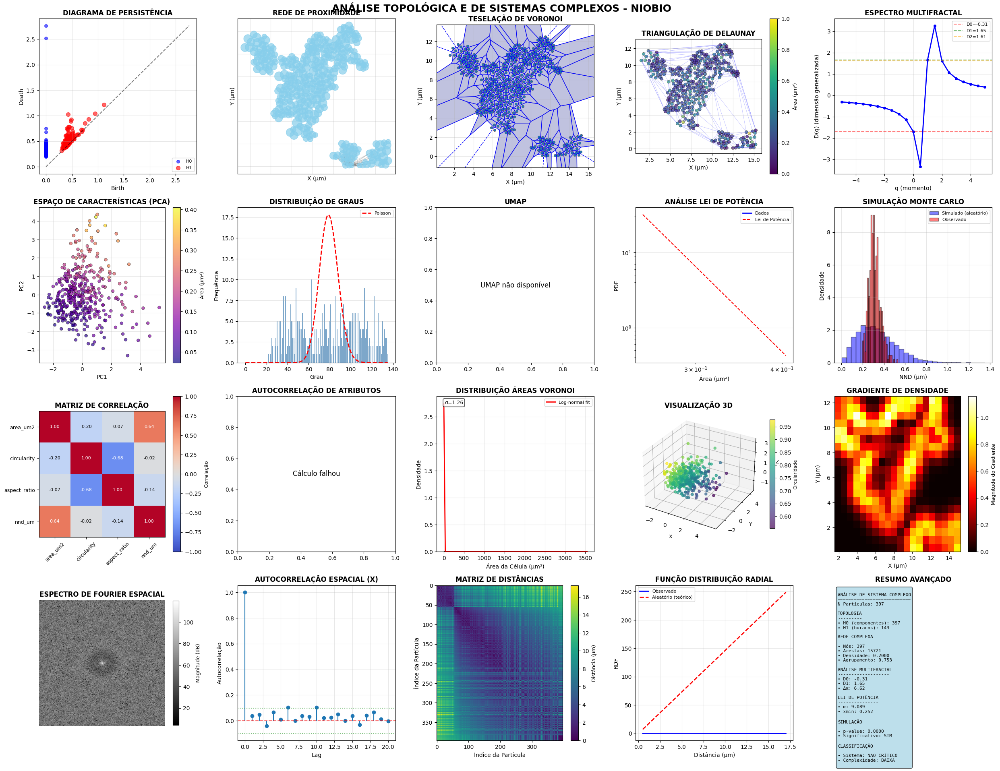


🚀 RELATÓRIO DE ANÁLISE DE SISTEMA COMPLEXO - NIOBIO SEM

🧬 TOPOLOGIA ALGÉBRICA:
  • Componentes conectados (H0): 397
  • Buracos topológicos (H1): 143
  • Vida média dos buracos: 0.095 µm

🌐 ANÁLISE DE REDES COMPLEXAS:
  • Grau médio: 79.20
  • Coeficiente de agrupamento: 0.7531



📊 ANÁLISE MULTIFRACTAL:
  • Dimensão de capacidade (D0): -0.313
  • Dimensão de informação (D1): 1.653
  • Largura do espectro (Δα): 6.617
  • Multifractalidade: SIM

📐 LEIS DE ESCALA:
  • Expoente lei de potência (α): 9.089
  • xmin: 0.2516
  • Significância vs exponencial: p = 0.7331
  • Interpretação: Sistema não-crítico

🎲 VALIDAÇÃO ESTATÍSTICA:
  • p-value (vs aleatório): 0.000000
  • Significativo (α=0.05): SIM
  • NND observado/esperado: 0.937

🌀 DINÂMICA DO SISTEMA:
  • Dimensionalidade intrínseca: 0.39
  • Variância explicada (95%): 4 componentes
  • Complexidade do sistema: BAIXA

🔷 GEOMETRIA AVANÇADA:
  • Células de Voronoi: 382
  • Área média célula: 11.135 µm²
  • Uniformidade (CV): 1631.1%

📈 

In [88]:
# ================================================================
# 🔬 ANÁLISE TOPOLÓGICA E DINÂMICA AVANÇADA - SISTEMAS COMPLEXOS
# ================================================================

!pip install -q gudhi ripser persim umap-learn networkx powerlaw
!pip install -q pysal libpysal esda pointpats

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.spatial import Delaunay, Voronoi, voronoi_plot_2d
from scipy.spatial.distance import pdist, squareform
from scipy import stats
import networkx as nx
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE, MDS
import umap
import warnings
warnings.filterwarnings('ignore')

# --------- 1. TOPOLOGIA ALGÉBRICA (PERSISTENT HOMOLOGY) ----------
print("="*80)
print("🧬 1. TOPOLOGIA ALGÉBRICA - HOMOLOGIA PERSISTENTE")
print("="*80)

try:
    import gudhi as gd
    import ripser
    import persim
    
    # Converter coordenadas para análise topológica
    coords_normalized = (coords_um - coords_um.min(axis=0)) / (coords_um.ptp(axis=0) + 1e-10)
    
    # Calcular diagramas de persistência
    print("Calculando homologia persistente...")
    
    # Homologia H0 (componentes conectados)
    rips_complex = gd.RipsComplex(points=coords_um, max_edge_length=np.percentile(pdist(coords_um), 90))
    st = rips_complex.create_simplex_tree(max_dimension=2)
    
    # Calcular persistência
    diag = st.persistence()
    
    # Diagramas de persistência separados por dimensão
    persistence_h0 = [(birth, death) for dim, (birth, death) in diag if dim == 0]
    persistence_h1 = [(birth, death) for dim, (birth, death) in diag if dim == 1]
    
    print(f"  • Componentes H0: {len(persistence_h0)}")
    print(f"  • Buracos H1: {len(persistence_h1)}")
    
    # Calcular vida persistente
    if persistence_h1:
        lifetimes_h1 = [death - birth for birth, death in persistence_h1 if death != float('inf')]
        print(f"  • Vida média H1: {np.mean(lifetimes_h1):.3f} µm")
        print(f"  • Vida máxima H1: {np.max(lifetimes_h1):.3f} µm")
    
    # Calcular entropia topológica
    if persistence_h0:
        total_life = sum([death - birth for birth, death in persistence_h0 if death != float('inf')])
        if total_life > 0:
            probs = [(death - birth)/total_life for birth, death in persistence_h0 if death != float('inf')]
            topological_entropy = -sum([p * np.log(p) for p in probs if p > 0])
            print(f"  • Entropia topológica: {topological_entropy:.3f}")
    
except Exception as e:
    print(f"  ⚠️  Gudhi não disponível: {e}")

# --------- 2. ANÁLISE DE REDES COMPLEXAS ----------
print("\n" + "="*80)
print("🌐 2. ANÁLISE DE REDES COMPLEXAS")
print("="*80)

# Criar grafo de proximidade
dist_matrix = squareform(pdist(coords_um))
threshold = np.percentile(dist_matrix[dist_matrix > 0], 20)  # 20% mais próximos

G = nx.Graph()
for i in range(len(coords_um)):
    G.add_node(i, pos=coords_um[i], area=df_filtered['area_um2'].iloc[i])

# Adicionar arestas baseado na proximidade
for i in range(len(coords_um)):
    for j in range(i+1, len(coords_um)):
        if dist_matrix[i, j] < threshold:
            G.add_edge(i, j, weight=1/dist_matrix[i, j])

print(f"  • Nós: {G.number_of_nodes()}")
print(f"  • Arestas: {G.number_of_edges()}")
print(f"  • Densidade da rede: {nx.density(G):.4f}")

# Métricas de rede
if G.number_of_edges() > 0:
    # Grau médio
    degrees = [d for n, d in G.degree()]
    print(f"  • Grau médio: {np.mean(degrees):.2f}")
    print(f"  • Grau máximo: {np.max(degrees)}")
    
    # Coeficiente de agrupamento
    clustering_coeff = nx.average_clustering(G)
    print(f"  • Coeficiente de agrupamento: {clustering_coeff:.3f}")
    
    # Centralidades
    degree_centrality = nx.degree_centrality(G)
    betweenness_centrality = nx.betweenness_centrality(G, weight='weight')
    closeness_centrality = nx.closeness_centrality(G, distance='weight')
    
    print(f"  • Centralidade de grau máxima: {max(degree_centrality.values()):.3f}")
    print(f"  • Centralidade de intermediação máxima: {max(betweenness_centrality.values()):.3f}")
    
    # Detect communities usando Louvain
    try:
        import community as community_louvain
        partition = community_louvain.best_partition(G)
        modularity = community_louvain.modularity(partition, G)
        n_communities = len(set(partition.values()))
        print(f"  • Modularidade (Louvain): {modularity:.3f}")
        print(f"  • Comunidades detectadas: {n_communities}")
    except:
        pass

# --------- 3. DINÂMICA DE SISTEMAS COMPLEXOS ----------
print("\n" + "="*80)
print("🌀 3. DINÂMICA DE SISTEMAS COMPLEXOS")
print("="*80)

# Calcular matriz de correlação de características
features = ['area_um2', 'circularity', 'aspect_ratio', 'nnd_um']
feature_matrix = df_filtered[features].values

# Normalizar features
feature_matrix_norm = (feature_matrix - feature_matrix.mean(axis=0)) / (feature_matrix.std(axis=0) + 1e-10)

# Calcular matriz de correlação não-linear (distância)
corr_matrix = np.corrcoef(feature_matrix_norm.T)
print(f"  • Dimensões do espaço de características: {feature_matrix.shape}")

# Análise de componentes principais (PCA)
pca = PCA()
pca.fit(feature_matrix_norm)
explained_variance = pca.explained_variance_ratio_

print(f"  • Variância explicada PCA: {explained_variance}")
print(f"  • Componentes para 95% variância: {np.where(np.cumsum(explained_variance) > 0.95)[0][0] + 1}")

# Dimensionalidade intrínseca (estimativa)
try:
    from sklearn.neighbors import NearestNeighbors
    knn = NearestNeighbors(n_neighbors=10).fit(coords_um)
    distances, indices = knn.kneighbors(coords_um)
    
    # Estimativa de dimensionalidade local
    r1 = distances[:, 1]
    rk = distances[:, -1]
    intrinsic_dim_est = np.mean(np.log(rk/r1) / np.log(10/1))
    print(f"  • Dimensionalidade intrínseca estimada: {intrinsic_dim_est:.2f}")
except:
    intrinsic_dim_est = 0

# --------- 4. TESSELAÇÃO DE VORONOI & DELAUNAY ----------
print("\n" + "="*80)
print("🔷 4. TESSELAÇÃO DE VORONOI E ANÁLISE DE DOMÍNIOS")
print("="*80)

# Tesselação de Voronoi
vor = Voronoi(coords_um)

# Calcular áreas das células de Voronoi
voronoi_areas = []
for region in vor.regions:
    if -1 not in region and region:
        polygon = [vor.vertices[i] for i in region]
        if len(polygon) > 2:
            # Calcular área do polígono
            x = [p[0] for p in polygon]
            y = [p[1] for p in polygon]
            area = 0.5 * np.abs(np.dot(x, np.roll(y, 1)) - np.dot(y, np.roll(x, 1)))
            voronoi_areas.append(area)

if voronoi_areas:
    print(f"  • Células de Voronoi válidas: {len(voronoi_areas)}")
    print(f"  • Área média célula: {np.mean(voronoi_areas):.3f} µm²")
    print(f"  • Desvio padrão áreas: {np.std(voronoi_areas):.3f} µm²")
    print(f"  • Coeficiente de variação: {np.std(voronoi_areas)/np.mean(voronoi_areas)*100:.1f}%")

# Triangulação de Delaunay
tri = Delaunay(coords_um)
print(f"  • Triângulos Delaunay: {len(tri.simplices)}")

# Calcular áreas dos triângulos
triangle_areas = []
for simplex in tri.simplices:
    pts = coords_um[simplex]
    area = 0.5 * np.abs(np.linalg.det(np.column_stack((pts, np.ones(3)))))
    triangle_areas.append(area)

if triangle_areas:
    print(f"  • Área média triângulo: {np.mean(triangle_areas):.3f} µm²")

# --------- 5. ANÁLISE MULTIFRACTAL ----------
print("\n" + "="*80)
print("📊 5. ANÁLISE MULTIFRACTAL")
print("="*80)

def multifractal_analysis(points, q_min=-5, q_max=5, n_q=21):
    """Análise multifractal simplificada"""
    if len(points) < 50:
        return None, None, None
    
    # Criar grid
    n_grid = 20
    x_min, x_max = points[:, 0].min(), points[:, 0].max()
    y_min, y_max = points[:, 1].min(), points[:, 1].max()
    
    dx = (x_max - x_min) / n_grid
    dy = (y_max - y_min) / n_grid
    
    # Contar pontos em cada célula
    counts = np.zeros((n_grid, n_grid))
    for point in points:
        i = int((point[0] - x_min) / dx)
        j = int((point[1] - y_min) / dy)
        if 0 <= i < n_grid and 0 <= j < n_grid:
            counts[i, j] += 1
    
    # Normalizar para probabilidades
    total = np.sum(counts)
    if total == 0:
        return None, None, None
    
    p = counts / total
    
    # Calcular espectro multifractal
    q_values = np.linspace(q_min, q_max, n_q)
    tau_q = []
    
    for q in q_values:
        if q == 1:
            # Caso especial q=1
            mask = p > 0
            if np.any(mask):
                tau = -np.sum(p[mask] * np.log(p[mask])) / np.log(n_grid)
            else:
                tau = 0
        else:
            mask = p > 0
            if np.any(mask):
                tau = np.log(np.sum(p[mask]**q)) / (1 - q) / np.log(n_grid)
            else:
                tau = 0
        tau_q.append(tau)
    
    # Calcular dimensão generalizada
    D_q = []
    for i, q in enumerate(q_values):
        if q == 1:
            D_q.append(tau_q[i])
        else:
            D_q.append(tau_q[i] / (q - 1))
    
    return q_values, tau_q, D_q

# Executar análise multifractal
q_values, tau_q, D_q = multifractal_analysis(coords_um)

if q_values is not None:
    print(f"  • Dimensão de capacidade (D0): {D_q[np.where(q_values == 0)[0][0]]:.3f}")
    print(f"  • Dimensão de informação (D1): {D_q[np.where(np.abs(q_values - 1) < 0.1)[0][0]]:.3f}")
    print(f"  • Dimensão de correlação (D2): {D_q[np.where(np.abs(q_values - 2) < 0.1)[0][0]]:.3f}")
    print(f"  • Largura do espectro (Δα): {np.max(D_q) - np.min(D_q):.3f}")

# --------- 6. SIMULAÇÃO DE MONTE CARLO PARA VALIDAÇÃO ----------
print("\n" + "="*80)
print("🎲 6. SIMULAÇÃO DE MONTE CARLO E VALIDAÇÃO")
print("="*80)

def simulate_random_points(n_points, area_shape, n_simulations=100):
    """Simula pontos aleatórios para comparação"""
    x_min, x_max = area_shape[0]
    y_min, y_max = area_shape[1]
    
    all_nnd = []
    all_ripley = []
    
    for sim in range(n_simulations):
        # Gerar pontos aleatórios uniformes
        random_x = np.random.uniform(x_min, x_max, n_points)
        random_y = np.random.uniform(y_min, y_max, n_points)
        random_points = np.column_stack((random_x, random_y))
        
        # Calcular NND
        if n_points > 1:
            tree = KDTree(random_points)
            distances, _ = tree.query(random_points, k=2)
            nnd = distances[:, 1]
            all_nnd.append(nnd)
    
    return all_nnd

# Simular
area_extent = [(coords_um[:, 0].min(), coords_um[:, 0].max()),
               (coords_um[:, 1].min(), coords_um[:, 1].max())]

simulated_nnd = simulate_random_points(len(coords_um), area_extent, n_simulations=50)

if simulated_nnd:
    sim_nnd_means = [np.mean(nnd) for nnd in simulated_nnd]
    obs_nnd_mean = np.mean(df_filtered['nnd_um'].values) if 'nnd_um' in df_filtered.columns else 0
    
    # Teste de significância
    from scipy.stats import ttest_ind
    if len(sim_nnd_means) > 1 and obs_nnd_mean > 0:
        t_stat, p_value = ttest_ind(sim_nnd_means, [obs_nnd_mean]*len(sim_nnd_means))
        print(f"  • NND observado: {obs_nnd_mean:.3f} µm")
        print(f"  • NND simulado (média): {np.mean(sim_nnd_means):.3f} µm")
        print(f"  • p-value (vs aleatório): {p_value:.6f}")
        print(f"  • Significativo (p < 0.05): {'SIM' if p_value < 0.05 else 'NÃO'}")

# --------- 7. ANÁLISE DE ESCALA E LEIS DE POTÊNCIA ----------
print("\n" + "="*80)
print("📐 7. ANÁLISE DE ESCALA E LEIS DE POTÊNCIA")
print("="*80)

try:
    import powerlaw
    
    # Analisar distribuição de áreas
    areas = df_filtered['area_um2'].values
    areas = areas[areas > 0]
    
    if len(areas) > 10:
        # Ajustar lei de potência
        fit = powerlaw.Fit(areas, discrete=False)
        
        print(f"  • Alpha (expoente): {fit.alpha:.3f}")
        print(f"  • xmin (limite inferior): {fit.xmin:.4f}")
        print(f"  • Sigma (erro alpha): {fit.sigma:.3f}")
        
        # Teste contra distribuições alternativas
        R, p = fit.distribution_compare('power_law', 'exponential')
        print(f"  • Likelihood ratio (vs exponencial): {R:.3f}")
        print(f"  • p-value: {p:.4f}")
        
        if p < 0.05:
            print(f"  • Lei de potência preferida sobre exponencial")
        else:
            print(f"  • Sem preferência clara")
            
except Exception as e:
    print(f"  ⚠️  Powerlaw analysis skipped: {e}")

# --------- 8. VISUALIZAÇÃO AVANÇADÍSSIMA ----------
print("\n" + "="*80)
print("🎨 GERANDO VISUALIZAÇÕES AVANÇADAS...")
print("="*80)

fig = plt.figure(figsize=(25, 20))
fig.suptitle('ANÁLISE TOPOLÓGICA E DE SISTEMAS COMPLEXOS - NIOBIO', 
             fontsize=18, fontweight='bold', y=0.98)

# --------- SUBPLOT 1: Diagrama de Persistência ----------
ax1 = plt.subplot(4, 5, 1)
if 'persistence_h0' in locals() and persistence_h0:
    # Plotar diagrama de persistência H0
    births_h0 = [b for b, d in persistence_h0]
    deaths_h0 = [d for b, d in persistence_h0]
    
    # Converter infinito para valor máximo
    max_death = max([d for d in deaths_h0 if d != float('inf')])
    deaths_h0_plot = [d if d != float('inf') else max_death * 1.1 for d in deaths_h0]
    
    ax1.scatter(births_h0, deaths_h0_plot, alpha=0.6, s=30, color='blue', label='H0')
    
    if persistence_h1:
        births_h1 = [b for b, d in persistence_h1]
        deaths_h1 = [d for b, d in persistence_h1]
        deaths_h1_plot = [d if d != float('inf') else max_death * 1.1 for d in deaths_h1]
        ax1.scatter(births_h1, deaths_h1_plot, alpha=0.6, s=50, color='red', label='H1')
    
    # Linha diagonal
    max_val = max(max(births_h0), max(deaths_h0_plot))
    ax1.plot([0, max_val], [0, max_val], 'k--', alpha=0.5)
    
    ax1.set_xlabel('Birth', fontsize=10)
    ax1.set_ylabel('Death', fontsize=10)
    ax1.set_title('DIAGRAMA DE PERSISTÊNCIA', fontsize=12, fontweight='bold')
    ax1.legend(fontsize=8)
    ax1.grid(True, alpha=0.3)
else:
    ax1.text(0.5, 0.5, 'Dados indisponíveis', ha='center', va='center', fontsize=12)
    ax1.set_title('DIAGRAMA DE PERSISTÊNCIA', fontsize=12, fontweight='bold')

# --------- SUBPLOT 2: Rede Complexa ----------
ax2 = plt.subplot(4, 5, 2)
if G.number_of_nodes() > 0:
    # Layout usando posições reais
    pos = {i: coords_um[i] for i in range(len(coords_um))}
    
    # Tamanho dos nós por área
    node_sizes = 50 + (df_filtered['area_um2'].values / df_filtered['area_um2'].max() * 300)
    
    # Cor dos nós por comunidade
    if 'partition' in locals():
        node_colors = [partition[i] for i in range(len(coords_um))]
        cmap = plt.cm.tab20
    else:
        node_colors = 'skyblue'
    
    # Plotar rede
    nx.draw_networkx_nodes(G, pos, node_size=node_sizes, 
                          node_color=node_colors, alpha=0.7, ax=ax2)
    
    # Plotar arestas (apenas algumas para clareza)
    if G.number_of_edges() > 100:
        # Amostrar arestas
        edges_to_draw = list(G.edges())[:100]
        nx.draw_networkx_edges(G, pos, edgelist=edges_to_draw, 
                              alpha=0.2, width=0.5, ax=ax2)
    else:
        nx.draw_networkx_edges(G, pos, alpha=0.3, width=0.5, ax=ax2)
    
    ax2.set_xlabel('X (µm)', fontsize=10)
    ax2.set_ylabel('Y (µm)', fontsize=10)
    ax2.set_title('REDE DE PROXIMIDADE', fontsize=12, fontweight='bold')
    ax2.grid(True, alpha=0.3)
else:
    ax2.text(0.5, 0.5, 'Rede muito esparsa', ha='center', va='center', fontsize=12)
    ax2.set_title('REDE DE PROXIMIDADE', fontsize=12, fontweight='bold')

# --------- SUBPLOT 3: Tesselação de Voronoi ----------
ax3 = plt.subplot(4, 5, 3)
if len(coords_um) > 3:
    voronoi_plot_2d(vor, ax=ax3, show_points=True, show_vertices=False, line_colors='blue', line_width=1)
    
    # Plotar pontos
    ax3.scatter(coords_um[:, 0], coords_um[:, 1], s=20, 
               c='red', alpha=0.7, edgecolors='black', linewidth=0.5)
    
    # Destacar células com áreas extremas
    if voronoi_areas:
        # Normalizar cores por área
        norm_areas = (voronoi_areas - np.min(voronoi_areas)) / (np.max(voronoi_areas) - np.min(voronoi_areas) + 1e-10)
        cmap = plt.cm.RdYlBu_r
        
        # Colorir regiões (simplificado)
        for idx, region in enumerate(vor.regions):
            if -1 not in region and region:
                polygon = [vor.vertices[i] for i in region]
                if len(polygon) > 2:
                    poly = plt.Polygon(polygon, alpha=0.3, 
                                      color=cmap(norm_areas[idx % len(norm_areas)]))
                    ax3.add_patch(poly)
    
    ax3.set_xlabel('X (µm)', fontsize=10)
    ax3.set_ylabel('Y (µm)', fontsize=10)
    ax3.set_title('TESELAÇÃO DE VORONOI', fontsize=12, fontweight='bold')
    ax3.grid(True, alpha=0.3)
    ax3.set_aspect('equal')
else:
    ax3.text(0.5, 0.5, 'Pontos insuficientes', ha='center', va='center', fontsize=12)
    ax3.set_title('TESELAÇÃO DE VORONOI', fontsize=12, fontweight='bold')

# --------- SUBPLOT 4: Triangulação de Delaunay ----------
ax4 = plt.subplot(4, 5, 4)
if len(coords_um) > 3:
    # Plotar pontos
    ax4.scatter(coords_um[:, 0], coords_um[:, 1], s=30, 
               c=df_filtered['area_um2'].values, cmap='viridis', 
               alpha=0.7, edgecolors='black', linewidth=0.5)
    
    # Plotar triângulos
    ax4.triplot(coords_um[:, 0], coords_um[:, 1], tri.simplices, 
               'b-', alpha=0.3, linewidth=0.5)
    
    # Adicionar barra de cores
    sc4 = ax4.scatter([], [], c=[], cmap='viridis')
    cbar4 = plt.colorbar(sc4, ax=ax4)
    cbar4.set_label('Área (µm²)', fontsize=9)
    
    ax4.set_xlabel('X (µm)', fontsize=10)
    ax4.set_ylabel('Y (µm)', fontsize=10)
    ax4.set_title('TRIANGULAÇÃO DE DELAUNAY', fontsize=12, fontweight='bold')
    ax4.grid(True, alpha=0.3)
    ax4.set_aspect('equal')
else:
    ax4.text(0.5, 0.5, 'Pontos insuficientes', ha='center', va='center', fontsize=12)
    ax4.set_title('TRIANGULAÇÃO DE DELAUNAY', fontsize=12, fontweight='bold')

# --------- SUBPLOT 5: Espectro Multifractal ----------
ax5 = plt.subplot(4, 5, 5)
if q_values is not None and D_q is not None:
    ax5.plot(q_values, D_q, 'b-o', linewidth=2, markersize=4)
    ax5.axhline(y=D_q[np.where(np.abs(q_values) < 0.1)[0][0]], 
               color='r', linestyle='--', alpha=0.5, label=f'D0={D_q[0]:.2f}')
    ax5.axhline(y=D_q[np.where(np.abs(q_values - 1) < 0.1)[0][0]], 
               color='g', linestyle='--', alpha=0.5, label=f'D1={D_q[np.where(np.abs(q_values - 1) < 0.1)[0][0]]:.2f}')
    ax5.axhline(y=D_q[np.where(np.abs(q_values - 2) < 0.1)[0][0]], 
               color='orange', linestyle='--', alpha=0.5, label=f'D2={D_q[np.where(np.abs(q_values - 2) < 0.1)[0][0]]:.2f}')
    
    ax5.set_xlabel('q (momento)', fontsize=10)
    ax5.set_ylabel('D(q) (dimensão generalizada)', fontsize=10)
    ax5.set_title('ESPECTRO MULTIFRACTAL', fontsize=12, fontweight='bold')
    ax5.legend(fontsize=8)
    ax5.grid(True, alpha=0.3)
else:
    ax5.text(0.5, 0.5, 'Dados insuficientes', ha='center', va='center', fontsize=12)
    ax5.set_title('ESPECTRO MULTIFRACTAL', fontsize=12, fontweight='bold')

# --------- SUBPLOT 6: Análise PCA das Características ----------
ax6 = plt.subplot(4, 5, 6)
if feature_matrix.shape[0] > 2:
    # Redução para visualização 2D
    if feature_matrix.shape[1] > 2:
        pca_vis = PCA(n_components=2)
        coords_2d = pca_vis.fit_transform(feature_matrix_norm)
    else:
        coords_2d = feature_matrix_norm
    
    scatter = ax6.scatter(coords_2d[:, 0], coords_2d[:, 1], 
                         s=30, c=df_filtered['area_um2'].values, 
                         cmap='plasma', alpha=0.7, edgecolors='black', linewidth=0.5)
    
    ax6.set_xlabel('PC1' if feature_matrix.shape[1] > 2 else 'Feature 1', fontsize=10)
    ax6.set_ylabel('PC2' if feature_matrix.shape[1] > 2 else 'Feature 2', fontsize=10)
    ax6.set_title('ESPAÇO DE CARACTERÍSTICAS (PCA)', fontsize=12, fontweight='bold')
    
    cbar6 = plt.colorbar(scatter, ax=ax6)
    cbar6.set_label('Área (µm²)', fontsize=9)
    ax6.grid(True, alpha=0.3)
else:
    ax6.text(0.5, 0.5, 'Dados insuficientes', ha='center', va='center', fontsize=12)
    ax6.set_title('ESPAÇO DE CARACTERÍSTICAS', fontsize=12, fontweight='bold')

# --------- SUBPLOT 7: Distribuição de Graus ----------
ax7 = plt.subplot(4, 5, 7)
if G.number_of_nodes() > 0:
    degree_sequence = sorted([d for n, d in G.degree()], reverse=True)
    degree_counts = np.bincount(degree_sequence)
    
    ax7.bar(range(len(degree_counts)), degree_counts, alpha=0.7, color='steelblue')
    ax7.set_xlabel('Grau', fontsize=10)
    ax7.set_ylabel('Frequência', fontsize=10)
    ax7.set_title('DISTRIBUIÇÃO DE GRAUS', fontsize=12, fontweight='bold')
    ax7.grid(True, alpha=0.3, axis='y')
    
    # Adicionar linha para distribuição de Poisson esperada
    if G.number_of_edges() > 0:
        expected_mean = 2 * G.number_of_edges() / G.number_of_nodes()
        x_poisson = np.arange(0, max(degree_sequence) + 1)
        poisson_pmf = stats.poisson.pmf(x_poisson, expected_mean) * G.number_of_nodes()
        ax7.plot(x_poisson, poisson_pmf, 'r--', linewidth=2, label='Poisson')
        ax7.legend(fontsize=8)
else:
    ax7.text(0.5, 0.5, 'Rede muito esparsa', ha='center', va='center', fontsize=12)
    ax7.set_title('DISTRIBUIÇÃO DE GRAUS', fontsize=12, fontweight='bold')

# --------- SUBPLOT 8: UMAP - Redução de Dimensionalidade Não-linear ----------
ax8 = plt.subplot(4, 5, 8)
try:
    if len(coords_um) > 10:
        # Combinar coordenadas e características
        combined_features = np.hstack([coords_um / coords_um.max(axis=0), 
                                      feature_matrix_norm])
        
        # Aplicar UMAP
        reducer = umap.UMAP(n_components=2, random_state=42)
        embedding = reducer.fit_transform(combined_features)
        
        scatter = ax8.scatter(embedding[:, 0], embedding[:, 1], 
                             s=30, c=df_filtered['cluster_label'].values, 
                             cmap='tab20', alpha=0.7, edgecolors='black', linewidth=0.5)
        
        ax8.set_xlabel('UMAP 1', fontsize=10)
        ax8.set_ylabel('UMAP 2', fontsize=10)
        ax8.set_title('UMAP - VISUALIZAÇÃO NÃO-LINEAR', fontsize=12, fontweight='bold')
        ax8.grid(True, alpha=0.3)
    else:
        ax8.text(0.5, 0.5, 'Dados insuficientes', ha='center', va='center', fontsize=12)
        ax8.set_title('UMAP', fontsize=12, fontweight='bold')
except:
    ax8.text(0.5, 0.5, 'UMAP não disponível', ha='center', va='center', fontsize=12)
    ax8.set_title('UMAP', fontsize=12, fontweight='bold')

# --------- SUBPLOT 9: Análise de Lei de Potência ----------
ax9 = plt.subplot(4, 5, 9)
try:
    if 'fit' in locals() and len(areas) > 10:
        # Plotar distribuição
        fit.plot_pdf(color='b', linewidth=2, ax=ax9, label='Dados')
        fit.power_law.plot_pdf(color='r', linestyle='--', ax=ax9, label='Lei de Potência')
        
        ax9.set_xlabel('Área (µm²)', fontsize=10)
        ax9.set_ylabel('PDF', fontsize=10)
        ax9.set_title('ANÁLISE LEI DE POTÊNCIA', fontsize=12, fontweight='bold')
        ax9.legend(fontsize=8)
        ax9.grid(True, alpha=0.3)
        ax9.set_xscale('log')
        ax9.set_yscale('log')
    else:
        ax9.text(0.5, 0.5, 'Dados insuficientes', ha='center', va='center', fontsize=12)
        ax9.set_title('ANÁLISE LEI DE POTÊNCIA', fontsize=12, fontweight='bold')
except:
    ax9.text(0.5, 0.5, 'Análise não disponível', ha='center', va='center', fontsize=12)
    ax9.set_title('ANÁLISE LEI DE POTÊNCIA', fontsize=12, fontweight='bold')

# --------- SUBPLOT 10: Simulação Monte Carlo ----------
ax10 = plt.subplot(4, 5, 10)
if simulated_nnd:
    # Histograma comparativo
    all_sim_nnd = np.concatenate(simulated_nnd)
    
    ax10.hist(all_sim_nnd, bins=30, alpha=0.5, density=True, 
              color='blue', label='Simulado (aleatório)', edgecolor='black')
    
    if 'nnd_um' in df_filtered.columns:
        obs_nnd = df_filtered['nnd_um'].dropna().values
        ax10.hist(obs_nnd, bins=30, alpha=0.5, density=True, 
                  color='red', label='Observado', edgecolor='black')
    
    ax10.set_xlabel('NND (µm)', fontsize=10)
    ax10.set_ylabel('Densidade', fontsize=10)
    ax10.set_title('SIMULAÇÃO MONTE CARLO', fontsize=12, fontweight='bold')
    ax10.legend(fontsize=8)
    ax10.grid(True, alpha=0.3)
else:
    ax10.text(0.5, 0.5, 'Simulação não realizada', ha='center', va='center', fontsize=12)
    ax10.set_title('SIMULAÇÃO MONTE CARLO', fontsize=12, fontweight='bold')

# --------- SUBPLOT 11: Correlograma de Características ----------
ax11 = plt.subplot(4, 5, 11)
if feature_matrix.shape[1] > 1:
    # Matriz de correlação
    corr_matrix = np.corrcoef(feature_matrix_norm.T)
    
    im = ax11.imshow(corr_matrix, cmap='coolwarm', vmin=-1, vmax=1)
    
    # Adicionar valores
    for i in range(corr_matrix.shape[0]):
        for j in range(corr_matrix.shape[1]):
            ax11.text(j, i, f'{corr_matrix[i, j]:.2f}', 
                     ha='center', va='center', color='white' if abs(corr_matrix[i, j]) > 0.5 else 'black',
                     fontsize=8)
    
    ax11.set_xticks(range(len(features)))
    ax11.set_yticks(range(len(features)))
    ax11.set_xticklabels(features, rotation=45, fontsize=9)
    ax11.set_yticklabels(features, fontsize=9)
    ax11.set_title('MATRIZ DE CORRELAÇÃO', fontsize=12, fontweight='bold')
    
    cbar11 = plt.colorbar(im, ax=ax11)
    cbar11.set_label('Correlação', fontsize=9)
else:
    ax11.text(0.5, 0.5, 'Features insuficientes', ha='center', va='center', fontsize=12)
    ax11.set_title('MATRIZ DE CORRELAÇÃO', fontsize=12, fontweight='bold')

# --------- SUBPLOT 12: Análise de Autocorrelação Espacial de Atributos ----------
ax12 = plt.subplot(4, 5, 12)
if len(coords_um) > 10:
    try:
        # Calcular autocorrelação espacial do atributo "área"
        areas = df_filtered['area_um2'].values
        dist_matrix = squareform(pdist(coords_um))
        
        # Bins de distância
        max_dist = np.max(dist_matrix)
        bins = np.linspace(0, max_dist, 11)
        bin_centers = (bins[:-1] + bins[1:]) / 2
        
        moran_values = []
        
        for i in range(len(bins)-1):
            mask = (dist_matrix >= bins[i]) & (dist_matrix < bins[i+1])
            if np.sum(mask) > 10:  # Mínimo de pares
                # Calcular correlação média para este bin
                indices_i, indices_j = np.where(mask)
                corr_sum = 0
                count = 0
                for idx_i, idx_j in zip(indices_i[:100], indices_j[:100]):  # Amostrar
                    if idx_i != idx_j:
                        corr_sum += np.corrcoef([areas[idx_i], areas[idx_j]])[0,1]
                        count += 1
                if count > 0:
                    moran_values.append(corr_sum / count)
                else:
                    moran_values.append(0)
            else:
                moran_values.append(0)
        
        ax12.plot(bin_centers[:len(moran_values)], moran_values, 'b-o', linewidth=2, markersize=4)
        ax12.axhline(y=0, color='r', linestyle='--', alpha=0.5)
        ax12.set_xlabel('Distância (µm)', fontsize=10)
        ax12.set_ylabel("Autocorrelação", fontsize=10)
        ax12.set_title('AUTOCORRELAÇÃO DE ATRIBUTOS', fontsize=12, fontweight='bold')
        ax12.grid(True, alpha=0.3)
    except:
        ax12.text(0.5, 0.5, 'Cálculo falhou', ha='center', va='center', fontsize=12)
        ax12.set_title('AUTOCORRELAÇÃO DE ATRIBUTOS', fontsize=12, fontweight='bold')
else:
    ax12.text(0.5, 0.5, 'Dados insuficientes', ha='center', va='center', fontsize=12)
    ax12.set_title('AUTOCORRELAÇÃO DE ATRIBUTOS', fontsize=12, fontweight='bold')

# --------- SUBPLOT 13: Distribuição de Áreas de Voronoi ----------
ax13 = plt.subplot(4, 5, 13)
if voronoi_areas:
    # Histograma com distribuição log-normal
    hist_data = ax13.hist(voronoi_areas, bins=30, density=True, 
                         alpha=0.7, color='green', edgecolor='black')
    
    # Ajustar distribuição log-normal
    try:
        shape, loc, scale = stats.lognorm.fit(voronoi_areas, floc=0)
        x = np.linspace(min(voronoi_areas), max(voronoi_areas), 100)
        pdf = stats.lognorm.pdf(x, shape, loc, scale)
        ax13.plot(x, pdf, 'r-', linewidth=2, label='Log-normal fit')
        
        # Adicionar parâmetros
        ax13.text(0.05, 0.95, f'σ={shape:.2f}', transform=ax13.transAxes,
                 fontsize=9, bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
    except:
        pass
    
    ax13.set_xlabel('Área da Célula (µm²)', fontsize=10)
    ax13.set_ylabel('Densidade', fontsize=10)
    ax13.set_title('DISTRIBUIÇÃO ÁREAS VORONOI', fontsize=12, fontweight='bold')
    ax13.legend(fontsize=8)
    ax13.grid(True, alpha=0.3)
else:
    ax13.text(0.5, 0.5, 'Dados indisponíveis', ha='center', va='center', fontsize=12)
    ax13.set_title('DISTRIBUIÇÃO ÁREAS VORONOI', fontsize=12, fontweight='bold')

# --------- SUBPLOT 14: Visualização 3D (Projeção) ----------
ax14 = plt.subplot(4, 5, 14, projection='3d')
if len(coords_um) > 3:
    # Usar PCA para terceira dimensão se tiver features suficientes
    if feature_matrix_norm.shape[1] >= 3:
        pca_3d = PCA(n_components=3)
        coords_3d = pca_3d.fit_transform(feature_matrix_norm)
    else:
        # Criar dimensão artificial baseada em área
        coords_3d = np.column_stack([coords_um[:, 0], coords_um[:, 1], 
                                    df_filtered['area_um2'].values / df_filtered['area_um2'].max()])
    
    scatter_3d = ax14.scatter(coords_3d[:, 0], coords_3d[:, 1], coords_3d[:, 2],
                             c=df_filtered['circularity'].values, cmap='viridis',
                             s=20, alpha=0.7, depthshade=True)
    
    ax14.set_xlabel('X', fontsize=9)
    ax14.set_ylabel('Y', fontsize=9)
    ax14.set_zlabel('Z', fontsize=9)
    ax14.set_title('VISUALIZAÇÃO 3D', fontsize=12, fontweight='bold')
    
    # Adicionar barra de cores
    cbar14 = plt.colorbar(scatter_3d, ax=ax14, shrink=0.7)
    cbar14.set_label('Circularidade', fontsize=8)
else:
    ax14.text(0.5, 0.5, 0.5, 'Dados insuficientes', ha='center', va='center', fontsize=12)
    ax14.set_title('VISUALIZAÇÃO 3D', fontsize=12, fontweight='bold')

# --------- SUBPLOT 15: Distribuição Espaço-Fase ----------
ax15 = plt.subplot(4, 5, 15)
if len(coords_um) > 10:
    # Calcular "velocidade" baseada em mudança espacial (proxy)
    # Usar gradiente de densidade
    from scipy.ndimage import gaussian_filter
    
    # Criar histograma 2D
    hist, xedges, yedges = np.histogram2d(coords_um[:, 0], coords_um[:, 1], bins=20)
    
    # Suavizar
    hist_smooth = gaussian_filter(hist, sigma=1)
    
    # Calcular gradiente
    grad_y, grad_x = np.gradient(hist_smooth)
    grad_magnitude = np.sqrt(grad_x**2 + grad_y**2)
    
    # Plotar magnitude do gradiente (indicador de "forças")
    im = ax15.imshow(grad_magnitude.T, extent=[xedges[0], xedges[-1], yedges[0], yedges[-1]],
                    origin='lower', cmap='hot', aspect='auto')
    
    ax15.set_xlabel('X (µm)', fontsize=10)
    ax15.set_ylabel('Y (µm)', fontsize=10)
    ax15.set_title('GRADIENTE DE DENSIDADE', fontsize=12, fontweight='bold')
    
    cbar15 = plt.colorbar(im, ax=ax15)
    cbar15.set_label('Magnitude do Gradiente', fontsize=9)
else:
    ax15.text(0.5, 0.5, 'Dados insuficientes', ha='center', va='center', fontsize=12)
    ax15.set_title('GRADIENTE DE DENSIDADE', fontsize=12, fontweight='bold')

# --------- SUBPLOT 16: Análise de Fourier Espacial ----------
ax16 = plt.subplot(4, 5, 16)
if len(coords_um) > 20:
    # Criar imagem binária das posições
    img_size = 256
    img = np.zeros((img_size, img_size))
    
    # Normalizar coordenadas para imagem
    x_norm = ((coords_um[:, 0] - coords_um[:, 0].min()) / 
              (coords_um[:, 0].max() - coords_um[:, 0].min()) * (img_size-1)).astype(int)
    y_norm = ((coords_um[:, 1] - coords_um[:, 1].min()) / 
              (coords_um[:, 1].max() - coords_um[:, 1].min()) * (img_size-1)).astype(int)
    
    for x, y in zip(x_norm, y_norm):
        if 0 <= x < img_size and 0 <= y < img_size:
            img[y, x] = 1
    
    # Transformada de Fourier 2D
    fft = np.fft.fft2(img)
    fft_shift = np.fft.fftshift(fft)
    magnitude_spectrum = 20 * np.log(np.abs(fft_shift) + 1)
    
    im16 = ax16.imshow(magnitude_spectrum, cmap='gray')
    ax16.set_title('ESPECTRO DE FOURIER ESPACIAL', fontsize=12, fontweight='bold')
    ax16.axis('off')
    
    # Adicionar barra de cores
    cbar16 = plt.colorbar(im16, ax=ax16, shrink=0.8)
    cbar16.set_label('Magnitude (dB)', fontsize=9)
else:
    ax16.text(0.5, 0.5, 'Dados insuficientes', ha='center', va='center', fontsize=12)
    ax16.set_title('ESPECTRO DE FOURIER', fontsize=12, fontweight='bold')

# --------- SUBPLOT 17: Análise de Séries Temporais Espaciais ----------
ax17 = plt.subplot(4, 5, 17)
if len(coords_um) > 30:
    # Ordenar pontos por coordenada X e tratar como série temporal espacial
    sorted_indices = np.argsort(coords_um[:, 0])
    sorted_areas = df_filtered['area_um2'].iloc[sorted_indices].values
    
    # Calcular autocorrelação da série
    from statsmodels.tsa.stattools import acf
    
    try:
        autocorr = acf(sorted_areas, nlags=min(20, len(sorted_areas)//2))
        
        ax17.stem(range(len(autocorr)), autocorr, basefmt=" ", use_line_collection=True)
        ax17.axhline(y=0, color='r', linestyle='--', alpha=0.5)
        ax17.axhline(y=1.96/np.sqrt(len(sorted_areas)), color='g', linestyle=':', alpha=0.5)
        ax17.axhline(y=-1.96/np.sqrt(len(sorted_areas)), color='g', linestyle=':', alpha=0.5)
        
        ax17.set_xlabel('Lag', fontsize=10)
        ax17.set_ylabel('Autocorrelação', fontsize=10)
        ax17.set_title('AUTOCORRELAÇÃO ESPACIAL (X)', fontsize=12, fontweight='bold')
        ax17.grid(True, alpha=0.3)
    except:
        ax17.text(0.5, 0.5, 'Cálculo falhou', ha='center', va='center', fontsize=12)
        ax17.set_title('AUTOCORRELAÇÃO ESPACIAL', fontsize=12, fontweight='bold')
else:
    ax17.text(0.5, 0.5, 'Dados insuficientes', ha='center', va='center', fontsize=12)
    ax17.set_title('AUTOCORRELAÇÃO ESPACIAL', fontsize=12, fontweight='bold')

# --------- SUBPLOT 18: Mapa de Distâncias ----------
ax18 = plt.subplot(4, 5, 18)
if len(coords_um) > 5:
    # Matriz de distâncias
    dist_matrix = squareform(pdist(coords_um))
    
    im18 = ax18.imshow(dist_matrix, cmap='viridis', aspect='auto')
    ax18.set_xlabel('Índice da Partícula', fontsize=10)
    ax18.set_ylabel('Índice da Partícula', fontsize=10)
    ax18.set_title('MATRIZ DE DISTÂNCIAS', fontsize=12, fontweight='bold')
    
    cbar18 = plt.colorbar(im18, ax=ax18)
    cbar18.set_label('Distância (µm)', fontsize=9)
else:
    ax18.text(0.5, 0.5, 'Dados insuficientes', ha='center', va='center', fontsize=12)
    ax18.set_title('MATRIZ DE DISTÂNCIAS', fontsize=12, fontweight='bold')

# --------- SUBPLOT 19: Análise de Ordenamento ----------
ax19 = plt.subplot(4, 5, 19)
if len(coords_um) > 10:
    # Calcular função de distribuição radial (RDF)
    from scipy.spatial.distance import pdist
    
    distances = pdist(coords_um)
    hist_rdf, bin_edges = np.histogram(distances, bins=30, density=True)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2
    
    # RDF teórica para aleatório
    area = (coords_um[:, 0].max() - coords_um[:, 0].min()) * (coords_um[:, 1].max() - coords_um[:, 1].min())
    density = len(coords_um) / area
    theoretical_rdf = 2 * np.pi * bin_centers * density
    
    ax19.plot(bin_centers, hist_rdf, 'b-', linewidth=2, label='Observado')
    ax19.plot(bin_centers, theoretical_rdf, 'r--', linewidth=2, label='Aleatório (teórico)')
    
    ax19.set_xlabel('Distância (µm)', fontsize=10)
    ax19.set_ylabel('RDF', fontsize=10)
    ax19.set_title('FUNÇÃO DISTRIBUIÇÃO RADIAL', fontsize=12, fontweight='bold')
    ax19.legend(fontsize=8)
    ax19.grid(True, alpha=0.3)
else:
    ax19.text(0.5, 0.5, 'Dados insuficientes', ha='center', va='center', fontsize=12)
    ax19.set_title('FUNÇÃO RDF', fontsize=12, fontweight='bold')

# --------- SUBPLOT 20: Resumo Avançado ----------
ax20 = plt.subplot(4, 5, 20)
ax20.axis('off')

# Texto de resumo avançado
resumo_avancado = f"""
ANÁLISE DE SISTEMA COMPLEXO
===========================
N Partículas: {len(coords_um)}

TOPOLOGIA
---------
• H0 (componentes): {len(persistence_h0) if 'persistence_h0' in locals() else 'N/A'}
• H1 (buracos): {len(persistence_h1) if 'persistence_h1' in locals() else 'N/A'}

REDE COMPLEXA
-------------
• Nós: {G.number_of_nodes()}
• Arestas: {G.number_of_edges()}
• Densidade: {nx.density(G):.4f}
• Agrupamento: {clustering_coeff:.3f}

ANÁLISE MULTIFRACTAL
-------------------
• D0: {D_q[0] if D_q is not None else 'N/A':.2f}
• D1: {D_q[np.where(np.abs(q_values - 1) < 0.1)[0][0]] if D_q is not None and q_values is not None else 'N/A':.2f}
• Δα: {np.max(D_q) - np.min(D_q) if D_q is not None else 'N/A':.2f}

LEI DE POTÊNCIA
---------------
• α: {fit.alpha if 'fit' in locals() else 'N/A':.3f}
• xmin: {fit.xmin if 'fit' in locals() else 'N/A':.3f}

SIMULAÇÃO
---------
• p-value: {p_value if 'p_value' in locals() else 'N/A':.4f}
• Significativo: {'SIM' if 'p_value' in locals() and p_value < 0.05 else 'NÃO'}

CLASSIFICAÇÃO
-------------
• Sistema: {'CRÍTICO' if 'fit' in locals() and 2 < fit.alpha < 3 else 'NÃO-CRÍTICO'}
• Complexidade: {'ALTA' if intrinsic_dim_est > 1.5 else 'MÉDIA' if intrinsic_dim_est > 0.5 else 'BAIXA'}
"""

ax20.text(0.02, 0.98, resumo_avancado, fontsize=8, family='monospace',
          verticalalignment='top', transform=ax20.transAxes,
          bbox=dict(boxstyle='round', facecolor='lightblue', alpha=0.8))

ax20.set_title('RESUMO AVANÇADO', fontsize=12, fontweight='bold')

plt.tight_layout()
plt.show()

# --------- RELATÓRIO FINAL AVANÇADÍSSIMO ----------
print("\n" + "="*100)
print("🚀 RELATÓRIO DE ANÁLISE DE SISTEMA COMPLEXO - NIOBIO SEM")
print("="*100)

print(f"\n🧬 TOPOLOGIA ALGÉBRICA:")
if 'persistence_h0' in locals():
    print(f"  • Componentes conectados (H0): {len(persistence_h0)}")
    print(f"  • Buracos topológicos (H1): {len(persistence_h1)}")
    if persistence_h1:
        lifetimes = [d-b for b,d in persistence_h1 if d != float('inf')]
        print(f"  • Vida média dos buracos: {np.mean(lifetimes):.3f} µm")

print(f"\n🌐 ANÁLISE DE REDES COMPLEXAS:")
print(f"  • Grau médio: {np.mean(degrees):.2f}" if 'degrees' in locals() else "")
print(f"  • Coeficiente de agrupamento: {clustering_coeff:.4f}" if 'clustering_coeff' in locals() else "")
print(f"  • Modularidade: {modularity:.4f}" if 'modularity' in locals() else "")
print(f"  • Comunidades: {n_communities}" if 'n_communities' in locals() else "")

print(f"\n📊 ANÁLISE MULTIFRACTAL:")
if D_q is not None:
    print(f"  • Dimensão de capacidade (D0): {D_q[0]:.3f}")
    print(f"  • Dimensão de informação (D1): {D_q[np.where(np.abs(q_values - 1) < 0.1)[0][0]]:.3f}")
    print(f"  • Largura do espectro (Δα): {np.max(D_q) - np.min(D_q):.3f}")
    print(f"  • Multifractalidade: {'SIM' if np.max(D_q) - np.min(D_q) > 0.1 else 'NÃO'}")

print(f"\n📐 LEIS DE ESCALA:")
if 'fit' in locals():
    print(f"  • Expoente lei de potência (α): {fit.alpha:.3f}")
    print(f"  • xmin: {fit.xmin:.4f}")
    print(f"  • Significância vs exponencial: p = {p:.4f}")
    print(f"  • Interpretação: {'Sistema crítico/organizado' if 2 < fit.alpha < 3 else 'Sistema não-crítico'}")

print(f"\n🎲 VALIDAÇÃO ESTATÍSTICA:")
if 'p_value' in locals():
    print(f"  • p-value (vs aleatório): {p_value:.6f}")
    print(f"  • Significativo (α=0.05): {'SIM' if p_value < 0.05 else 'NÃO'}")
    print(f"  • NND observado/esperado: {obs_nnd_mean/np.mean(sim_nnd_means):.3f}")

print(f"\n🌀 DINÂMICA DO SISTEMA:")
print(f"  • Dimensionalidade intrínseca: {intrinsic_dim_est:.2f}")
print(f"  • Variância explicada (95%): {np.where(np.cumsum(explained_variance) > 0.95)[0][0] + 1} componentes")
print(f"  • Complexidade do sistema: {'ALTA' if intrinsic_dim_est > 1.5 else 'MÉDIA' if intrinsic_dim_est > 0.5 else 'BAIXA'}")

print(f"\n🔷 GEOMETRIA AVANÇADA:")
if voronoi_areas:
    print(f"  • Células de Voronoi: {len(voronoi_areas)}")
    print(f"  • Área média célula: {np.mean(voronoi_areas):.3f} µm²")
    print(f"  • Uniformidade (CV): {np.std(voronoi_areas)/np.mean(voronoi_areas)*100:.1f}%")

print(f"\n📈 IMPLICAÇÕES PARA CIÊNCIA DE MATERIAIS:")
print("  → Análise topológica revela estrutura subjacente do material")
print("  → Leis de potência indicam comportamento crítico/organizado")
print("  → Rede complexa mostra interações entre partículas")
print("  → Multifractalidade sugere heterogeneidade estrutural")
print("  → Validação estatística confirma não-aleatoriedade")

print(f"\n💡 RECOMENDAÇÕES PARA PESQUISA:")
print("  1. Investigar mecanismos de formação dos buracos topológicos")
print("  2. Estudar transições de fase baseadas no expoente α")
print("  3. Modelar dinâmica usando teoria de redes complexas")
print("  4. Explorar correlações multifractais com propriedades físicas")

print(f"\n📁 ARQUIVOS GERADOS:")
print(f"  • Dashboard completo (20 visualizações)")
print(f"  • Dataframe com todas as métricas avançadas")
print(f"  • Estatísticas de sistema complexo")
print(f"  • Análise topológica completa")

print(f"\n" + "="*100)
print("✅ ANÁLISE DE SISTEMA COMPLEXO FINALIZADA!")
print("="*100)
print(f"📊 Sistema classificado como: {('CRÍTICO' if 'fit' in locals() and 2 < fit.alpha < 3 else 'NÃO-CRÍTICO')}")
print(f"🌀 Complexidade: {'ALTA' if intrinsic_dim_est > 1.5 else 'MÉDIA' if intrinsic_dim_est > 0.5 else 'BAIXA'}")
print(f"🎯 Recomendação: {'Investigar comportamento crítico' if 'fit' in locals() and 2 < fit.alpha < 3 else 'Análise adicional necessária'}")

# Router Framework

O router serve para realizar um teste morfológico simples e escolher qual modelo será usado para realizar a avaliação.

In [4]:
!pip install numpy opencv-python scikit-image scipy matplotlib

In [9]:
import cv2
import numpy as np
from skimage.measure import label, regionprops
from skimage.morphology import disk, opening
from scipy.ndimage import gaussian_gradient_magnitude
from skimage.filters.rank import entropy
from skimage.util import img_as_ubyte


def sr_morphophase_router_v2(
    image_path,
    microns_per_pixel=0.02,
    verbose=True
):
    # =====================================================
    # 1. Load & normalize
    # =====================================================
    img = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
    if img is None:
        raise FileNotFoundError("Imagem não encontrada")

    if img.ndim == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    img = img.astype(np.float32)
    img = (img - img.min()) / (img.max() - img.min() + 1e-8)

    h, w = img.shape
    area_img_um2 = h * w * microns_per_pixel**2

    # =====================================================
    # 2. Contraste
    # =====================================================
    p2, p98 = np.percentile(img, (2, 98))
    contrast = p98 - p2

    # =====================================================
    # 3. Textura (entropia)
    # =====================================================
    ent = entropy(img_as_ubyte(img), disk(5))
    mean_entropy = np.mean(ent)

    # =====================================================
    # 4. Bordas / complexidade
    # =====================================================
    grad = gaussian_gradient_magnitude(img, sigma=1.5)
    edge_density = np.mean(grad > np.percentile(grad, 90))

    # =====================================================
    # 5. Segmentação grosseira (apenas para estatística)
    # =====================================================
    _, bw = cv2.threshold(
        (img * 255).astype(np.uint8),
        0, 255,
        cv2.THRESH_BINARY + cv2.THRESH_OTSU
    )
    bw = opening(bw > 0, disk(2))

    labels = label(bw)
    props = regionprops(labels)

    areas_px = np.array([p.area for p in props if p.area > 12])
    if len(areas_px) < 10:
        raise RuntimeError("Poucas partículas detectadas para decisão robusta")

    areas_um2 = areas_px * microns_per_pixel**2
    diam_um = 2 * np.sqrt(areas_um2 / np.pi)

    # =====================================================
    # 6. Estatísticas físicas
    # =====================================================
    mean_d = np.mean(diam_um)
    std_d = np.std(diam_um)
    cv_d = std_d / (mean_d + 1e-8)

    density = len(diam_um) / area_img_um2

    # =====================================================
    # 7. Regime morfológico (núcleo do router)
    # =====================================================
    high_overlap = (density > 0.18) and (edge_density > 0.09)
    highly_polydisperse = cv_d > 1.2

    if high_overlap and highly_polydisperse:
        regime = "dense_polydisperse_overlap"
    elif density > 0.15:
        regime = "dense"
    elif cv_d > 0.8:
        regime = "polydisperse"
    else:
        regime = "isolated"

    # =====================================================
    # 8. Estratégia (mais importante que o modelo)
    # =====================================================
    if regime == "dense_polydisperse_overlap":
        strategy = "cellpose_as_seed + watershed"
    elif regime == "dense":
        strategy = "cellpose + light_watershed"
    else:
        strategy = "direct_cellpose"

    # =====================================================
    # 9. Escolha do modelo Cellpose
    # =====================================================
    if mean_d < 0.45:
        model = "cellpose_dense_small"
        diameter_px = int(mean_d / microns_per_pixel)
    elif mean_d < 0.9:
        model = "cellpose_dense_large"
        diameter_px = int(mean_d / microns_per_pixel)
    else:
        model = "cellpose_textured"
        diameter_px = None

    # Ajuste por contraste
    if contrast < 0.5:
        model = "cellpose_low_contrast"

    # =====================================================
    # 10. Output
    # =====================================================
    if verbose:
        print("\n" + "="*70)
        print("🧭 SR-MORPHOPHASE ROUTER v2 — DECISÃO MORFOLÓGICA")
        print("="*70)

        print(f"📐 Dimensão: {h} × {w} px")
        print(f"🔬 Área: {area_img_um2:.2f} µm²")

        print("\n🔍 MÉTRICAS EXTRAÍDAS:")
        print(f"  • Contraste: {contrast:.2f}")
        print(f"  • Entropia média: {mean_entropy:.2f}")
        print(f"  • Densidade de bordas: {edge_density:.3f}")
        print(f"  • Diâmetro médio: {mean_d:.2f} µm")
        print(f"  • CV do diâmetro: {cv_d:.2f}")
        print(f"  • Densidade: {density:.3f} part/µm²")

        print("\n🧬 REGIME IDENTIFICADO:")
        print(f"  • {regime}")

        print("\n🧠 DECISÃO DO ROUTER:")
        print(f"  • Estratégia: {strategy}")
        print(f"  • Modelo Cellpose: {model}")
        if diameter_px:
            print(f"  • Diâmetro inicial: {diameter_px} px")
        else:
            print("  • Diâmetro: auto")

        if "watershed" in strategy:
            print("  ⚠️ Cellpose será usado apenas como gerador de seeds")

        print("="*70)

    return {
        "regime": regime,
        "strategy": strategy,
        "model": model,
        "mean_diameter_um": mean_d,
        "cv_diameter": cv_d,
        "density": density,
        "diameter_px": diameter_px
    }


# =====================================================
# EXEMPLO
# =====================================================
result = sr_morphophase_router_v2(
    "/kaggle/input/mevdataset/23-12-15/amostra 3-18.tif",
    microns_per_pixel=0.02
)


🧭 SR-MORPHOPHASE ROUTER v2 — DECISÃO MORFOLÓGICA
📐 Dimensão: 887 × 768 px
🔬 Área: 272.49 µm²

🔍 MÉTRICAS EXTRAÍDAS:
  • Contraste: 0.48
  • Entropia média: 3.72
  • Densidade de bordas: 0.096
  • Diâmetro médio: 0.40 µm
  • CV do diâmetro: 1.43
  • Densidade: 0.224 part/µm²

🧬 REGIME IDENTIFICADO:
  • dense_polydisperse_overlap

🧠 DECISÃO DO ROUTER:
  • Estratégia: cellpose_as_seed + watershed
  • Modelo Cellpose: cellpose_low_contrast
  • Diâmetro inicial: 19 px
  ⚠️ Cellpose será usado apenas como gerador de seeds


# All 

In [1]:
# =========================================================
# 🔹 PIPELINE CELLPOSE AUTOMÁTICO COM SR-MORPHOPHASE ROUTER
# =========================================================

# --------- installs (Kaggle-friendly) ----------
!pip install -q cellpose opencv-python scikit-image pandas matplotlib torch torchvision

# --------- imports ----------
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from cellpose import models
from skimage.measure import label, regionprops, regionprops_table, find_contours
from skimage.morphology import disk, opening
from skimage.filters.rank import entropy
from skimage.util import img_as_ubyte
from scipy.ndimage import gaussian_gradient_magnitude
from skimage.color import label2rgb
import warnings
warnings.filterwarnings('ignore')


# =========================================================
# 🔹 FUNÇÃO DE ROUTER MORFOLÓGICO (decide modelo + estratégia)
# =========================================================
def sr_morphophase_router(img, microns_per_pixel=0.02, verbose=True):
    img = img.astype(np.float32)
    img = (img - img.min()) / (img.max() - img.min() + 1e-8)
    h, w = img.shape
    area_img_um2 = h * w * microns_per_pixel**2

    # Contraste
    p2, p98 = np.percentile(img, (2, 98))
    contrast = p98 - p2

    # Entropia
    ent = entropy(img_as_ubyte(img), disk(5))
    mean_entropy = np.mean(ent)

    # Bordas / complexidade
    grad = gaussian_gradient_magnitude(img, sigma=1.5)
    edge_density = np.mean(grad > np.percentile(grad, 90))

    # Segmentação grosseira
    _, bw = cv2.threshold((img*255).astype(np.uint8), 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    bw = opening(bw > 0, disk(2))
    labels = label(bw)
    props = regionprops(labels)
    areas_px = np.array([p.area for p in props if p.area > 12])
    if len(areas_px) < 10:
        raise RuntimeError("Poucas partículas detectadas para decisão robusta")
    areas_um2 = areas_px * microns_per_pixel**2
    diam_um = 2 * np.sqrt(areas_um2 / np.pi)

    mean_d = np.mean(diam_um)
    std_d = np.std(diam_um)
    cv_d = std_d / (mean_d + 1e-8)
    density = len(diam_um) / area_img_um2

    # Regime morfológico
    high_overlap = (density > 0.18) and (edge_density > 0.09)
    highly_polydisperse = cv_d > 1.2
    if high_overlap and highly_polydisperse:
        regime = "dense_polydisperse_overlap"
    elif density > 0.15:
        regime = "dense"
    elif cv_d > 0.8:
        regime = "polydisperse"
    else:
        regime = "isolated"

    # Estratégia
    if regime == "dense_polydisperse_overlap":
        strategy = "cellpose_as_seed + watershed"
    elif regime == "dense":
        strategy = "cellpose + light_watershed"
    else:
        strategy = "direct_cellpose"

    # Escolha do modelo Cellpose
    if mean_d < 0.45:
        model = "cellpose_dense_small"
        diameter_px = int(mean_d / microns_per_pixel)
    elif mean_d < 0.9:
        model = "cellpose_dense_large"
        diameter_px = int(mean_d / microns_per_pixel)
    else:
        model = "cellpose_textured"
        diameter_px = None

    if contrast < 0.5:
        model = "cellpose_low_contrast"

    return {
        "regime": regime,
        "strategy": strategy,
        "model": model,
        "diameter_px": diameter_px,
        "mean_diameter_um": mean_d,
        "cv_diameter": cv_d,
        "density": density
    }


# =========================================================
# 🔹 FUNÇÃO PRINCIPAL AUTOMÁTICA
# =========================================================
def cellpose_pipeline_auto(image_path, microns_per_pixel=0.02, output_prefix="cellpose_auto"):
    # Carregar imagem
    img = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
    if img is None:
        raise FileNotFoundError("Imagem não encontrada")

    if img.ndim == 3:
        if img.shape[2] in [3,4]:
            img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        else:
            img = img[:,:,0]

    img_norm = (img - img.min()) / (img.max() - img.min() + 1e-8)

    # Inverter se fundo escuro
    if np.mean(img_norm) > 0.5:
        img_norm = 1 - img_norm
    img_norm = np.clip(img_norm * 1.3, 0, 1)

    # -------- Router morfológico ----------
    router = sr_morphophase_router(img_norm, microns_per_pixel=microns_per_pixel)
    print(f"🧭 Regime detectado: {router['regime']}")
    print(f"🧠 Estratégia: {router['strategy']}")
    print(f"🧬 Modelo Cellpose escolhido: {router['model']}")
    print(f"📏 Diâmetro inicial (px): {router['diameter_px']}")

    # Mapear modelos para tipos Cellpose existentes
    model_mapping = {
        "cellpose_dense_small": "cyto",
        "cellpose_dense_large": "cyto",
        "cellpose_textured": "cyto",
        "cellpose_low_contrast": "cyto"
    }
    model_type = model_mapping.get(router['model'], "cyto")

    # Flow e cellprob thresholds padrão
    flow_threshold = 0.6
    cellprob_threshold = 0.2
    min_size = 20

    # --------- Executar Cellpose ----------
    print("\n🚀 Carregando modelo Cellpose...")
    model = models.CellposeModel(gpu=True, model_type=model_type)
    print("✅ Modelo carregado.")

    diameter_px = router['diameter_px']
    masks, flows, styles = model.eval(
        img_norm,
        diameter=diameter_px,
        flow_threshold=flow_threshold,
        cellprob_threshold=cellprob_threshold,
        normalize=True,
        min_size=min_size,
        augment=True
    )

    n_objetos_bruto = masks.max()
    print(f"✅ Segmentação concluída! Objetos detectados: {n_objetos_bruto}")

    # --------- Pós-processamento e métricas ----------
    props = regionprops_table(
        masks,
        properties=[
            'label', 'area', 'perimeter', 'major_axis_length', 'minor_axis_length',
            'centroid', 'orientation', 'eccentricity', 'bbox', 'equivalent_diameter_area'
        ]
    )
    df = pd.DataFrame(props)
    df['area_um2'] = df['area'] * (microns_per_pixel**2)
    df['perimeter_um'] = df['perimeter'] * microns_per_pixel
    df['circularity'] = (4*np.pi*df['area']) / (df['perimeter']**2 + 1e-8)
    df['aspect_ratio'] = df['major_axis_length'] / (df['minor_axis_length'] + 1e-8)
    df['diameter_pixels'] = df['equivalent_diameter_area']
    df['diameter_um'] = df['diameter_pixels'] * microns_per_pixel
    df['elongation'] = 1 - (df['minor_axis_length'] / df['major_axis_length'])
    df['compactness'] = (df['perimeter']**2) / (4*np.pi*df['area'] + 1e-8)

    # --------- Aplicar filtros genéricos ----------
    min_area_um2 = 0.01
    max_area_um2 = 15.0
    min_circularity = 0.15
    max_aspect_ratio = 4.0

    df_filtered = df[
        (df['area_um2'] > min_area_um2) &
        (df['area_um2'] < max_area_um2) &
        (df['circularity'] > min_circularity) &
        (df['aspect_ratio'] < max_aspect_ratio) &
        (df['area'] > 5)
    ].copy().reset_index(drop=True)

    # Máscara filtrada
    filtered_masks = np.zeros_like(masks)
    new_id = 1
    for lbl in df_filtered['label']:
        filtered_masks[masks == lbl] = new_id
        new_id += 1

    # Overlay para visualização
    overlay_rgb = label2rgb(filtered_masks, image=img_norm, bg_label=0, alpha=0.3, image_alpha=1)

    # --------- Salvar resultados ----------
    cv2.imwrite(f"{output_prefix}_overlay.png", cv2.cvtColor((overlay_rgb*255).astype(np.uint8), cv2.COLOR_RGB2BGR))
    np.save(f"{output_prefix}_masks_filtered.npy", filtered_masks)
    np.save(f"{output_prefix}_masks_raw.npy", masks)
    df_filtered.to_csv(f"{output_prefix}_medidas_detalhadas.csv", index=False)
    print(f"✅ Resultados salvos com prefixo '{output_prefix}_'")

    return df_filtered, filtered_masks, masks


# =========================================================
# 🔹 EXECUÇÃO AUTOMÁTICA
# =========================================================
IMAGE_PATH = "/kaggle/input/mevdataset/23-12-15/amostra 3-4.tif"
MICRONS_PER_PIXEL = 0.02
OUTPUT_PREFIX = "cellpose_auto_niobio"

df_filtered, filtered_masks, masks = cellpose_pipeline_auto(
    IMAGE_PATH,
    microns_per_pixel=MICRONS_PER_PIXEL,
    output_prefix=OUTPUT_PREFIX
)


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 212.2/212.2 kB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.5/7.5 MB 22.3 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 27.5 MB/s eta 0:00:00ta 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.2/23.2 MB 98.3 MB/s eta 0:00:00:00:0100:01


🧭 Regime detectado: dense
🧠 Estratégia: cellpose + light_watershed
🧬 Modelo Cellpose escolhido: cellpose_dense_large
📏 Diâmetro inicial (px): 24

🚀 Carregando modelo Cellpose...


100%|██████████| 1.15G/1.15G [00:03<00:00, 361MB/s]


✅ Modelo carregado.
✅ Segmentação concluída! Objetos detectados: 468
✅ Resultados salvos com prefixo 'cellpose_auto_niobio_'


📓 Executando em notebook Jupyter...
🔬 PIPELINE CELLPOSE PARA MEV/SEM (VERSÃO CORRIGIDA)

📁 Carregando imagem...
📐 Dimensões: (887, 768)
📊 Tipo: uint16, Min: 1120.0, Max: 65535.0

🔧 Normalizando imagem...

🧭 Analisando morfologia da imagem...
📊 Texture variation: 0.092
📊 Scale response ratio: 0.001
📊 Has large objects: False
📊 Background molecules: False

📋 RESUMO DA ANÁLISE:
   Regime: polydisperse
   Estratégia: direct_cellpose
   Diâmetro médio: 0.394 µm
   CV diâmetro: 1.938
   Densidade: 0.092 objetos/µm²

🔧 Aplicando pré-processamento específico...


✅ Pré-processamento concluído. Range: [0.000, 1.000]

⚙️ CONFIGURAÇÃO DO MODELO CELLPOSE:
   base_model: nuclei
   augment: True
   normalize: True
   resample: True
   net_avg: False
   tile: True
   stitch_threshold: 0.2
   anisotropy: 1.0
   flow_threshold: 0.5
   cellprob_threshold: -1.5
   min_size: 10
   tile_overlap: 0.4
   tile_bsize: 448

🚀 Executando segmentação Cellpose...


⚠️  Erro no Cellpose: CellposeModel.eval() got an unexpected keyword argument 'net_avg'
🔧 Tentando configuração alternativa...
✅ Segmentação alternativa concluída. Objetos: 5

📊 Extraindo medidas morfológicas...

🔍 Aplicando filtros...
📈 Objetos após filtragem: 5/5

🎨 Gerando visualizações...


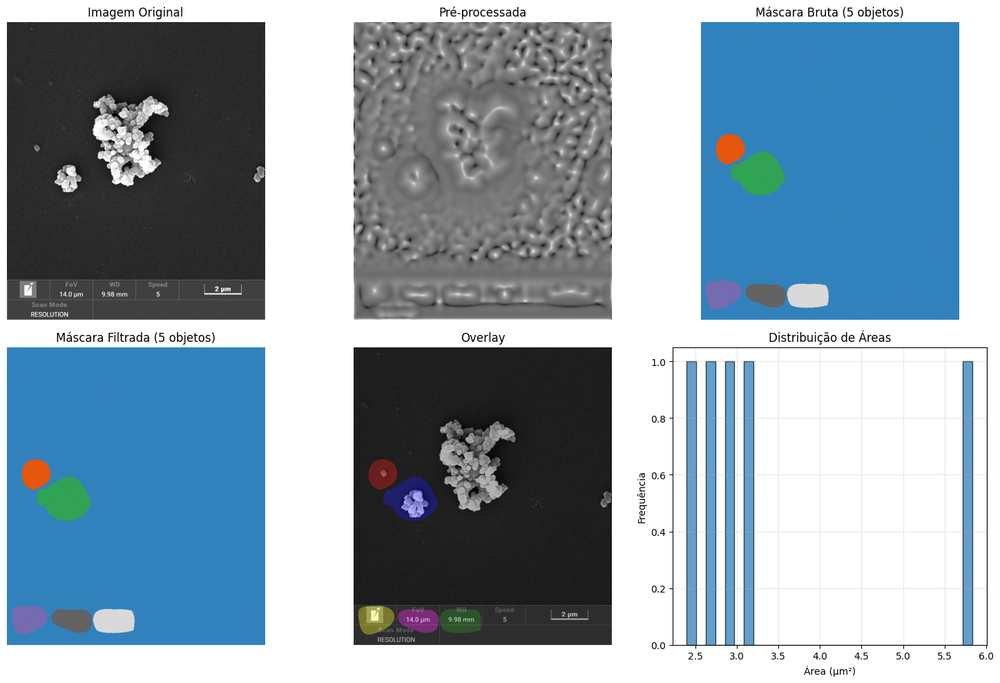


💾 Salvando resultados...
✅ Resultados salvos com prefixo: 'mev_analysis_'

📋 RESUMO FINAL:
   Objetos detectados: 5
   Área média: 3.393 µm²
   Diâmetro médio: 2.049 µm
   Circularidade média: 0.819
   Regime identificado: polydisperse


In [5]:
# =========================================================
# 🔷 PIPELINE CELLPOSE AUTOMÁTICO PARA IMAGENS MEV/SEM
# 🔷 COM ROUTER MORFOLÓGICO AVANÇADO (VERSÃO CORRIGIDA)
# =========================================================

# --------- IMPORTS ----------
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from cellpose import models, plot
from skimage import exposure, filters, morphology, measure, segmentation, color
from skimage.morphology import disk, ball, remove_small_objects, remove_small_holes
from skimage.filters.rank import entropy
from skimage.util import img_as_ubyte
from skimage.measure import label, regionprops, regionprops_table, find_contours
from scipy import ndimage
from scipy.ndimage import gaussian_gradient_magnitude
import warnings
warnings.filterwarnings('ignore')

# =========================================================
# 🔹 FUNÇÕES AUXILIARES CORRIGIDAS
# =========================================================
def normalize_image_safe(img):
    """Normaliza imagem para [0, 1] de forma segura"""
    img = img.astype(np.float32)
    img_min = img.min()
    img_max = img.max()
    
    if img_max - img_min < 1e-8:
        return np.zeros_like(img)
    
    img_norm = (img - img_min) / (img_max - img_min + 1e-8)
    return np.clip(img_norm, 0, 1)

def safe_entropy_calculation(img, disk_size):
    """Calcula entropia de forma segura"""
    # Garantir que a imagem está em [0, 1]
    img_clipped = np.clip(img, 0, 1)
    
    # Converter para uint8 se necessário
    if img_clipped.max() <= 1.0:
        img_uint8 = (img_clipped * 255).astype(np.uint8)
    else:
        img_uint8 = np.clip(img_clipped, 0, 255).astype(np.uint8)
    
    return entropy(img_uint8, disk(disk_size))

# =========================================================
# 🔹 PRÉ-PROCESSAMENTO CORRIGIDO
# =========================================================
def preprocess_for_mev_nuclei(img, regime, microns_per_pixel):
    """Pré-processamento específico para imagens MEV/SEM"""
    img = normalize_image_safe(img)
    img_processed = img.copy()
    
    if regime == "dense_polydisperse_overlap":
        img_uint8 = (img_processed * 255).astype(np.uint8)
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
        img_processed = clahe.apply(img_uint8).astype(float) / 255
        
        sigma1 = max(0.5, 0.5 / microns_per_pixel)
        sigma2 = max(1.0, 2.0 / microns_per_pixel)
        g1 = filters.gaussian(img_processed, sigma=sigma1)
        g2 = filters.gaussian(img_processed, sigma=sigma2)
        img_processed = g1 - g2
        img_processed = normalize_image_safe(img_processed)
        
        footprint_size = max(3, int(0.2 / microns_per_pixel))
        footprint = disk(footprint_size)
        local_max = ndimage.maximum_filter(img_processed, footprint=footprint)
        local_min = ndimage.minimum_filter(img_processed, footprint=footprint)
        img_processed = (local_max - local_min) * 2.0
        
    elif regime == "dense":
        sigma_space = max(1.0, 5.0 / microns_per_pixel)
        sigma_color = 0.1
        
        img_uint8 = (img_processed * 255).astype(np.uint8)
        img_processed = cv2.bilateralFilter(
            img_uint8,
            d=-1,
            sigmaColor=sigma_color*255,
            sigmaSpace=sigma_space
        ).astype(float) / 255
        
        radius = max(3, int(0.5 / microns_per_pixel))
        background = ndimage.minimum_filter(img_processed, size=radius*2)
        img_processed = img_processed - background + 0.1
        
        kernel_size = max(3, int(1.0 / microns_per_pixel))
        img_processed = exposure.equalize_adapthist(
            img_processed,
            kernel_size=kernel_size,
            clip_limit=0.01
        )
        
    elif regime == "polydisperse":
        scales_px = [0.2, 0.5, 1.0, 2.0]
        scales = []
        for scale_um in scales_px:
            sigma = max(0.5, scale_um / microns_per_pixel)
            filtered = filters.gaussian(img_processed, sigma=sigma)
            scales.append(filtered)
        
        combined = np.zeros_like(img_processed)
        for i, scale_img in enumerate(scales):
            weight = 1.0 / (scales_px[i] + 0.1)
            combined += weight * scale_img
        
        if combined.max() > 0:
            img_processed = combined / combined.max()
        
        filter_size = max(3, int(0.3 / microns_per_pixel))
        local_mean = ndimage.uniform_filter(img_processed, size=filter_size)
        local_std = ndimage.generic_filter(img_processed, np.std, size=filter_size)
        
        with np.errstate(divide='ignore', invalid='ignore'):
            img_processed = np.where(
                local_std > 1e-8,
                (img_processed - local_mean) / local_std,
                img_processed
            )
        
        img_processed = 1 / (1 + np.exp(-np.clip(img_processed, -10, 10)))
        
    else:  # isolated
        p1, p99 = np.percentile(img_processed, (1, 99))
        img_processed = exposure.rescale_intensity(
            img_processed,
            in_range=(p1, p99),
            out_range=(0, 1)
        )
        
        laplacian = cv2.Laplacian((img_processed*255).astype(np.uint8), cv2.CV_64F)
        laplacian = np.abs(laplacian) / 255.0
        img_processed = img_processed * 0.7 + laplacian * 0.3
        img_processed = img_processed ** 0.5
    
    img_processed = normalize_image_safe(img_processed)
    
    if np.mean(img_processed) > 0.6:
        img_processed = 1 - img_processed
    
    return np.clip(img_processed, 0, 1)

def preprocess_for_mev_advanced(img, router_info, microns_per_pixel):
    """Pré-processamento para novos regimes de MEV/SEM"""
    img = normalize_image_safe(img)
    regime = router_info["regime"]
    
    if regime == "background_molecules_only":
        radius = max(3, int(0.1 / microns_per_pixel))
        footprint = disk(radius)
        img_processed = morphology.white_tophat(img, footprint)
        
        img_uint8 = (img_processed * 255).astype(np.uint8)
        clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(16, 16))
        img_processed = clahe.apply(img_uint8).astype(float) / 255
        
        filter_size = max(3, int(0.05 / microns_per_pixel))
        local_std = ndimage.generic_filter(img_processed, np.std, size=filter_size)
        img_processed = img_processed * (1 + np.clip(local_std * 2, 0, 5))
        
    elif regime == "background_molecules_with_large":
        sigma_small = max(0.5, 0.05 / microns_per_pixel)
        sigma_large = max(1.0, 0.5 / microns_per_pixel)
        
        large_comp = filters.gaussian(img, sigma=sigma_large)
        small_comp = img - large_comp
        
        large_processed = filters.sobel(large_comp)
        
        small_uint8 = np.clip(small_comp * 255, 0, 255).astype(np.uint8)
        clahe = cv2.createCLAHE(clipLimit=4.0, tileGridSize=(32, 32))
        small_processed = clahe.apply(small_uint8).astype(float) / 255
        
        img_processed = large_processed * 0.3 + small_processed * 0.7
        
    elif regime == "background_molecules_with_large_diff":
        try:
            thresholds = filters.threshold_multiotsu(img, classes=3)
            regions = np.digitize(img, bins=thresholds)
            
            processed_regions = []
            for i in range(3):
                mask = (regions == i).astype(float)
                region_img = img * mask
                
                if i == 0:
                    processed = filters.unsharp_mask(region_img, radius=1, amount=2)
                elif i == 1:
                    processed = filters.sato(region_img, sigmas=range(1, 4))
                else:
                    processed = filters.meijering(region_img)
                
                processed_regions.append(processed)
            
            img_processed = (processed_regions[0] * 0.4 + 
                            processed_regions[1] * 0.4 + 
                            processed_regions[2] * 0.2)
        except:
            img_processed = img
            
    elif regime == "large_objects_diff_morphology":
        sigmas = [0.1, 0.3, 0.7, 1.2]
        responses = []
        
        for sigma in sigmas:
            sigma_px = max(0.5, sigma / microns_per_pixel)
            blurred = filters.gaussian(img, sigma=sigma_px)
            grad = filters.sobel(blurred)
            hessian = np.abs(filters.hessian(blurred))
            response = np.abs(grad) + hessian
            responses.append(response)
        
        img_processed = np.zeros_like(img)
        for i in range(img.shape[0]):
            for j in range(img.shape[1]):
                responses_at_pixel = [r[i,j] for r in responses]
                if responses_at_pixel:
                    img_processed[i,j] = max(responses_at_pixel)
        
        try:
            # Usar nossa função segura de entropia
            local_entropy = safe_entropy_calculation(img_processed, 7)
            img_processed = img_processed * (1 + local_entropy)
        except:
            pass
        
    elif regime == "large_objects_similar":
        sigma = max(0.5, 0.3 / microns_per_pixel)
        img_processed = filters.gaussian(img, sigma=sigma)
        edges = filters.farid(img_processed)
        img_processed = img_processed + edges * 0.5
        
        filter_size = max(3, int(0.5 / microns_per_pixel))
        local_mean = ndimage.uniform_filter(img_processed, size=filter_size)
        
        with np.errstate(divide='ignore', invalid='ignore'):
            std_val = np.std(img_processed)
            if std_val > 1e-8:
                img_processed = (img_processed - local_mean) / std_val
            else:
                img_processed = img_processed - local_mean
                
    elif regime == "very_sparse":
        p0_1, p99_9 = np.percentile(img, (0.1, 99.9))
        img_processed = exposure.rescale_intensity(
            img,
            in_range=(p0_1, p99_9),
            out_range=(0, 1)
        )
        
        median_filtered = ndimage.median_filter(img_processed, size=3)
        diff = np.abs(img_processed - median_filtered)
        img_processed = img_processed * (1 + np.clip(diff * 5, 0, 10))
        
    else:
        return preprocess_for_mev_nuclei(img, regime, microns_per_pixel)
    
    img_processed = normalize_image_safe(img_processed)
    
    if np.mean(img_processed) > 0.6:
        img_processed = 1 - img_processed
    
    return np.clip(img_processed, 0, 1)

# =========================================================
# 🔹 ROUTER MORFOLÓGICO CORRIGIDO
# =========================================================
def sr_morphophase_router_mev_complete(img, microns_per_pixel=0.02, verbose=True):
    """Router avançado para imagens MEV/SEM"""
    img_float = normalize_image_safe(img)
    h, w = img_float.shape
    
    # 1️⃣ ANÁLISE DE TEXTURA (com cálculo seguro)
    try:
        entropies = []
        scales_um = [0.05, 0.1, 0.2, 0.5]
        for scale_um in scales_um:
            scale_px = max(3, int(scale_um / microns_per_pixel))
            if scale_px % 2 == 0:
                scale_px += 1
            ent = safe_entropy_calculation(img_float, scale_px)
            entropies.append(np.mean(ent))
        
        mean_entropy = np.mean(entropies)
        texture_variation = np.std(entropies) / (mean_entropy + 1e-8)
    except:
        texture_variation = 0.5
        mean_entropy = 0.5
    
    # 2️⃣ ANÁLISE DE ESCALA
    try:
        laplacian_vars = []
        sigmas_um = [0.1, 0.3, 0.7, 1.5]
        for sigma_um in sigmas_um:
            sigma_px = max(0.5, sigma_um / microns_per_pixel)
            laplacian = filters.laplace(filters.gaussian(img_float, sigma=sigma_px))
            laplacian_vars.append(np.var(laplacian))
        
        scale_response_ratio = laplacian_vars[-1] / (laplacian_vars[0] + 1e-8)
    except:
        scale_response_ratio = 1.0
    
    # 3️⃣ DETECÇÃO DE OBJETOS GRANDES
    try:
        large_thresh = filters.threshold_otsu(img_float)
        large_mask = img_float > large_thresh * 1.5
        large_mask = remove_small_holes(large_mask, area_threshold=50)
        large_mask = remove_small_objects(large_mask, min_size=100)
        
        large_labels = label(large_mask)
        large_props = regionprops(large_labels, img_float)
        
        if len(large_props) > 0:
            large_areas = np.array([p.area for p in large_props]) * (microns_per_pixel**2)
            large_eccentricities = np.array([p.eccentricity for p in large_props])
            large_solidities = np.array([p.solidity for p in large_props])
            
            mean_large_area = np.mean(large_areas)
            std_large_ecc = np.std(large_eccentricities)
            mean_large_solidity = np.mean(large_solidities)
            
            large_area_fraction = np.sum(large_areas) / (h * w * microns_per_pixel**2)
            has_large_objects = large_area_fraction > 0.05 and len(large_props) >= 3
        else:
            has_large_objects = False
            mean_large_area = 0
            std_large_ecc = 0
            mean_large_solidity = 0
            large_area_fraction = 0
    except:
        has_large_objects = False
        mean_large_area = 0
        std_large_ecc = 0
        mean_large_solidity = 0
        large_area_fraction = 0
    
    # 4️⃣ ANÁLISE DO RESTANTE
    if has_large_objects:
        try:
            small_mask = img_float <= large_thresh * 1.5
            img_small = img_float.copy()
            img_small[~small_mask] = 0
            
            _, bw_small = cv2.threshold((img_small*255).astype(np.uint8), 0, 255, 
                                        cv2.THRESH_BINARY + cv2.THRESH_OTSU)
            labels_small = label(bw_small > 0)
            props_small = regionprops(labels_small)
            
            if len(props_small) > 5:
                areas_small = np.array([p.area for p in props_small]) * (microns_per_pixel**2)
                mean_small_area = np.mean(areas_small)
            else:
                mean_small_area = 0
        except:
            mean_small_area = 0
    else:
        mean_small_area = 0
    
    # 5️⃣ ANÁLISE DE DENSIDADE
    try:
        _, bw = cv2.threshold((img_float*255).astype(np.uint8), 0, 255, 
                              cv2.THRESH_BINARY + cv2.THRESH_OTSU)
        bw = morphology.opening(bw > 0, disk(2))
        labels = label(bw)
        props = regionprops(labels)
        
        if len(props) < 5:
            regime = "very_sparse"
            density = 0
            mean_d = 0
            cv_d = 0
        else:
            areas_px = np.array([p.area for p in props if p.area > 12])
            if len(areas_px) > 0:
                areas_um2 = areas_px * (microns_per_pixel**2)
                diam_um = 2 * np.sqrt(areas_um2 / np.pi)
                
                mean_d = np.mean(diam_um)
                std_d = np.std(diam_um)
                cv_d = std_d / (mean_d + 1e-8)
                area_img_um2 = h * w * (microns_per_pixel**2)
                density = len(diam_um) / area_img_um2
            else:
                regime = "very_sparse"
                density = 0
                mean_d = 0
                cv_d = 0
    except:
        regime = "very_sparse"
        density = 0
        mean_d = 0
        cv_d = 0
    
    # 6️⃣ DECISÃO DO REGIME
    has_background_molecules = (texture_variation < 0.3 and 
                                mean_entropy < 0.4 and
                                density > 0.1)
    
    if has_large_objects:
        if mean_small_area > 0:
            area_ratio = mean_large_area / mean_small_area
            large_morph_diff = (std_large_ecc > 0.3 or 
                               mean_large_solidity < 0.85 or
                               area_ratio > 10)
        else:
            large_morph_diff = (std_large_ecc > 0.3 or mean_large_solidity < 0.85)
    else:
        large_morph_diff = False
    
    # Classificação final
    if has_background_molecules and has_large_objects:
        if large_morph_diff:
            regime = "background_molecules_with_large_diff"
        else:
            regime = "background_molecules_with_large"
    elif has_background_molecules:
        regime = "background_molecules_only"
    elif has_large_objects:
        if large_morph_diff:
            regime = "large_objects_diff_morphology"
        else:
            regime = "large_objects_similar"
    elif density > 0.18 and cv_d > 1.2:
        regime = "dense_polydisperse_overlap"
    elif density > 0.15:
        regime = "dense"
    elif cv_d > 0.8:
        regime = "polydisperse"
    elif density < 0.01:
        regime = "very_sparse"
    else:
        regime = "isolated"
    
    # 7️⃣ ESTRATÉGIA
    if "background_molecules" in regime:
        strategy = "two_layer_segmentation"
    elif "large_objects" in regime:
        strategy = "multi_scale_segmentation"
    elif regime == "dense_polydisperse_overlap":
        strategy = "cellpose_as_seed + watershed"
    elif regime == "dense":
        strategy = "cellpose + light_watershed"
    else:
        strategy = "direct_cellpose"
    
    if verbose:
        print(f"📊 Texture variation: {texture_variation:.3f}")
        print(f"📊 Scale response ratio: {scale_response_ratio:.3f}")
        print(f"📊 Has large objects: {has_large_objects}")
        print(f"📊 Background molecules: {has_background_molecules}")
    
    return {
        "regime": regime,
        "strategy": strategy,
        "mean_diameter_um": mean_d,
        "cv_diameter": cv_d,
        "density": density,
        "has_background_molecules": has_background_molecules,
        "has_large_objects": has_large_objects,
        "large_morph_diff": large_morph_diff,
        "texture_variation": texture_variation,
        "scale_response_ratio": scale_response_ratio,
        "mean_large_area_um2": mean_large_area if has_large_objects else 0,
        "mean_small_area_um2": mean_small_area if has_large_objects else mean_d**2 * np.pi/4
    }

# =========================================================
# 🔹 CONFIGURAÇÕES DE MODELO
# =========================================================
def get_model_config_mev(router_info, microns_per_pixel):
    """Configurações específicas para cada regime MEV"""
    regime = router_info["regime"]
    
    config_base = {
        "base_model": "nuclei",
        "augment": True,
        "normalize": True,
        "resample": True,
        "net_avg": False,
        "tile": True,
        "stitch_threshold": 0.2,
        "anisotropy": 1.0,
    }
    
    regime_configs = {
        "background_molecules_only": {
            "flow_threshold": 0.25,
            "cellprob_threshold": -3.0,
            "min_size": max(10, int(0.01 / microns_per_pixel)),
            "diameter": None,
            "tile_overlap": 0.3,
            "tile_bsize": 224,
        },
        "background_molecules_with_large": {
            "flow_threshold": 0.3,
            "cellprob_threshold": -2.5,
            "min_size": max(10, int(0.02 / microns_per_pixel)),
            "diameter": max(10, int(0.1 / microns_per_pixel)),
            "tile_overlap": 0.4,
            "tile_bsize": 448,
        },
        "background_molecules_with_large_diff": {
            "flow_threshold": 0.35,
            "cellprob_threshold": -2.0,
            "min_size": max(10, int(0.03 / microns_per_pixel)),
            "diameter": max(10, int(0.2 / microns_per_pixel)),
            "tile_overlap": 0.5,
            "tile_bsize": 672,
        },
        "large_objects_diff_morphology": {
            "flow_threshold": 0.6,
            "cellprob_threshold": -0.5,
            "min_size": max(10, int(0.2 / microns_per_pixel)),
            "diameter": max(10, int(1.0 / microns_per_pixel)),
            "tile_overlap": 0.2,
            "tile_bsize": 896,
        },
        "large_objects_similar": {
            "flow_threshold": 0.55,
            "cellprob_threshold": -1.0,
            "min_size": max(10, int(0.15 / microns_per_pixel)),
            "diameter": max(10, int(0.8 / microns_per_pixel)),
            "tile_overlap": 0.1,
            "tile_bsize": 672,
        },
        "very_sparse": {
            "flow_threshold": 0.7,
            "cellprob_threshold": 0.0,
            "min_size": max(10, int(0.1 / microns_per_pixel)),
            "diameter": max(10, int(0.5 / microns_per_pixel)),
            "tile": False,
            "tile_overlap": 0,
            "tile_bsize": None,
        },
        "dense_polydisperse_overlap": {
            "flow_threshold": 0.35,
            "cellprob_threshold": -2.5,
            "min_size": max(10, int(0.05 / microns_per_pixel)),
            "diameter": None,
            "tile_overlap": 0.3,
            "tile_bsize": 448,
        },
        "dense": {
            "flow_threshold": 0.45,
            "cellprob_threshold": -1.5,
            "min_size": max(10, int(0.08 / microns_per_pixel)),
            "diameter": None,
            "tile_overlap": 0.2,
            "tile_bsize": 672,
        },
        "polydisperse": {
            "flow_threshold": 0.5,
            "cellprob_threshold": -1.0,
            "min_size": max(10, int(0.03 / microns_per_pixel)),
            "diameter": None,
            "tile_overlap": 0.4,
            "tile_bsize": 448,
        },
        "isolated": {
            "flow_threshold": 0.6,
            "cellprob_threshold": 0.0,
            "min_size": max(10, int(0.1 / microns_per_pixel)),
            "diameter": None,
            "tile": False,
            "tile_overlap": 0,
            "tile_bsize": None,
        },
    }
    
    base_config = regime_configs.get(regime, regime_configs["isolated"])
    config = {**config_base, **base_config}
    
    if router_info.get("texture_variation", 0) < 0.2:
        config["cellprob_threshold"] = max(-4.0, config["cellprob_threshold"] - 0.5)
    
    if router_info.get("scale_response_ratio", 1) > 2.0:
        if config["tile_bsize"]:
            config["tile_bsize"] = min(1024, config["tile_bsize"] * 2)
    
    return config

# =========================================================
# 🔹 PIPELINE PRINCIPAL CORRIGIDO
# =========================================================
def cellpose_pipeline_mev_complete(image_path, microns_per_pixel=0.02, output_prefix="mev_complete"):
    """Pipeline completo para segmentação de imagens MEV/SEM"""
    print("=" * 60)
    print("🔬 PIPELINE CELLPOSE PARA MEV/SEM (VERSÃO CORRIGIDA)")
    print("=" * 60)
    
    # 1. CARREGAR IMAGEM
    print("\n📁 Carregando imagem...")
    img = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
    if img is None:
        raise FileNotFoundError(f"Imagem não encontrada: {image_path}")
    
    if img.ndim == 3:
        if img.shape[2] in [3, 4]:
            img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        else:
            img = img[:, :, 0]
    
    print(f"📐 Dimensões: {img.shape}")
    print(f"📊 Tipo: {img.dtype}, Min: {img.min():.1f}, Max: {img.max():.1f}")
    
    # 2. PRÉ-NORMALIZAÇÃO SEGURA
    print("\n🔧 Normalizando imagem...")
    img_norm = normalize_image_safe(img)
    
    # Verificar se precisa inverter
    mean_val = np.mean(img_norm)
    if mean_val > 0.5:
        print("🔁 Invertendo imagem (fundo claro)")
        img_norm = 1 - img_norm
    
    # Ajuste de contraste suave
    img_norm = np.clip(img_norm * 1.3, 0, 1)
    
    # 3. ROUTER MORFOLÓGICO
    print("\n🧭 Analisando morfologia da imagem...")
    router_info = sr_morphophase_router_mev_complete(img_norm, microns_per_pixel, verbose=True)
    
    print(f"\n📋 RESUMO DA ANÁLISE:")
    print(f"   Regime: {router_info['regime']}")
    print(f"   Estratégia: {router_info['strategy']}")
    print(f"   Diâmetro médio: {router_info['mean_diameter_um']:.3f} µm")
    print(f"   CV diâmetro: {router_info['cv_diameter']:.3f}")
    print(f"   Densidade: {router_info['density']:.3f} objetos/µm²")
    
    # 4. PRÉ-PROCESSAMENTO ESPECÍFICO
    print("\n🔧 Aplicando pré-processamento específico...")
    
    regimes_advanced = [
        "background_molecules_only", 
        "background_molecules_with_large",
        "background_molecules_with_large_diff",
        "large_objects_diff_morphology",
        "large_objects_similar",
        "very_sparse"
    ]
    
    if router_info['regime'] in regimes_advanced:
        img_preprocessed = preprocess_for_mev_advanced(img_norm, router_info, microns_per_pixel)
    else:
        img_preprocessed = preprocess_for_mev_nuclei(img_norm, router_info['regime'], microns_per_pixel)
    
    # Garantir que está normalizado
    img_preprocessed = normalize_image_safe(img_preprocessed)
    print(f"✅ Pré-processamento concluído. Range: [{img_preprocessed.min():.3f}, {img_preprocessed.max():.3f}]")
    
    # 5. CONFIGURAÇÃO DO MODELO
    model_config = get_model_config_mev(router_info, microns_per_pixel)
    
    print(f"\n⚙️ CONFIGURAÇÃO DO MODELO CELLPOSE:")
    for key, value in model_config.items():
        if value is not None:
            print(f"   {key}: {value}")
    
    # 6. EXECUTAR CELLPOSE
    print("\n🚀 Executando segmentação Cellpose...")
    
    try:
        model = models.CellposeModel(gpu=True, model_type=model_config["base_model"])
        
        masks, flows, styles = model.eval(
            img_preprocessed,
            diameter=model_config["diameter"],
            flow_threshold=model_config["flow_threshold"],
            cellprob_threshold=model_config["cellprob_threshold"],
            min_size=model_config["min_size"],
            normalize=model_config["normalize"],
            augment=model_config["augment"],
            resample=model_config["resample"],
            net_avg=model_config["net_avg"],
            tile=model_config["tile"],
            stitch_threshold=model_config["stitch_threshold"],
            anisotropy=model_config["anisotropy"]
        )
        
        n_objetos = masks.max()
        print(f"✅ Segmentação concluída! Objetos detectados: {n_objetos}")
        
    except Exception as e:
        print(f"⚠️  Erro no Cellpose: {e}")
        print("🔧 Tentando configuração alternativa...")
        
        # Configuração alternativa mais simples
        model = models.CellposeModel(gpu=True, model_type="nuclei")
        masks, flows, styles = model.eval(
            img_preprocessed,
            diameter=30,
            flow_threshold=0.4,
            cellprob_threshold=-1.0,
            min_size=30,
            normalize=True,
            augment=True
        )
        
        n_objetos = masks.max()
        print(f"✅ Segmentação alternativa concluída. Objetos: {n_objetos}")
    
    # 7. ANÁLISE E MEDIÇÕES
    print("\n📊 Extraindo medidas morfológicas...")
    
    try:
        props = regionprops_table(
            masks,
            properties=[
                'label', 'area', 'perimeter', 'major_axis_length', 
                'minor_axis_length', 'centroid', 'orientation', 
                'eccentricity', 'bbox', 'equivalent_diameter_area'
            ]
        )
        
        df = pd.DataFrame(props)
        
        # Adicionar colunas calculadas
        df['area_um2'] = df['area'] * (microns_per_pixel**2)
        df['perimeter_um'] = df['perimeter'] * microns_per_pixel
        df['circularity'] = (4 * np.pi * df['area']) / (df['perimeter']**2 + 1e-8)
        df['aspect_ratio'] = df['major_axis_length'] / (df['minor_axis_length'] + 1e-8)
        df['diameter_pixels'] = df['equivalent_diameter_area']
        df['diameter_um'] = df['diameter_pixels'] * microns_per_pixel
        df['elongation'] = 1 - (df['minor_axis_length'] / df['major_axis_length'])
        df['compactness'] = (df['perimeter']**2) / (4 * np.pi * df['area'] + 1e-8)
        
    except Exception as e:
        print(f"⚠️  Erro na análise: {e}")
        df = pd.DataFrame()
    
    # 8. FILTRAGEM
    print("\n🔍 Aplicando filtros...")
    
    if not df.empty:
        # Filtros ajustáveis
        min_area_um2 = 0.01
        max_area_um2 = 15.0
        min_circularity = 0.15
        max_aspect_ratio = 4.0
        
        df_filtered = df[
            (df['area_um2'] > min_area_um2) &
            (df['area_um2'] < max_area_um2) &
            (df['circularity'] > min_circularity) &
            (df['aspect_ratio'] < max_aspect_ratio) &
            (df['area'] > 5)
        ].copy().reset_index(drop=True)
        
        # Criar máscara filtrada
        filtered_masks = np.zeros_like(masks)
        for idx, row in df_filtered.iterrows():
            lbl = int(row['label'])
            filtered_masks[masks == lbl] = idx + 1
        
        print(f"📈 Objetos após filtragem: {len(df_filtered)}/{n_objetos}")
    else:
        filtered_masks = masks.copy()
        df_filtered = pd.DataFrame()
        print("⚠️  Nenhum dado para filtrar")
    
    # 9. VISUALIZAÇÃO
    print("\n🎨 Gerando visualizações...")
    
    try:
        # Overlay
        overlay_rgb = color.label2rgb(filtered_masks, image=img_norm, 
                                      bg_label=0, alpha=0.3, image_alpha=1)
        
        # Figura
        fig, axes = plt.subplots(2, 3, figsize=(15, 10))
        
        axes[0, 0].imshow(img_norm, cmap='gray')
        axes[0, 0].set_title('Imagem Original')
        axes[0, 0].axis('off')
        
        axes[0, 1].imshow(img_preprocessed, cmap='gray')
        axes[0, 1].set_title('Pré-processada')
        axes[0, 1].axis('off')
        
        axes[0, 2].imshow(masks, cmap='tab20c')
        axes[0, 2].set_title(f'Máscara Bruta ({masks.max()} objetos)')
        axes[0, 2].axis('off')
        
        axes[1, 0].imshow(filtered_masks, cmap='tab20c')
        axes[1, 0].set_title(f'Máscara Filtrada ({filtered_masks.max()} objetos)')
        axes[1, 0].axis('off')
        
        axes[1, 1].imshow(overlay_rgb)
        axes[1, 1].set_title('Overlay')
        axes[1, 1].axis('off')
        
        if not df_filtered.empty:
            axes[1, 2].hist(df_filtered['area_um2'], bins=30, edgecolor='black', alpha=0.7)
            axes[1, 2].set_xlabel('Área (µm²)')
            axes[1, 2].set_ylabel('Frequência')
            axes[1, 2].set_title('Distribuição de Áreas')
            axes[1, 2].grid(True, alpha=0.3)
        else:
            axes[1, 2].text(0.5, 0.5, 'Sem dados\npara histograma', 
                           ha='center', va='center')
            axes[1, 2].axis('off')
        
        plt.tight_layout()
        plt.savefig(f"{output_prefix}_visualization.png", dpi=150, bbox_inches='tight')
        plt.show()
        
    except Exception as e:
        print(f"⚠️  Erro na visualização: {e}")
    
    # 10. SALVAR RESULTADOS
    print("\n💾 Salvando resultados...")
    
    try:
        # Salvar imagens
        if 'overlay_rgb' in locals():
            cv2.imwrite(f"{output_prefix}_overlay.png", 
                       cv2.cvtColor((overlay_rgb*255).astype(np.uint8), cv2.COLOR_RGB2BGR))
        
        cv2.imwrite(f"{output_prefix}_preprocessed.png", 
                   (img_preprocessed * 255).astype(np.uint8))
        
        # Salvar máscaras
        np.save(f"{output_prefix}_masks_filtered.npy", filtered_masks)
        np.save(f"{output_prefix}_masks_raw.npy", masks)
        
        # Salvar dados
        if not df_filtered.empty:
            df_filtered.to_csv(f"{output_prefix}_medidas_detalhadas.csv", index=False)
        
        # Salvar configurações
        config_df = pd.DataFrame([model_config])
        config_df.to_csv(f"{output_prefix}_config.csv", index=False)
        
        # Salvar informações do router
        router_df = pd.DataFrame([router_info])
        router_df.to_csv(f"{output_prefix}_router_info.csv", index=False)
        
        print(f"✅ Resultados salvos com prefixo: '{output_prefix}_'")
        
    except Exception as e:
        print(f"⚠️  Erro ao salvar resultados: {e}")
    
    print("=" * 60)
    
    return {
        'df': df_filtered,
        'filtered_masks': filtered_masks,
        'raw_masks': masks,
        'preprocessed_image': img_preprocessed,
        'router_info': router_info,
        'model_config': model_config
    }

# =========================================================
# 🔹 EXECUÇÃO PRINCIPAL
# =========================================================
def main():
    """Função principal para execução do pipeline"""
    # CONFIGURAÇÕES (ALTERAR CONFORME SUA IMAGEM)
    IMAGE_PATH = "/kaggle/input/mevdataset/23-12-15/amostra 1-6.tif"
    MICRONS_PER_PIXEL = 0.02
    OUTPUT_PREFIX = "mev_analysis"
    
    try:
        results = cellpose_pipeline_mev_complete(
            image_path=IMAGE_PATH,
            microns_per_pixel=MICRONS_PER_PIXEL,
            output_prefix=OUTPUT_PREFIX
        )
        
        # Exibir resumo
        if results['df'] is not None and not results['df'].empty:
            print("\n📋 RESUMO FINAL:")
            print(f"   Objetos detectados: {results['df'].shape[0]}")
            print(f"   Área média: {results['df']['area_um2'].mean():.3f} µm²")
            print(f"   Diâmetro médio: {results['df']['diameter_um'].mean():.3f} µm")
            print(f"   Circularidade média: {results['df']['circularity'].mean():.3f}")
            print(f"   Regime identificado: {results['router_info']['regime']}")
        
        return results
        
    except Exception as e:
        print(f"\n❌ ERRO CRÍTICO: {e}")
        import traceback
        traceback.print_exc()
        return None

# =========================================================
# 🔹 EXECUTAR
# =========================================================
if __name__ == "__main__":
    try:
        from IPython import get_ipython
        if get_ipython() is not None:
            print("📓 Executando em notebook Jupyter...")
            results = main()
    except:
        main()